In [ ]:
import pandas as pd
import numpy as np
from scipy import optimize
import matplotlib.pyplot as plt  
data=pd.read_excel("总人口.xls")
data1=data[['年份','年末总人口(万人)']].values
y=data['年末总人口(万人)'].values.astype(float)
x_0=y[0]
#Logistic
def f2(x,r,K):
    return K/(1+(K/x_0-1)*np.exp(-r*x))
#Malthus
def f(x,r):
    return x_0*np.exp(r*x)
x=np.arange(0,30,1)
x_00=np.arange(1990,2020,1)
plt.figure(figsize=(16,9))
plt.grid()
fita,fitb=optimize.curve_fit(f,x,y)
print(fita)
plt.plot(x_00,10000*y,'.')
x1=f(x,fita[0])
plt.plot(x_00,10000*x1,'r*-')
fita,fitb=optimize.curve_fit(f2,x,y)
print(fita)
x1=f2(x,0.0578,11019)
plt.plot(x_00,10000*x1,'b^-')
plt.legend(["Origin","Malthus","Logistic"])
plt.xlabel("Year")
plt.ylabel("Population")
plt.title('Population Prediction')
plt.show()

e:\IDEA\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:82: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  func(*args, **kwargs)
e:\IDEA\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


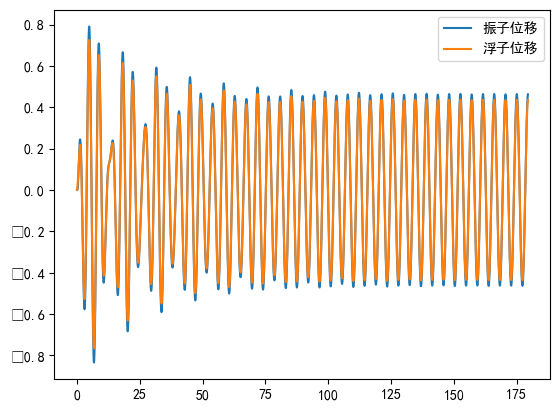

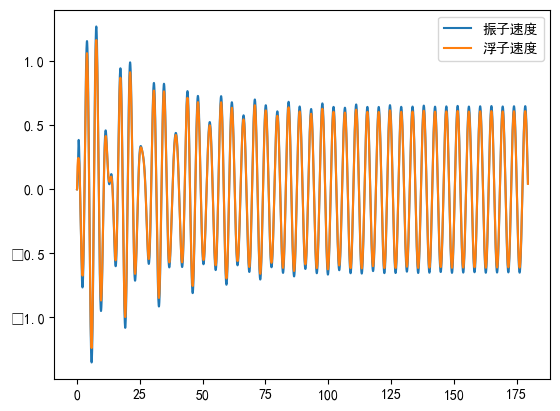

In [1]:
import numpy as np
from matplotlib import rcParams
from math import *
from sympy.abc import t
from scipy.integrate import odeint
import matplotlib.pyplot as plt

def pfun_1(ip,t):
    """第1小问微分方程模型"""
    x,y,z,w=ip
    return np.array([z,
                    w,
                    (-k*(x-y)-beta*(z-w))/m2,
                    (k*(x-y)+beta*(z-w)+f*cos(omega*t)-gama*y-Ita*w)/(m1+m_d)
                    ])
def pfun_2(ip,t):
    """第2小问微分方程模型"""
    x,y,z,w=ip
    return np.array([z,
                    w,
                    (-k*(x-y)-beta*sqrt(abs(z-w))*(z-w))/m2,
                    (k*(x-y)+beta*sqrt(abs(z-w))*(z-w)+f*cos(omega*t)-gama*y-Ita*w)/(m1+m_d)
                    ])
if __name__=='__main__':
    dt=0.01
    m1=4866#浮子质量
    m2=2433#振子质量
    m_d=1335.535#垂荡附加质量 (kg)
    k=80000#弹簧刚度 (N/m)
    beta=10000#平动阻尼系数
    f=6250#垂荡激励力振幅 (N)
    omega=1.4005#入射波浪频率 (s-1)
    T_max=(2*pi/omega)*40#模拟最大时间
    gama=1025*9.8*pi#静水恢复力系数
    Ita=656.3616#垂荡兴波阻尼系数 (N·s/m)
    t_lst=np.arange(0,T_max,dt)
    pfun=pfun_2#选择计算第1小问还是第2小问
    sol=odeint(pfun,[0.0,0.0,0.0,0.0],t_lst)
    rcParams['font.sans-serif']=['SimHei']
    plt.figure()
    plt.plot(t_lst,sol[:,0],label='振子位移')
    plt.plot(t_lst,sol[:,1],label='浮子位移')
    plt.legend()
    plt.figure()
    plt.plot(t_lst,sol[:,2],label='振子速度')
    plt.plot(t_lst,sol[:,3],label='浮子速度')
    plt.legend()

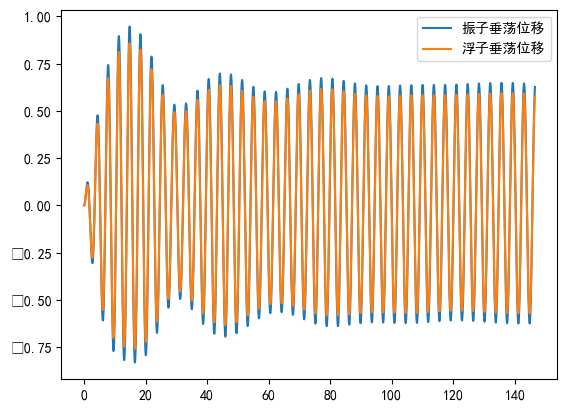

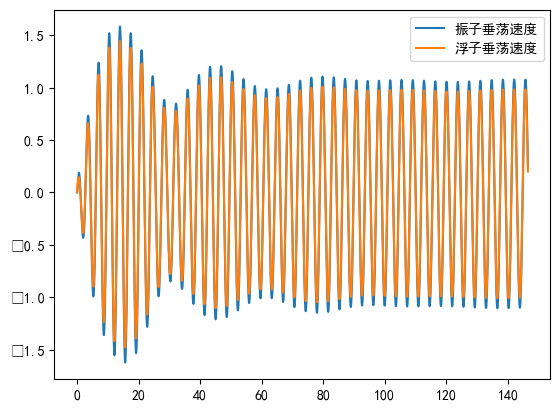

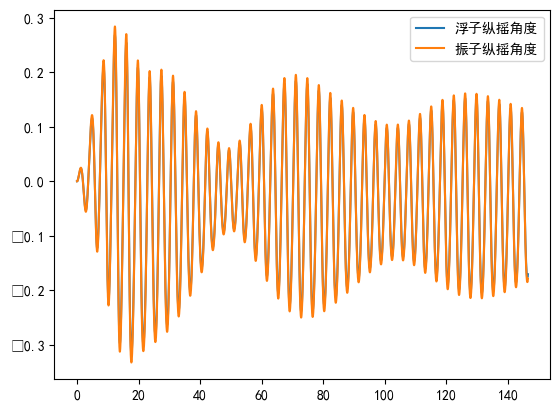

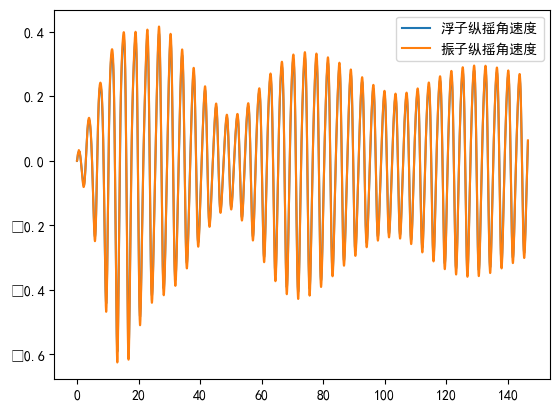

In [2]:
import numpy as np
from matplotlib import rcParams
from math import *
from sympy.abc import t
from scipy.integrate import odeint
import matplotlib.pyplot as plt

def pfun(ip,t):
    """第3问微分方程模型"""
    x,y,z,w,th1,th2,ph1,ph2=ip
    A=np.array([[1,0,0,0,0,0,0,0],
                [0,1,0,0,0,0,0,0],
                [0,0,m_v,m_v*cos(th2),0,0,0,0],
                [0,0,0,m_f+m_d,0,0,0,0],
                [0,0,0,0,1,0,0,0],
                [0,0,0,0,0,1,0,0],
                [0,0,0,0,0,0,J_f+J_d,0],
                [0,0,0,-m_v*(l0+x+0.5*h_v)*sin(th2),0,0,0,J_v+m_v*(l0+x+0.5*h_v)**2]])
    b=np.array([[z],
                [w],
                [m_v*g*(1-cos(th2))+m_v*(l0+x+0.5*h_v)*ph2**2-k1*x-beta_1*z],
                [m_v*g*(1-cos(th2))+(k1*x+beta_1*z)*cos(th2)+f*cos(omega*t)-Ita_1*w-gama_1*y],
                [ph1],
                [ph2],
                [k2*(th2-th1)+beta_2*(ph2-ph1)-Ita_2*ph1-(((2+15*(2-y)**2)/(8+30*(2-y)))*((m_v+m_f)*g-1025*g*pi*y)+gama_2)*th1+L*cos(omega*t)],
                [m_v*g*(l0+x+0.5*h_v)*sin(th2)-2*z*ph2*m_v*(l0+x+0.5*h_v)-k2*(th2-th1)-beta_2*(ph2-ph1)]])
    Op=np.dot(np.linalg.inv(A),b)
    return Op.reshape((-1,))
if __name__=='__main__':
    dt=0.01
    g=9.8
    l0=0.2019575#弹簧初始长度
    m_f=4866#浮子质量
    m_v=2433#振子质量
    m_d=1028.876#垂荡附加质量 (kg)
    J_d=7001.914#纵摇附加转动惯量 (kg·m^2)
    J_v=202.75#振子绕质心转动惯量
    J_f=16137.73119#浮子转动惯量
    k1=80000#弹簧刚度 (N/m)
    k2=250000#扭转弹簧刚度 (N·m)
    beta_1=10000#直线阻尼器阻尼系数
    beta_2=1000#旋转阻尼器阻尼系数
    f=3640#垂荡激励力振幅 (N)
    L=1690#纵摇激励力矩振幅 (N·m)
    omega=1.7152#入射波浪频率 (s-1)
    T_max=(2*pi/omega)*40#模拟最大时间
    gama_1=1025*g*pi#静水恢复力系数
    gama_2=8890.7#静水恢复力矩系数 (N·m)
    Ita_1=683.4558#垂荡兴波阻尼系数 (N·s/m)
    Ita_2=654.3383#纵摇兴波阻尼系数 (N·m·s)
    h_v=0.5#振子高度
    t_lst=np.arange(0,T_max,dt)
    sol=odeint(pfun,[0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0],t_lst)
    
    """将振子相对铰链中心的径向位移、速度转换成垂荡位移、垂荡速度"""
    xx=np.zeros(sol.shape[0])
    vx=np.zeros(sol.shape[0])
    for idx in range(xx.shape[0]):
        xx[idx]=(l0+sol[idx,0])*cos(sol[idx,5])-l0+sol[idx,1]
        vx[idx]=sol[idx,2]*cos(sol[idx,5])+sol[idx,3]
    rcParams['font.sans-serif']=['SimHei']
    plt.figure()
    plt.title('')
    plt.plot(t_lst,xx,label='振子垂荡位移')
    plt.plot(t_lst,sol[:,1],label='浮子垂荡位移')
    plt.legend()
    plt.figure()
    plt.plot(t_lst,vx,label='振子垂荡速度')
    plt.plot(t_lst,sol[:,3],label='浮子垂荡速度')
    plt.legend()
    plt.figure()
    plt.plot(t_lst,sol[:,4],label='浮子纵摇角度')
    plt.plot(t_lst,sol[:,5],label='振子纵摇角度')
    plt.legend()
    plt.figure()
    plt.plot(t_lst,sol[:,6],label='浮子纵摇角速度')
    plt.plot(t_lst,sol[:,7],label='振子纵摇角速度')
    plt.legend()

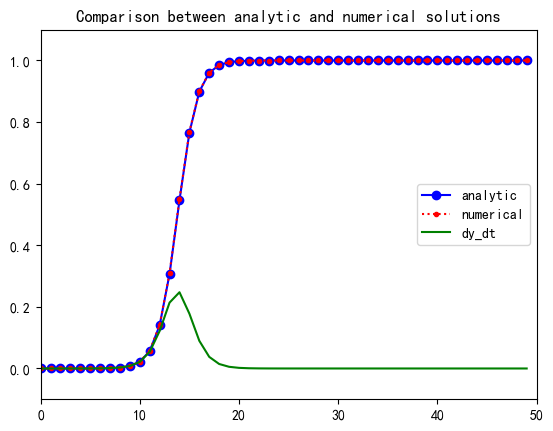

In [4]:
# 设置模型参数
lamda = 1.0  # 日接触率, 患病者每天有效接触的易感者的平均人数
y0 = 1e-6  # 患病者比例的初值
tEnd = 50  # 预测日期长度
t = np.arange(0.0,tEnd,1)  # (start,stop,step)

def dy_dt(y, t):  # 定义导数函数 f(y,t)
    dy_dt = lamda*y*(1-y)  # di/dt = lamda*i*(1-i)
    return dy_dt
yAnaly = 1/(1+(1/y0-1)*np.exp(-lamda*t))  # 微分方程的解析解
yInteg = odeint(dy_dt, y0, t)  # 求解微分方程初值问题
yDeriv = lamda * yInteg *(1-yInteg)
# 绘图
plt.plot(t, yAnaly, '-ob', label='analytic')
plt.plot(t, yInteg, ':.r', label='numerical')
plt.plot(t, yDeriv, '-g', label='dy_dt')
plt.title("Comparison between analytic and numerical solutions")
plt.legend(loc='right')
plt.axis([0, 50, -0.1, 1.1])
plt.show()

lamda=0.2	mu=0.08	sigma=2.5	(1-1/sig)=0.6


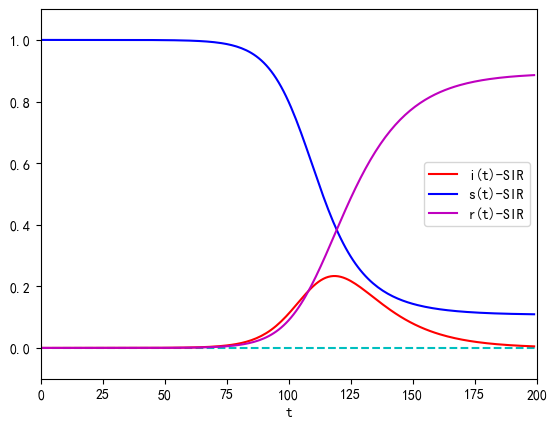

In [5]:
def dySIR(y, t, lamda, mu):  # SIR 模型，导数函数
    i, s = y
    di_dt = lamda*s*i - mu*i  # di/dt = lamda*s*i-mu*i
    ds_dt = -lamda*s*i  # ds/dt = -lamda*s*i
    return [di_dt,ds_dt]

# 设置模型参数
lamda = 0.2  # 日接触率, 患病者每天有效接触的易感者的平均人数
sigma = 2.5  # 传染期接触数
mu = lamda/sigma  # 日治愈率, 每天被治愈的患病者人数占患病者总数的比例
fsig = 1-1/sigma
tEnd = 200  # 预测日期长度
t = np.arange(0.0,tEnd,1)  # (start,stop,step)
i0 = 1e-6  # 患病者比例的初值
s0 = 1-i0  # 易感者比例的初值
Y0 = (i0, s0)  # 微分方程组的初值
print("lamda={}\tmu={}\tsigma={}\t(1-1/sig)={}".format(lamda,mu,sigma,fsig))
ySIR = odeint(dySIR, Y0, t, args=(lamda,mu))  # SIR 模型
# 绘图
#plt.title("Comparison among SI, SIS and SIR models")
plt.xlabel('t')
plt.axis([0, tEnd, -0.1, 1.1])
plt.axhline(y=0,ls="--",c='c')  # 添加水平直线
plt.plot(t, ySIR[:,0], '-r', label='i(t)-SIR')
plt.plot(t, ySIR[:,1], '-b', label='s(t)-SIR')
plt.plot(t, 1-ySIR[:,0]-ySIR[:,1], '-m', label='r(t)-SIR')
plt.legend(loc='best')  # youcans
plt.show()

lamda=0.3	mu=0.06	sigma=5.0	(1-1/sig)=0.8


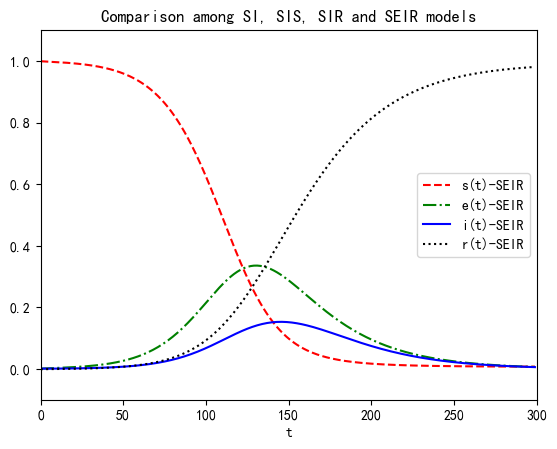

In [6]:
def dySEIR(y, t, lamda, delta, mu):  # SEIR 模型，导数函数
    s, e, i = y  # youcans
    ds_dt = -lamda*s*i  # ds/dt = -lamda*s*i
    de_dt = lamda*s*i - delta*e  # de/dt = lamda*s*i - delta*e
    di_dt = delta*e - mu*i  # di/dt = delta*e - mu*i
    return np.array([ds_dt,de_dt,di_dt])

# 设置模型参数
lamda = 0.3  # 日接触率, 患病者每天有效接触的易感者的平均人数
delta = 0.03  # 日发病率，每天发病成为患病者的潜伏者占潜伏者总数的比例
mu = 0.06  # 日治愈率, 每天治愈的患病者人数占患病者总数的比例
sigma = lamda / mu  # 传染期接触数
fsig = 1-1/sigma
tEnd = 300  # 预测日期长度
t = np.arange(0.0,tEnd,1)  # (start,stop,step)
i0 = 1e-3  # 患病者比例的初值
e0 = 1e-3  # 潜伏者比例的初值
s0 = 1-i0  # 易感者比例的初值
Y0 = (s0, e0, i0)  # 微分方程组的初值
# odeint 数值解，求解微分方程初值问题
ySEIR = odeint(dySEIR, Y0, t, args=(lamda,delta,mu))  # SEIR 模型
# 输出绘图
print("lamda={}\tmu={}\tsigma={}\t(1-1/sig)={}".format(lamda,mu,sigma,fsig))
plt.title("Comparison among SI, SIS, SIR and SEIR models")
plt.xlabel('t')
plt.axis([0, tEnd, -0.1, 1.1])
plt.plot(t, ySEIR[:,0], '--', color='r', label='s(t)-SEIR')
plt.plot(t, ySEIR[:,1], '-.', color='g', label='e(t)-SEIR')
plt.plot(t, ySEIR[:,2], '-', color='b', label='i(t)-SEIR')
plt.plot(t, 1-ySEIR[:,0]-ySEIR[:,1]-ySEIR[:,2], ':', color='k', label='r(t)-SEIR')
plt.legend(loc='right')  # youcans
plt.show()

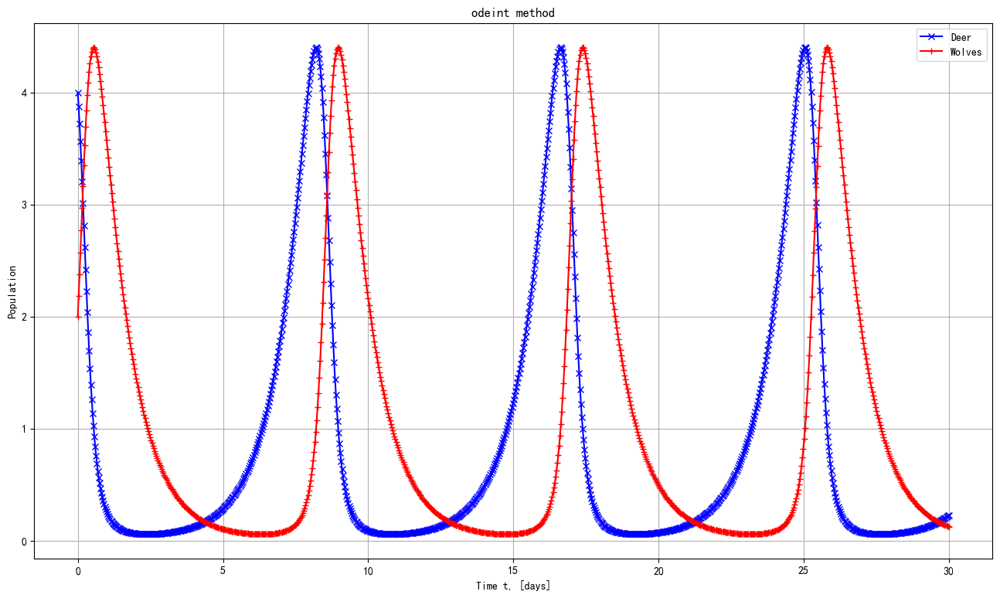

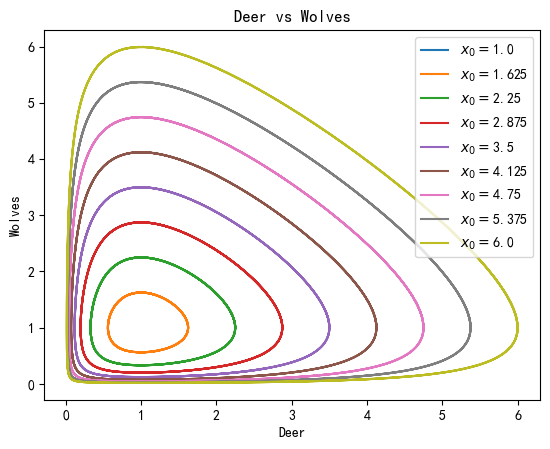

In [8]:
alpha = 1. 
beta = 1.
delta = 1.
gamma = 1.
x_0 = 4.
y0 = 2.

def derivative(X, t, alpha, beta, delta, gamma):
    x, y = X
    dotx = x * (alpha - beta * y)
    doty = y * (-delta + gamma * x)
    return np.array([dotx, doty])
Nt = 1000
tmax = 30.
t = np.linspace(0.,tmax, Nt)
x_0 = [x_0, y0]
res = odeint(derivative, x_0, t, args = (alpha, beta, delta, gamma))
x, y = res.T
plt.figure(figsize=(16,9))
plt.grid()
plt.title("odeint method")
plt.plot(t, x, 'xb-', label = 'Deer')
plt.plot(t, y, '+r-', label = "Wolves")
plt.xlabel('Time t, [days]')
plt.ylabel('Population')
plt.legend()
plt.show()
plt.figure()
IC = np.linspace(1.0, 6.0, 9) # initial conditions for deer population (prey)
# np.linspace和arange不同，从1.0开始，到6.0结束，均分为9段
for deer in IC:
    x_0 = [deer, 1.0]
    Xs = odeint(derivative, x_0, t, args = (alpha, beta, delta, gamma))
    plt.plot(Xs[:,0], Xs[:,1], "-", label = "$x_0 =$"+str(x_0[0]))
plt.xlabel("Deer")
plt.ylabel("Wolves")
plt.legend()
plt.title("Deer vs Wolves")
plt.show()

In [9]:
import pandas as pd
import numpy as np
a=pd.read_excel("data3.xlsx")
p=0.48764
N00=a['总人口(万人)']
N00=np.array(N00)
A=np.eye(90)
b=a['生存率'][0:90]
b1=b/100
for i in range(90):
    A[i,:]*=b1[i]
c=a['调节后生育率'][0:90]
c1=c/1000
M=sum(c1)
d=np.zeros((91,1))
B=np.vstack([c1,A])
L=np.hstack([B,d])
G=[]
K=[]
S1=[]
S2=[]
S3=[]
for i in range(1,13):
    L0=np.power(L,i)
    X=N00@L0
    G.append(X)
    Z=X/p
    K.append(sum(Z))
    S1.append(sum(Z[0:15]))
    S2.append(sum(Z[15:65]))
    S3.append(sum(Z[65:-1]))
K=np.array(K)
S1=np.array(S1)
S2=np.array(S2)
S3=np.array(S3)
x=range(2023,2035)
y1=S1/K
y2=S2/K
y3=S3/K
plt.figure(2)
plt.plot(x,y1,'-or')
plt.plot(x,y2,'-ob')
plt.plot(x,y3,'-og')
plt.title('我国全国各年龄段人口变化趋势')
plt.xlabel('时间(单位：年)')
plt.ylabel('人口数量（单位：万人）')
plt.legend(['年龄在0-14岁总人数','年龄在15-64岁总人数','年龄在65及65岁以上总人数'])
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'data3.xlsx'

In [11]:
## eg.1.
import sys,argparse #argparse是python的一个命令行解析包
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.colors import ListedColormap
yeah =('purple','yellow')
cmap = ListedColormap(yeah)
 
ON = 255
OFF = 0
vals = [ON, OFF]
 
def randomGrid(N):
    """returns a grid of NxN random values"""
    return np.random.choice(vals, N*N, p=[0.2, 0.8]).reshape(N, N) #采用随机的初始状态
 
def addGlider(i, j, grid):
    """adds a glider with top-left cell at (i, j)"""
    glider = np.array([[0, 0, 255],        
                      [255, 0, 255],
                      [0, 255, 255]])   
    # 3×3 的 numpy 数组定义了滑翔机图案（看上去是一种在网格中平稳穿越的图案）。
    grid[i:i+3, j:j+3] = glider       
    #可以看到如何用 numpy 的切片操作，将这种图案数组复制到模拟的二维网格中
    # 它的左上角放在 i和 j指定的坐标，即用这个方法在网格的特定行和列增加一个图案，
 
#实现环形边界条件
def update(frameNum, img, grid, N):
    newGrid = grid.copy()
    for i in range(N):
        for j in range(N):
            total = int((grid[i, (j-1)%N] + grid[i, (j+1)%N] +
                    grid[(i-1)%N, j] + grid[(i+1)%N, j] +
                    grid[(i-1)%N, (j-1)%N] + grid[(i-1)%N, (j+1)%N] +
                    grid[(i+1)%N, (j-1)%N] + grid[(i+1)%N, (j+1)%N])/255)     
           # 因为需要检测网格的 8个边缘。更简洁的方式是用取模（%）运算符
           # 可以用这个运算符让值在边缘折返
        
           # Conway实现规则 :生命游戏的规则基于相邻细胞的 ON 或 OFF 数目
           # 为了简化这些规则的应用，可以计算出处于 ON 状态的相邻细胞总数。
            if grid[i, j] == ON:
                if (total < 2) or (total > 3):
                    newGrid[i, j] = OFF
            else:
                if total == 3:
                    newGrid[i, j] = ON
    
    # update data
    img.set_data(newGrid)
    grid[:] = newGrid[:]
    return img,
 
#向程序发送命令行参数，mian()
def main():
    # command line arguments are in sys.argv[1], sys.argv[2], ...
    # sys.argv[0] is the script name and can be ignored
    # parse arguments
    parser = argparse.ArgumentParser(description="Runs Conway's Game of Life simulation.")
    # add arguments
    parser.add_argument('--grid-size', dest='N', required=False)  #定义了可选参数，指定模拟网格大小N
    parser.add_argument('--mov-file', dest='movfile', required=False)  #指定保存.mov 文件的名称
    parser.add_argument('--interval', dest='interval', required=False)  #设置动画更新间隔的毫秒数
    parser.add_argument('--glider', action='store_true', required=False) #用滑翔机图案开始模拟
    parser.add_argument('--gosper', action='store_true', required=False)
    args = parser.parse_args()
 
    #初始化模拟   
    # set grid size
    N = 100
    if args.N and int(args.N) > 8:
        N = int(args.N)
    
    # set animation update interval
    updateInterval = 50
    if args.interval:
        updateInterval = int(args.interval)
    
    # declare grid
    grid = np.array([])
    # check if "glider" demo flag is specified，设置初始条件，要么是默认的随机图案，要么是滑翔机图案。
    if args.glider:
        grid = np.zeros(N*N).reshape(N, N) #创建 N×N 的零值数组，
        addGlider(1, 1, grid) #调用 addGlider()方法，初始化带有滑翔机图案的网格
    else:
    # populate grid with random on/off - more off than on
        grid = randomGrid(N)
    
    # 设置动画
    fig, ax = plt.subplots(facecolor='pink') #配置 matplotlib 的绘图和动画参数   
    img = ax.imshow(grid,cmap=cmap, interpolation='nearest')  #用plt.show()方法将这个矩阵的值显示为图像，并给 interpolation 选项传入'nearest'值，以得到尖锐的边缘（否则是模糊的）
    ani = animation.FuncAnimation(fig, update, fargs=(img, grid, N, ),#animation.FuncAnimation()调用函数 update()，该函数在前面的程序中定义，根据 Conway 生命游戏的规则，采用环形边界条件来更新网格。
                                  frames=10,
                                  interval=updateInterval,
                                  save_count=50)
    # number of frames?
    # set the output file
    if args.movfile:
        ani.save(args.movfile, fps=30, extra_args=['-vcodec', 'libx264'])
    plt.show()
    
 
# call main
if __name__ == '__main__':
    main()


usage: ipykernel_launcher.py [-h] [--grid-size N] [--mov-file MOVFILE]
                             [--interval INTERVAL] [--glider] [--gosper]
ipykernel_launcher.py: error: unrecognized arguments: --f=c:\Users\21664\AppData\Roaming\jupyter\runtime\kernel-v2-49660ceDj0kmLAKqS.json


SystemExit: 2

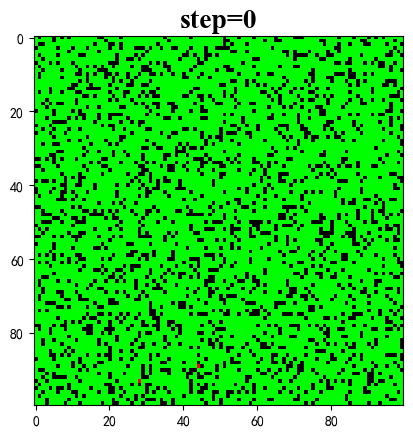

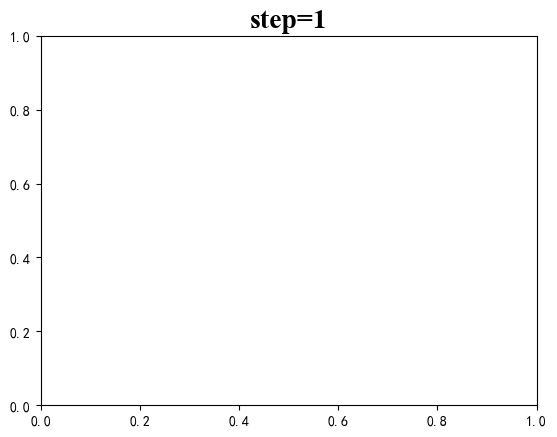

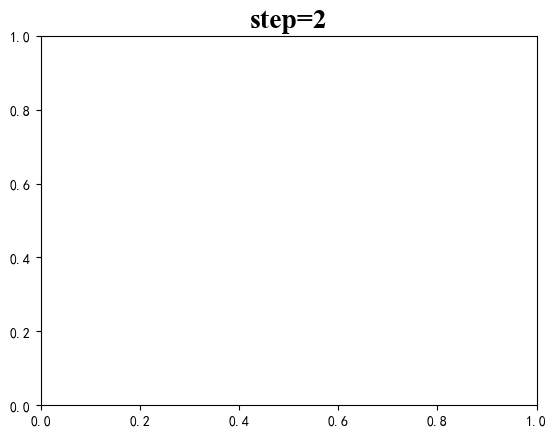

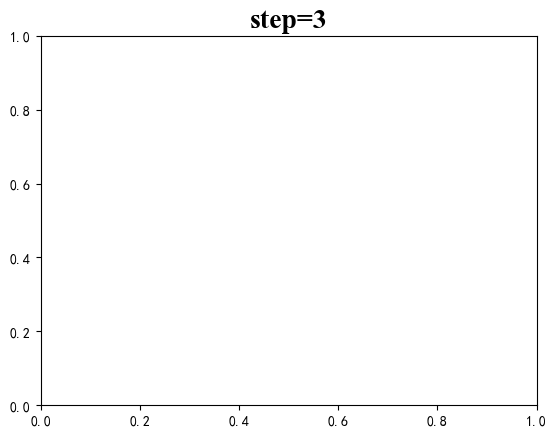

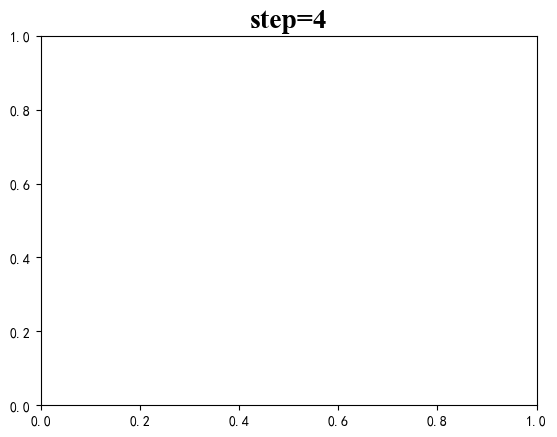

...

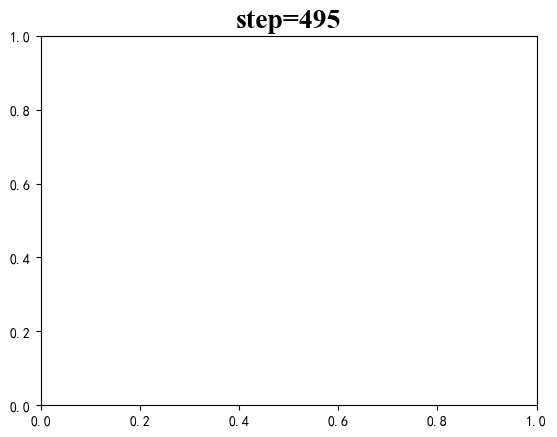

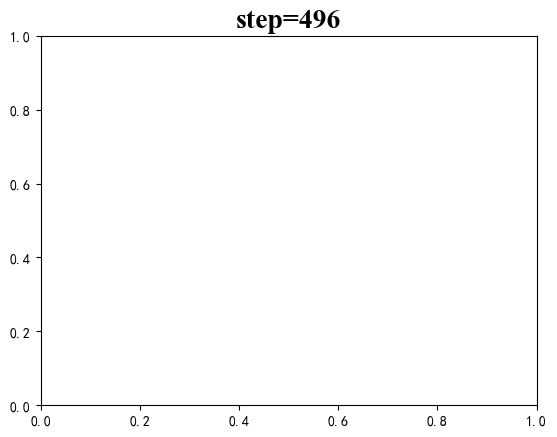

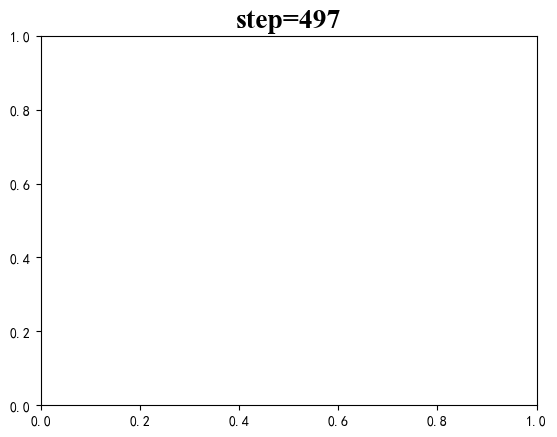

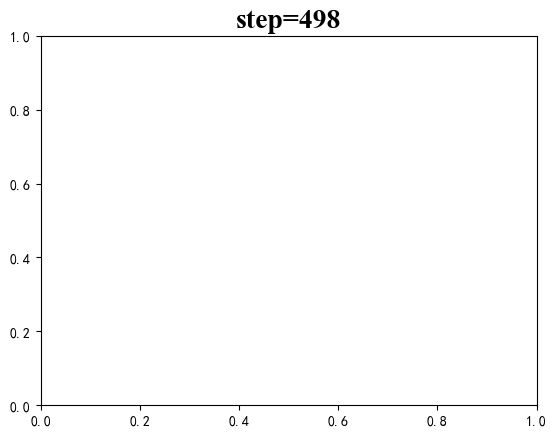

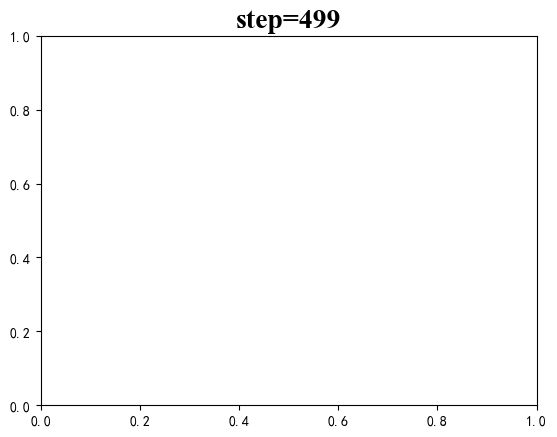

In [12]:
import numpy as np#科学计算库 处理多维数据(矩阵)
import matplotlib.pyplot as plt#绘图工具库
import matplotlib as mpl
#设置基本参数
global Row,Col#定义全局变量行和列
Row=100#行
Col=100#列
forest_area=0.8#初始化这个地方是树木的概率
firing=0.8#绿树受到周围树木引燃的概率
grow=0.001#空地上生长出树木的概率
lightning=0.00006#闪电引燃绿树的概率
forest=(np.random.rand(Row,Col)<forest_area).astype(np.int8)
#初始化作图
plt.title("step=1",fontdict={"family":'Times New Roman',"weight":'bold',"fontsize":20})#字体，加粗，字号
colors=[(0,0,0),(0,1,0),(1,0,0)]#黑色空地 绿色树 红色火
bounds=[0,1,2,3]#类数组，单调递增的边界序列
cmap=mpl.colors.ListedColormap(colors)#从颜色列表生成颜色的映射对象
w=plt.imshow(forest,cmap=cmap,norm=mpl.colors.BoundaryNorm(bounds,cmap.N))

#迭代
T=500#迭代500次
for t in range(T):
    temp=forest#上一个状态的森林
    temp=np.where(forest==2,0,temp)#燃烧的树变成空地
    p0=np.random.rand(Row,Col)#空位变成树木的概率
    temp=np.where((forest==0)*(p0<grow),1,temp)#如果这个地方是空位，满足长成绿树的条件，那就变成绿树
    fire=(forest==2).astype(np.int8)#找到燃烧的树木
    firepad=np.pad(fire,(1,1),'wrap')#上下边界，左右边界相连接
    numfire=firepad[0:-2,1:-1]+firepad[2:,1:-1]+firepad[1:-1,0:-2]+firepad[1:-1,2:]
    p21=np.random.rand(Row,Col)#绿树因为引燃而变成燃烧的树
    p22=np.random.rand(Row,Col)#绿树因为闪电而变成燃烧的树
    #Temp = np.where((forest == 1)&(((numfire>0)&(rule1prob<firing))|((numfire==0)&(rule3prob<lightning))),2,Temp)
    temp=np.where(   (forest==1)&( ( (numfire>0)&(p21<firing)    ) | ((numfire==0)&(p22<lightning)     ) )                           ,2,temp)
    
    forest=temp#更新森林的状态
    plt.title("step="+str(t),fontdict={"family":'Times New Roman',"weight":'bold',"fontsize":20})#字体，加粗，字号
    w.set_data(forest)
    plt.pause(0.1)
plt.show()

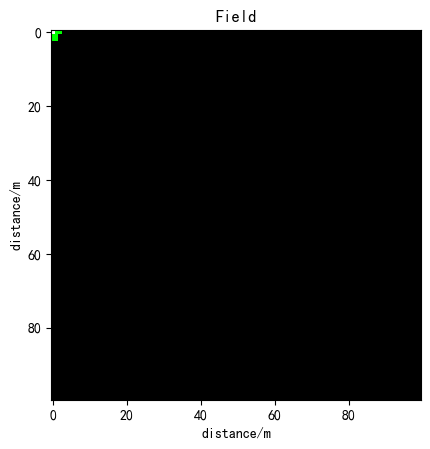

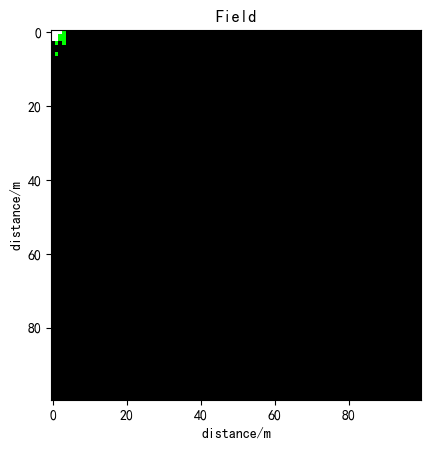

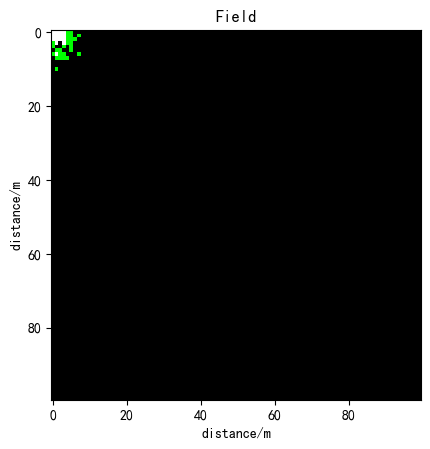

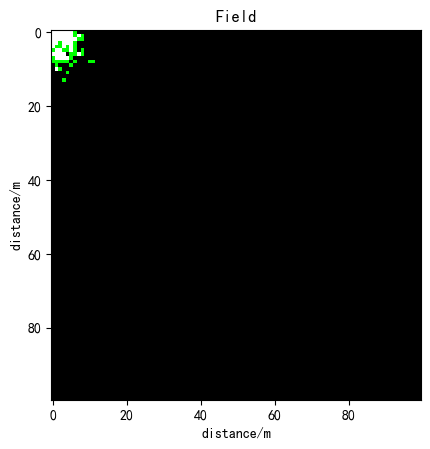

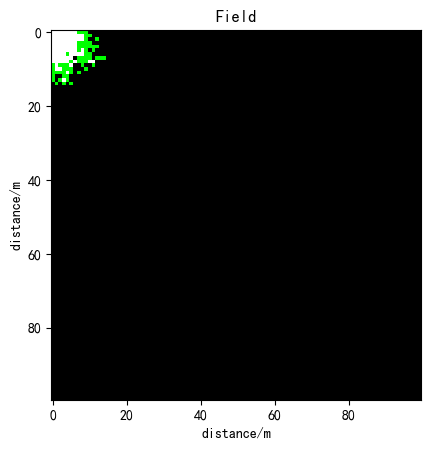

...

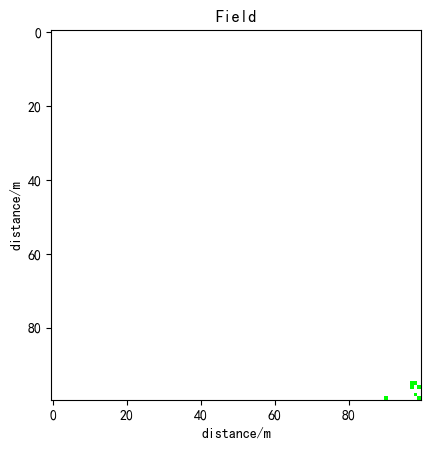

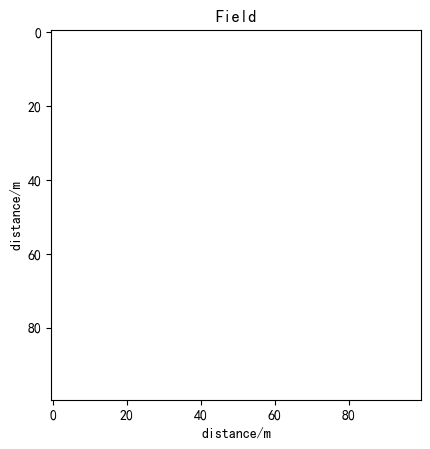

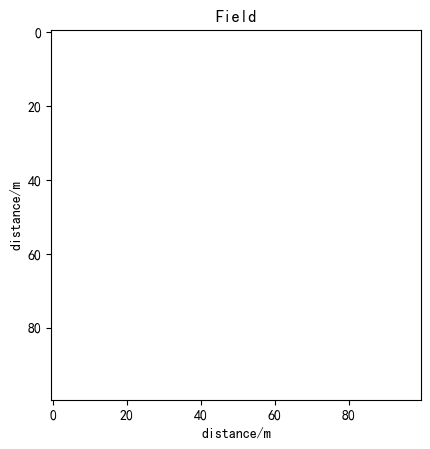

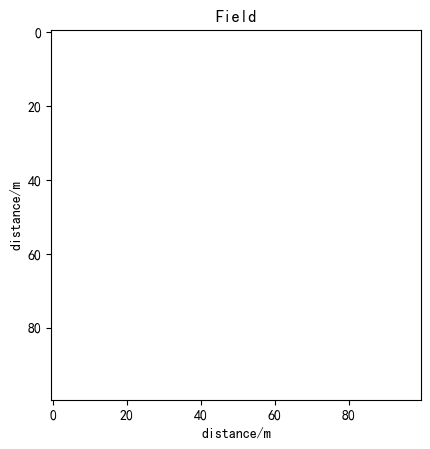

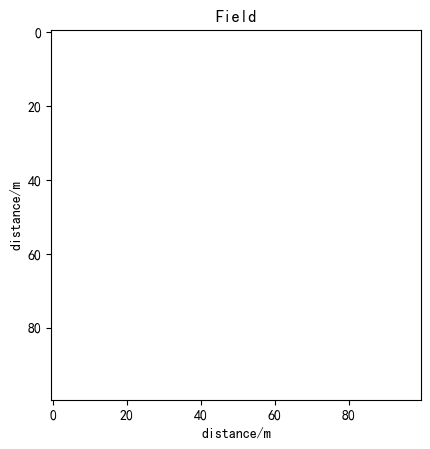

In [14]:
import random
import matplotlib.pyplot as plt
import math
#spread factors
Spread_Calm = math.e
Spread_wind = 0.5
#a variable that describe the fertility of land
Fertility = 10000
#a constant that describe rate of repletion per area
Repletion_Con = 0.006
#a constant that describe the rate of energy use of a dandelion
Consumption_rate_Adult = 1
Consumption_rate_Seed = 0.5
#a variable that describe the population of dandelion
population_adult = 0
population_seed = 0
#a constant describe effect of temperature on germination
Temp_Coefficient = 1.125
#a constant describe effect of temperature on survival
Temp_Survival = 1.01
#a constant describe effect of rainfall on germination
Rain_Coefficient = 1.03
#a constant describe effect of rainfall on survival
Rain_Survival = 1.005
#a constant describe effect of daylight on germination
Daylight_Coefficient = 1
#a constant describe effect of daylight on survival
Daylight_Survival = 0.3
#upper limit of optimum temperature
Thigh = 25
#lower limit of optimum temperature
Tlow = 15
#upper limit of optimum rainfall
Rhigh = 200
#lower limit of optimum rainfall
Rlow = 50
#initialize a variable that describe possibility of germination
K = 0
#initialize a variable that describe possibility of survival
SA = 0
SS = 0
#initialize a variable that describe growth rate
Rate = 0
#a constant that describe the size of a single plant in metre
width = 1
#initialize time of a year in month
time = 1
#number of months want to predict
Period = 48
#time counter
Tcounter = 0
#wind factor of west-east wind in each month
W_west_east = [0,0,0,0,0,0,0,0,0,0,0,0]
#wind factor of south-north wind in each month
W_south_north = [0,0,0,0,0,0,0,0,0,0,0,0]
Rainfall = [200,200,200,200,200,200,200,200,200,200,200,200]
Daylight_Avg = 12
Daylight_Diff = 0
Temperature_Avg = 16
Temperature_Diff = 0
def Temperature(Avg,Diff,T):
    temperature = Avg - Diff*math.cos(2*(math.pi)*(T/12))
    return temperature
def Daylight(Avg,Diff,T):
    daylight = Avg - Diff*math.cos(2*(math.pi)*(T/12))
    return daylight
def Germination(Tem,Rain,Lit):
    k_Tem = 0
    k_Rain = 0
    k_Lit = 0
    if Tem < Tlow:
        k_Tem = (Temp_Coefficient)**(Tem-Tlow)
    elif Tem > Thigh:
        k_Tem = (Temp_Coefficient)**(Thigh-Tem)
    else:
        k_Tem = 1
    if Rain < Rlow:
        k_Rain = (Rain_Coefficient)**(Rain-Rlow)
    elif Rain > Rhigh:
        k_Rain = (Rain_Coefficient)**(Rhigh-Rain)
    else:
        k_Rain = 1
    k_Lit = Lit/(Lit+Daylight_Coefficient)
    k = k_Tem*k_Rain*k_Lit*((Fertility/10000)-Consumption_rate_Seed)
    return k
def Survival(Tem,Rain,Lit,type):
    k_Tem = 0
    k_Rain = 0
    k_Lit = 0
    if Tem < Tlow:
        k_Tem = (Temp_Survival)**(Tem-15)
    elif Tem > Thigh:
        k_Tem = (Temp_Survival)**(25-Tem)
    else:
        k_Tem = 1
    if Rain < Rlow:
        k_Rain = (Rain_Survival)**(Rain-Rlow)
    elif Rain > Rhigh:
        k_Rain = (Rain_Survival)**(Rhigh-Rain)
    else:
        k_Rain = 1
    k_Lit = Lit/(Lit+Daylight_Survival)
    if type == 0:
        s = k_Tem*k_Rain*k_Lit*((Fertility/10000)-Consumption_rate_Adult)
    else:
        s = k_Tem*k_Rain*k_Lit*((Fertility/10000)-Consumption_rate_Seed)
    return s
#initialize the field
#(0,0,0) represent empty land, (0,255,0) represent seed, (255,255,255) represent dandelion
field = [[(0,0,0) for i in range(int(100/width))] for j in range(int(100/width))]
#initialize the field for growth time
growth_table = [[0 for i in range(int(100/width))] for j in range(int(100/width))]
#set the first dandelion
field[0][0] = (255,255,255)
growth_table[0][0] = 1
for Tcounter in range(Period):
    population_adult = 0
    population_seed = 0
    for Column_index in range(int(100/width)):
        for Row_index in range(int(100/width)):
            if field[Column_index][Row_index] == (255,255,255):
                population_adult = population_adult + 1
            if field[Column_index][Row_index] == (0,255,0):
                population_seed = population_seed + 1
    temp = Temperature(Temperature_Avg,Temperature_Diff,time)
    light = Daylight(Daylight_Avg,Daylight_Diff,time)
    rain = Rainfall[time-1]
    Fertility = Fertility + 10000*Repletion_Con*rain
    Fertility = Fertility - population_adult*Consumption_rate_Adult - population_seed*Consumption_rate_Seed
    K = Germination(temp,rain,light)
    SA = Survival(temp,rain,light,0)
    SS = Survival(temp,rain,light,1)
    for Column_index in range(int(100/width)):
        for Row_index in range(int(100/width)):
            if growth_table[Column_index][Row_index] >= 1 and field[Column_index][Row_index] == (0,255,0):
                field[Column_index][Row_index] = (255,255,255)
                growth_table[Column_index][Row_index] = 1
    for Column_index in range(int(100/width)):
        for Row_index in range(int(100/width)):
            if field[Column_index][Row_index] == (0,0,0):
                Spreading = 1
                no_seed = 1
                for inner_column in range(int(100/width)):
                    for inner_row in range(int(100/width)):
                        if field[inner_column][inner_row] == (255,255,255):
                            Distance = ((Column_index-(inner_column+W_south_north[time-1]))**2+(Row_index-(inner_row+W_west_east[time-1]))**2)**(0.5)
                            if W_south_north[time-1] != 0 or W_west_east[time-1] != 0:
                                if Distance == 0:
                                    have_seed = Spread_wind
                                else:
                                    have_seed = Spread_wind/((Distance)**2)
                            else:
                                have_seed = Spread_Calm**(-1*Distance)
                            no_seed = no_seed*(1-have_seed)
                Spreading = 1-no_seed
                Possibility_factor = random.random()
                if Spreading>=Possibility_factor:
                    field[Column_index][Row_index] = (0,255,0)
                    growth_table[Column_index][Row_index] = 0
    for Column_index in range(int(100/width)):
        for Row_index in range(int(100/width)):
            if field[Column_index][Row_index] == (0,255,0):
                growth_table[Column_index][Row_index] = growth_table[Column_index][Row_index] + K
    for Column_index in range(int(100/width)):
        for Row_index in range(int(100/width)):
            if field[Column_index][Row_index] == (0,255,0):
                Possibility_factor = random.random()
                if SS <= Possibility_factor:
                    field[Column_index][Row_index] = (0,0,0)
                    growth_table[Column_index][Row_index] = 0
            elif field[Column_index][Row_index] == (255,255,255):
                Possibility_factor = random.random()
                if SA <= Possibility_factor:
                    field[Column_index][Row_index] = (0,0,0)
                    growth_table[Column_index][Row_index] = 0
    if time <12:
        time = time + 1
    else:
        time = 1
    plt.imshow(field)
    plt.title('Field')
    plt.xlabel('distance/m')
    plt.ylabel('distance/m')
    plt.show()

pygame 2.6.0 (SDL 2.28.4, Python 3.12.4)
Hello from the pygame community. https://www.pygame.org/contribute.html
1


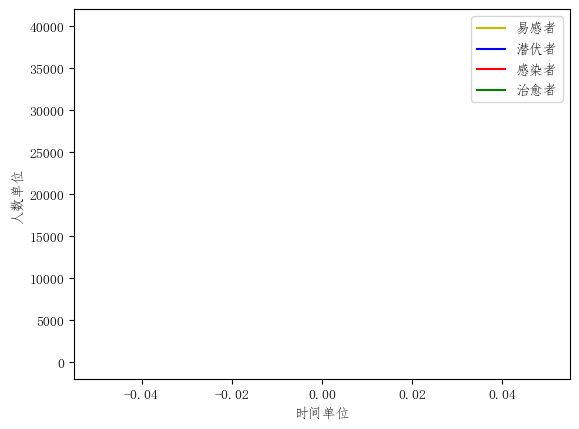

2


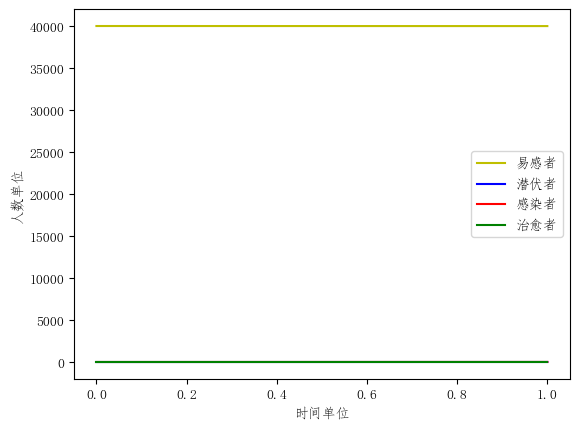

3


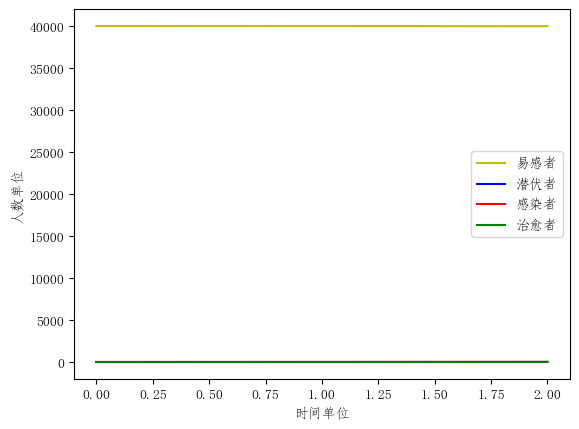

4


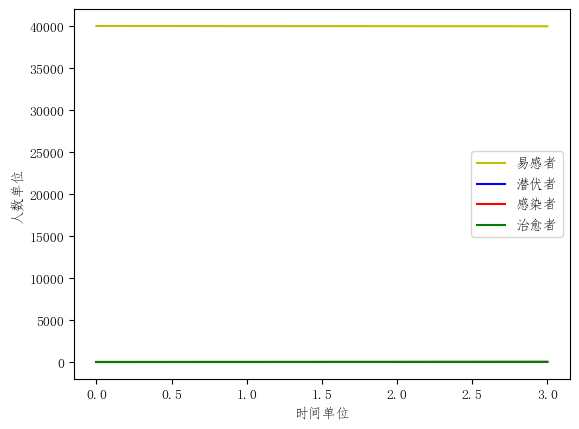

5


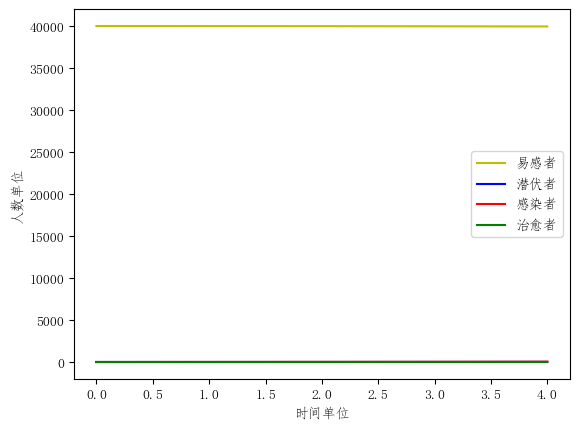

6


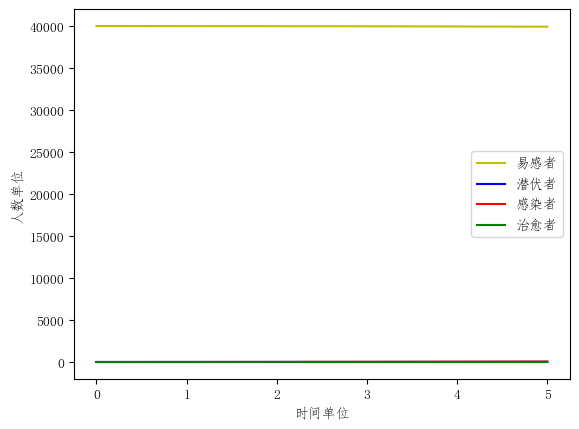

7


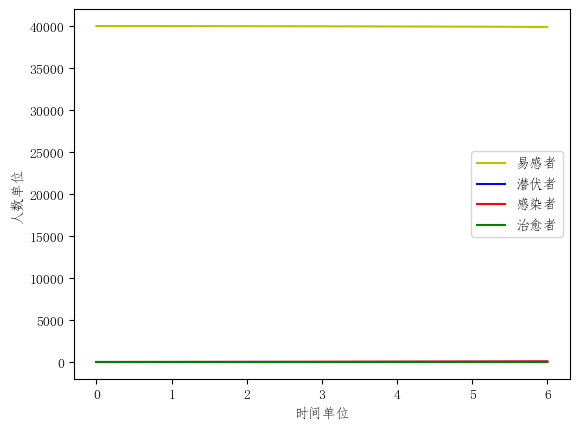

8


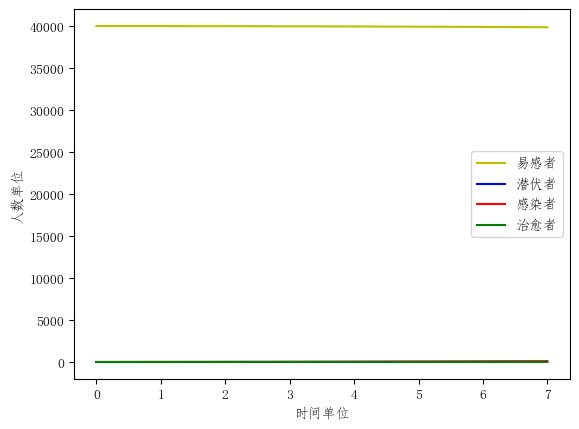

9


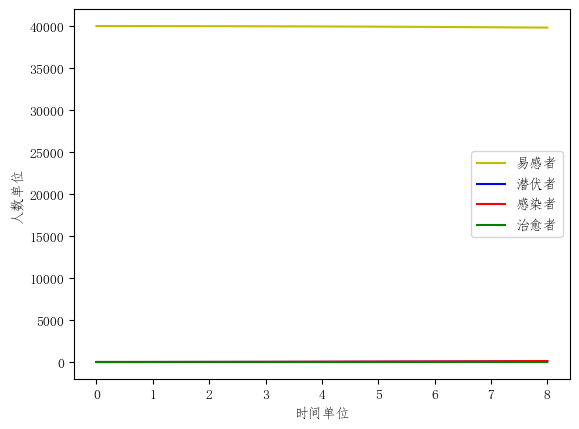

10


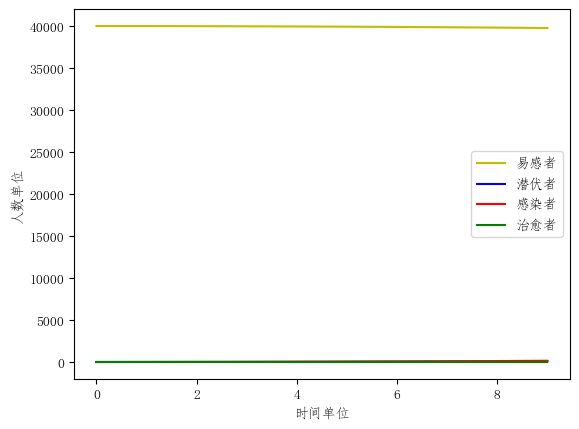

11


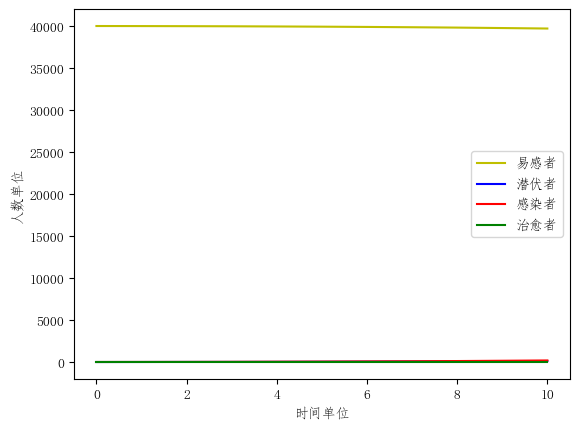

12


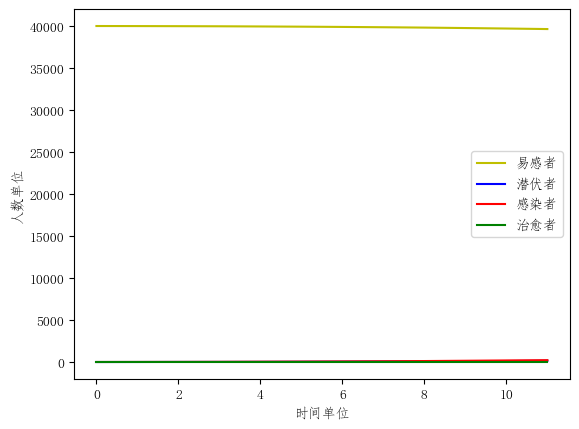

13


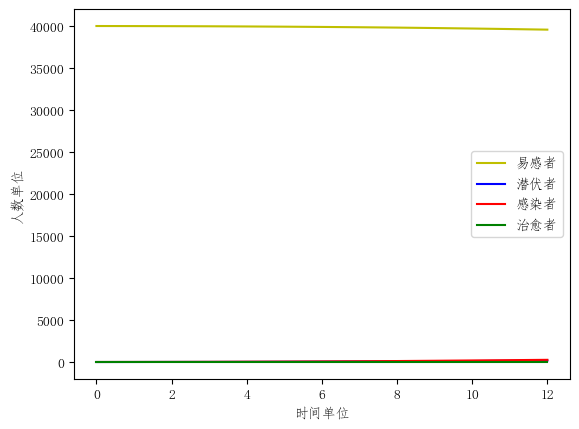

14


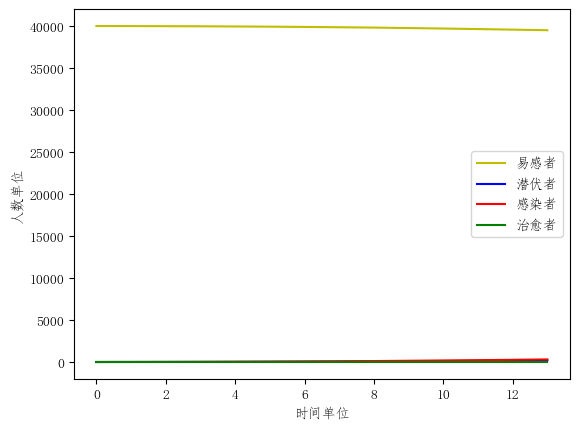

15


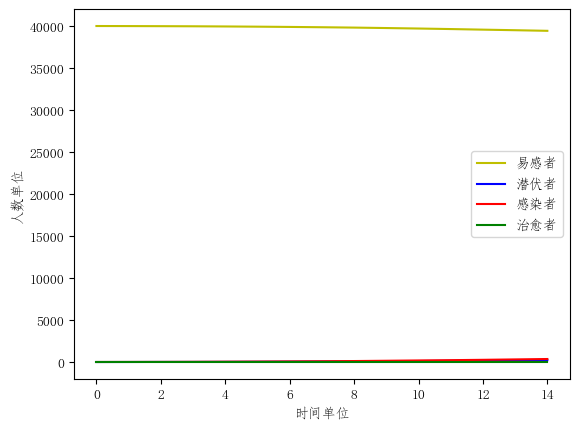

16


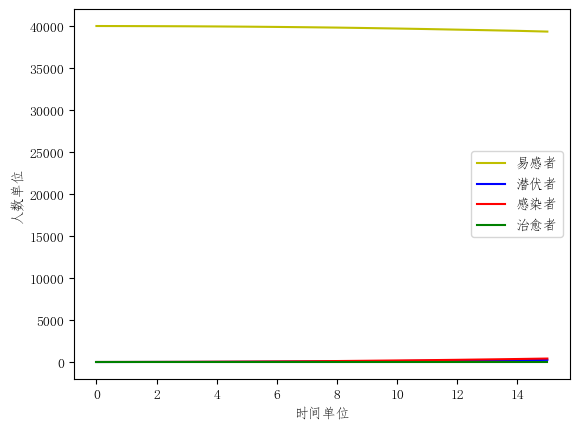

17


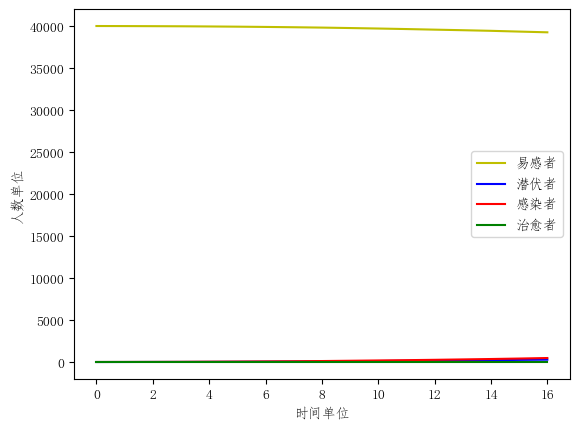

18


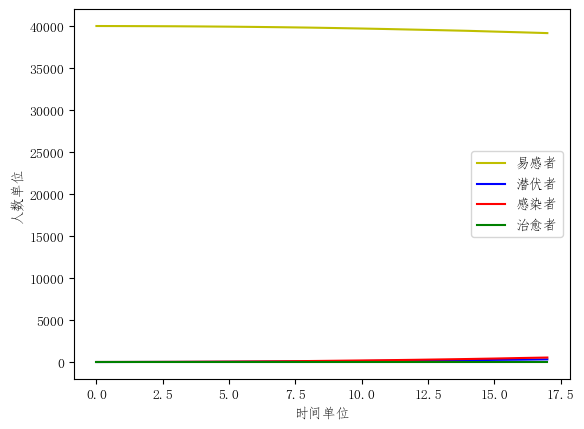

19


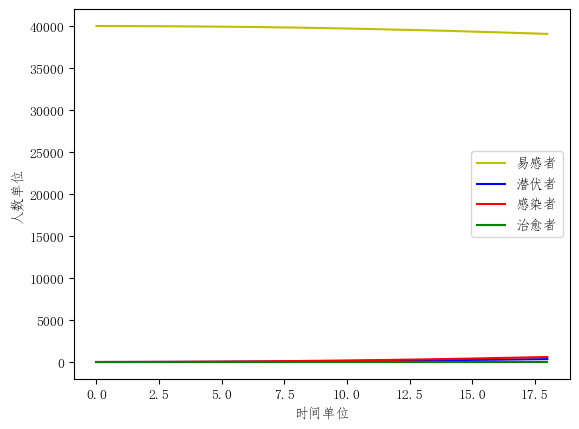

20


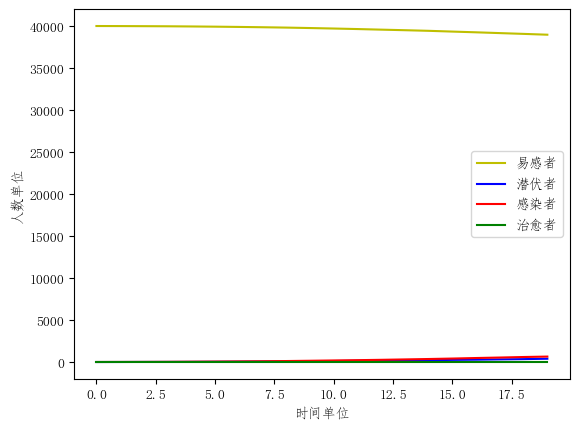

21


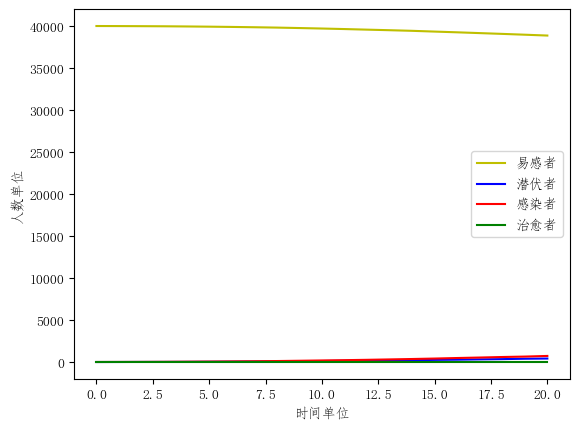

22


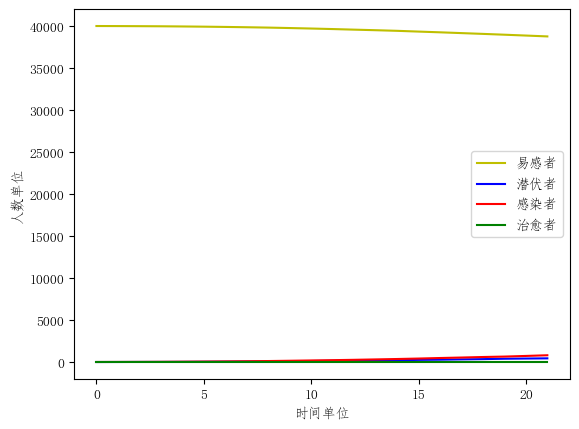

23


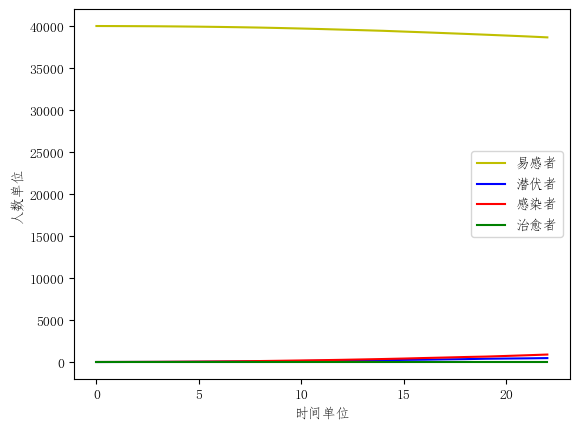

24


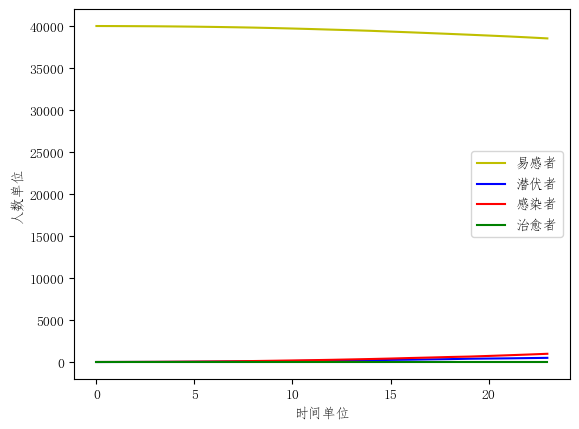

25


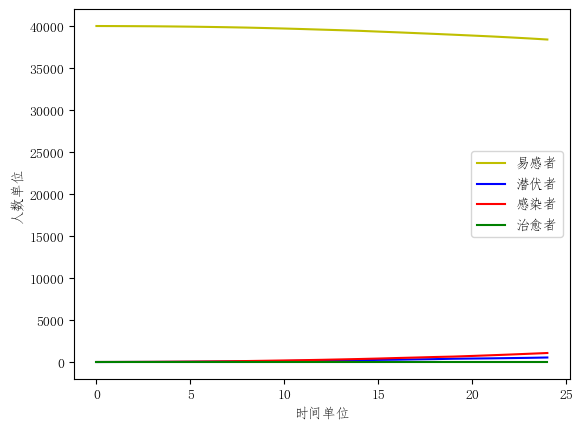

26


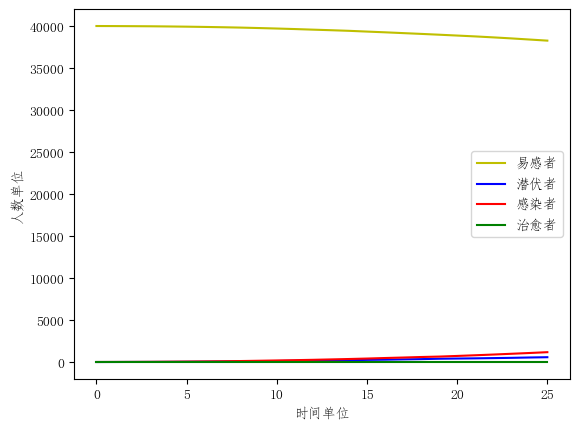

27


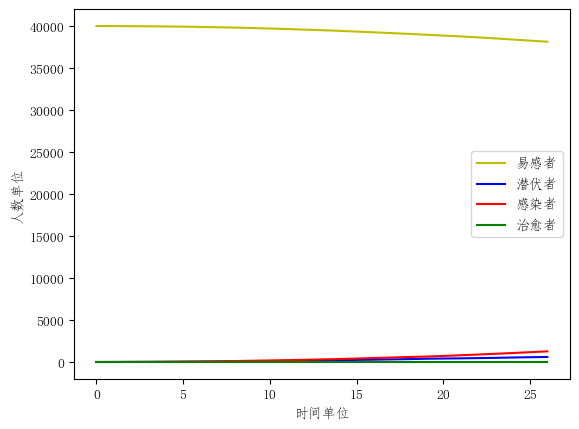

28


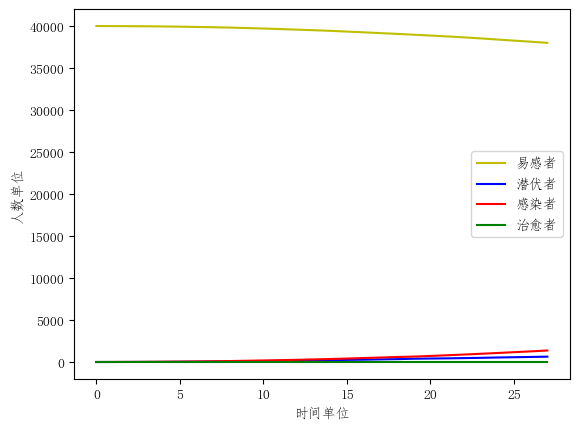

29


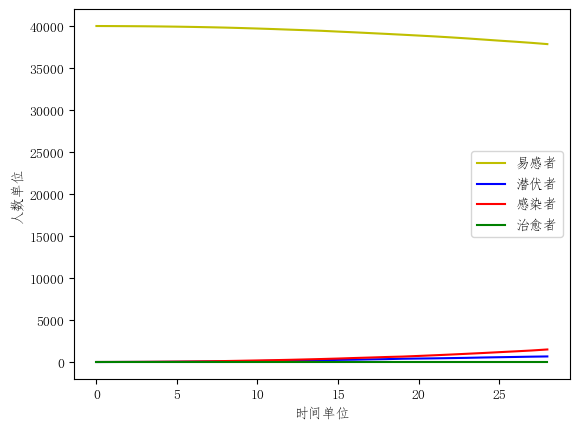

30


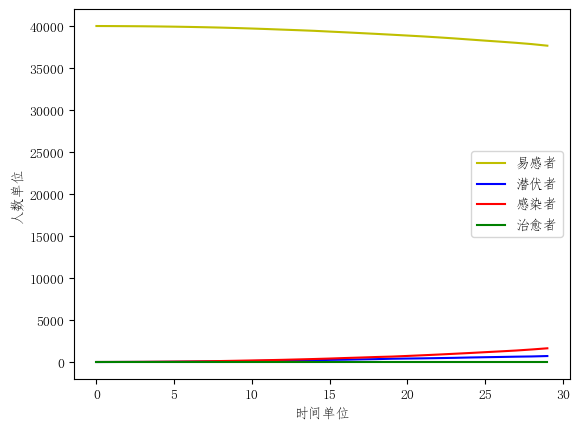

31


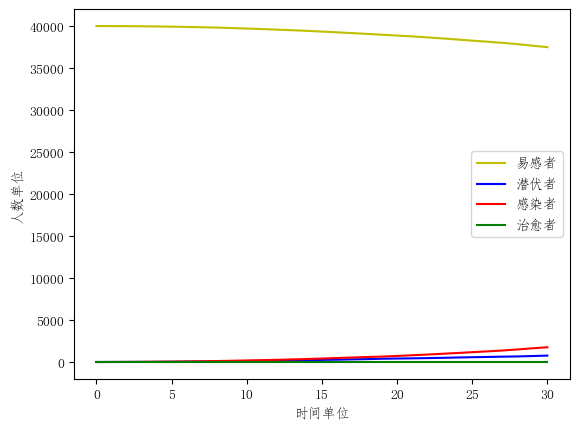

32


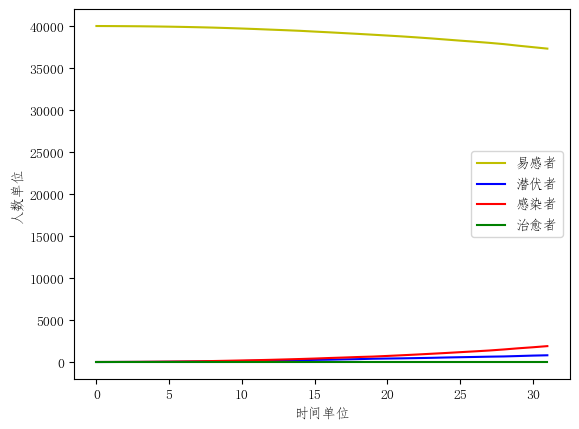

33


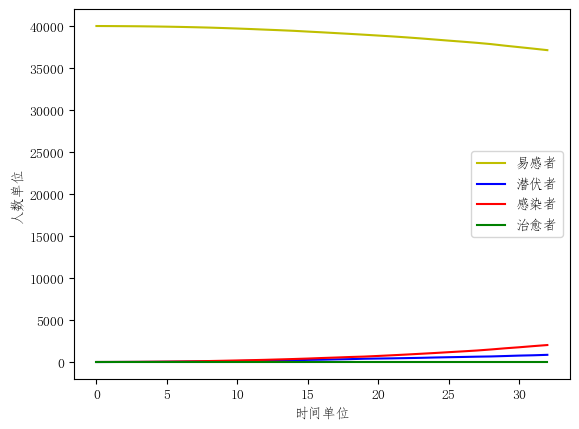

34


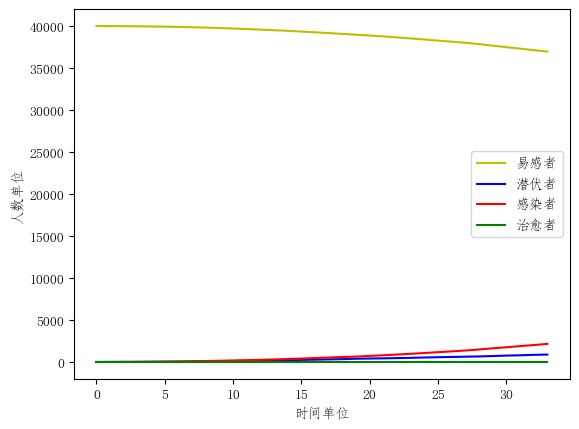

35


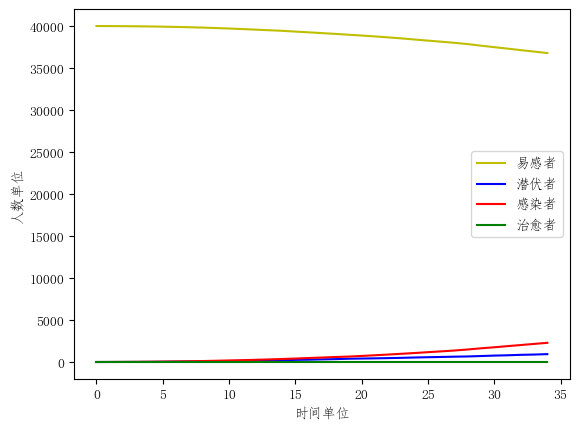

36


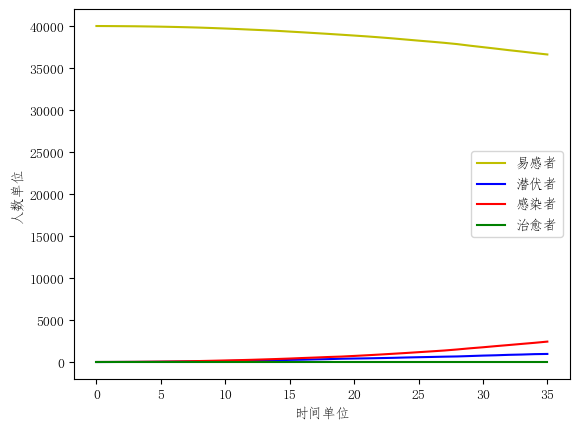

37


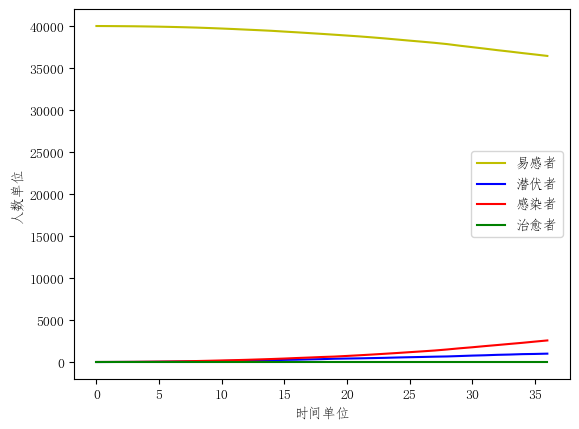

38


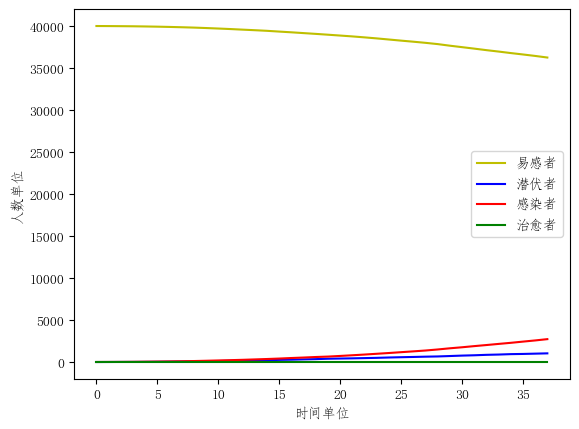

39


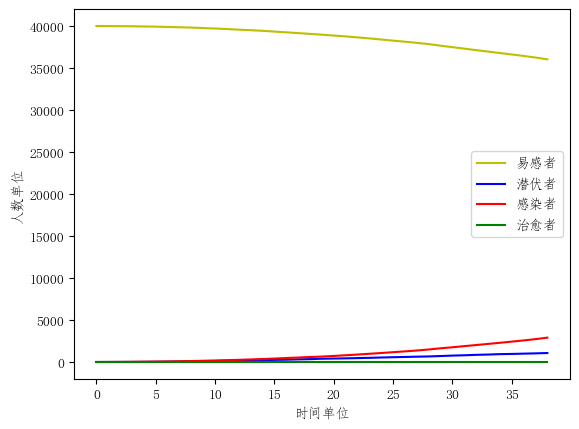

40


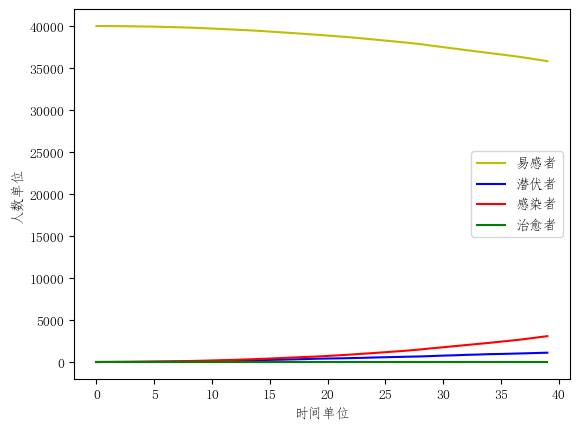

41


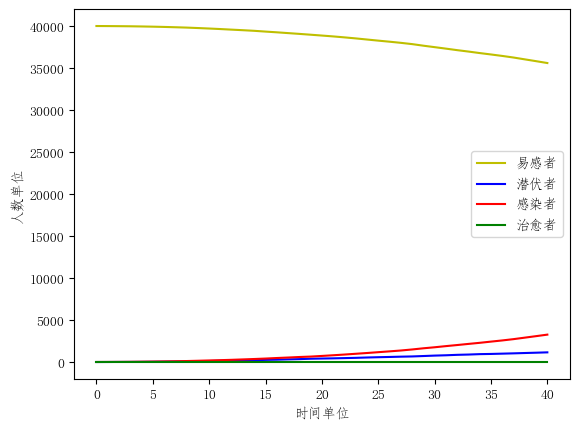

42


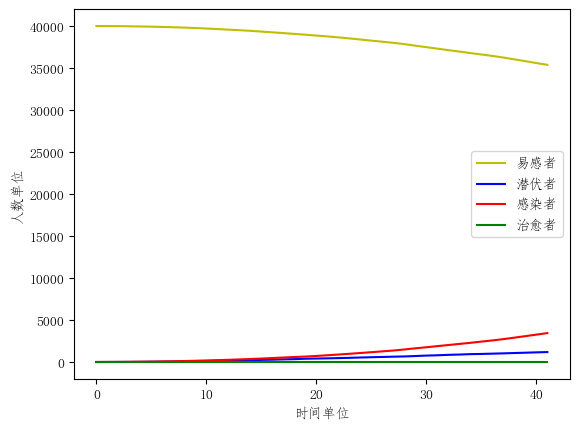

43


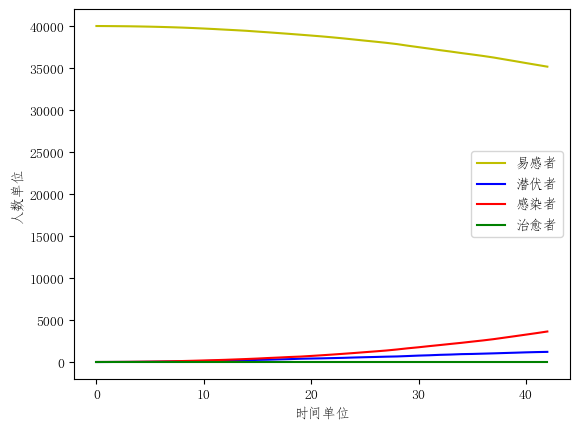

44


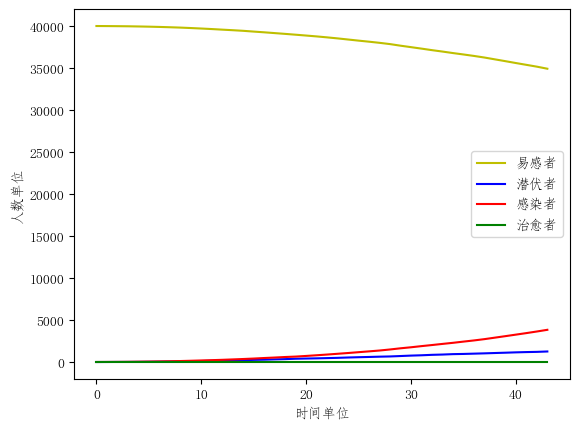

45


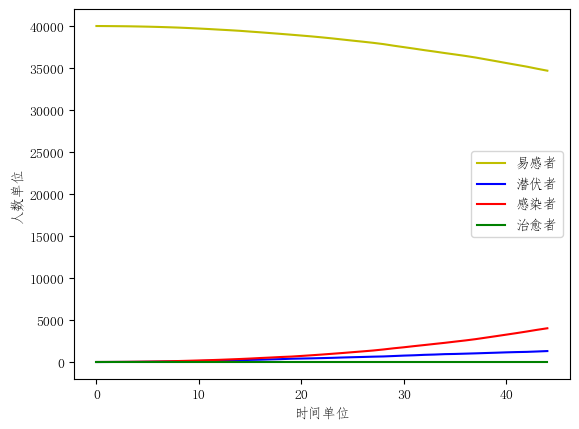

46


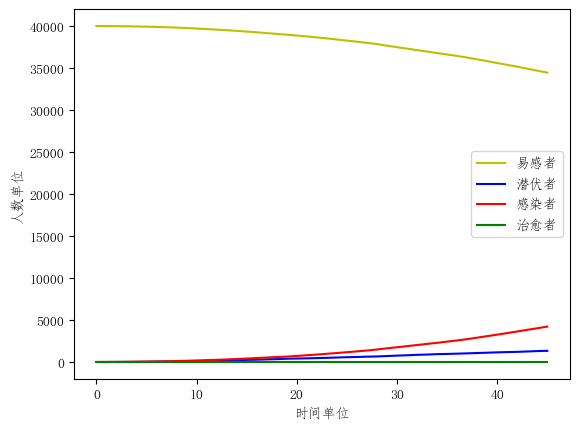

47


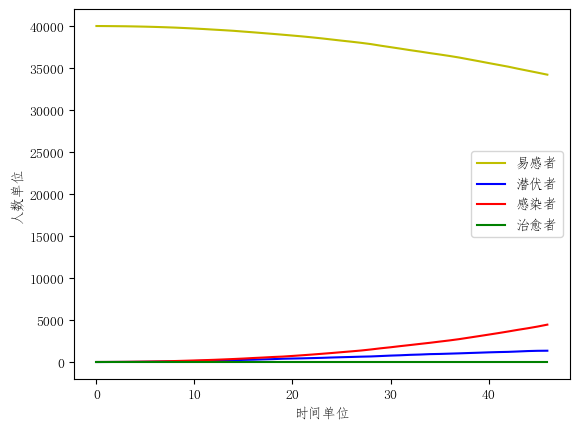

48


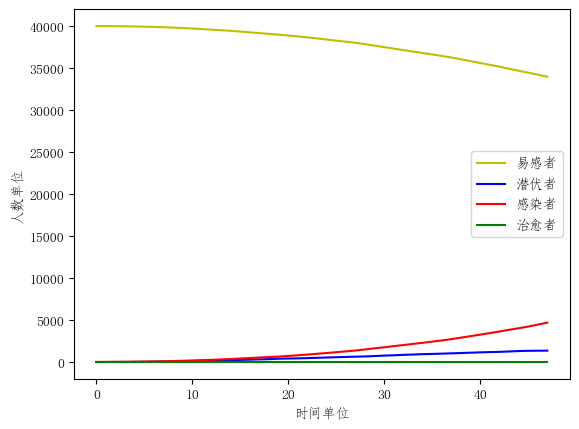

49


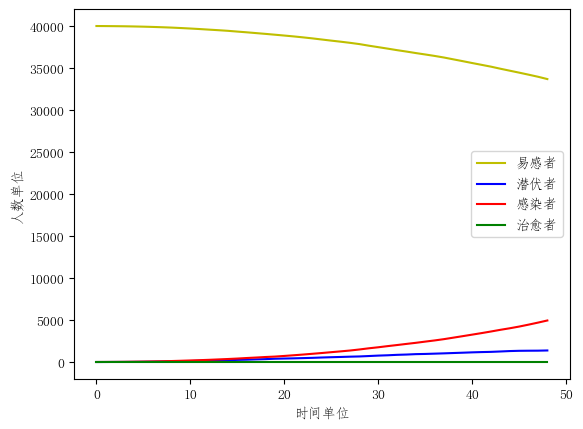

50


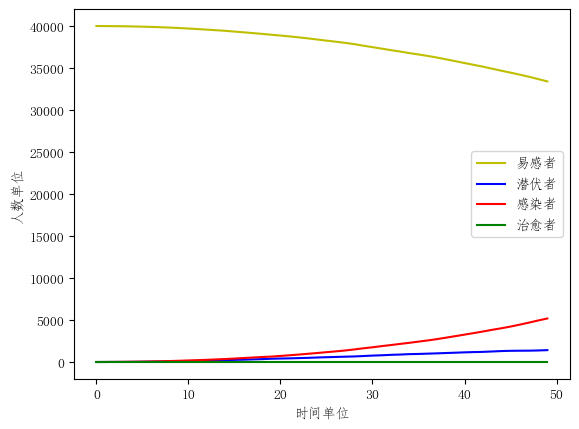

51


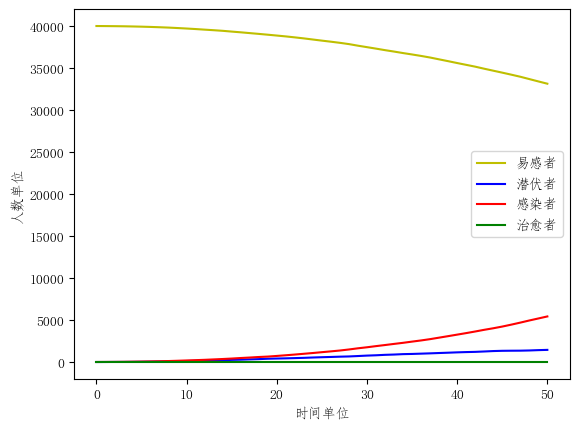

52


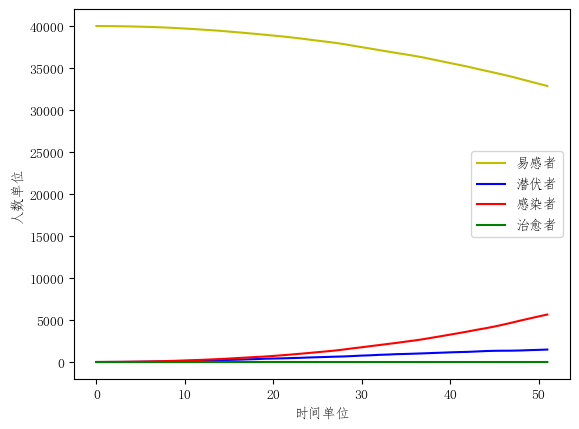

53


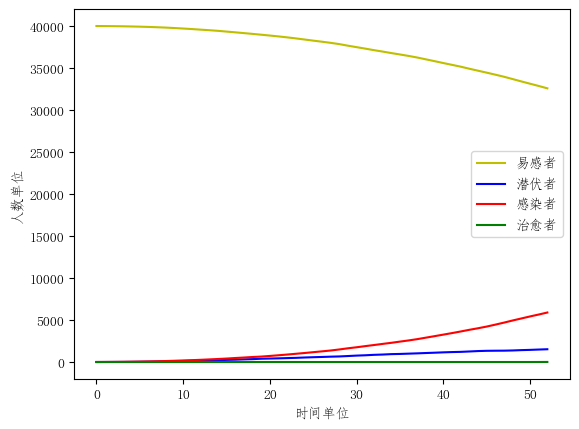

54


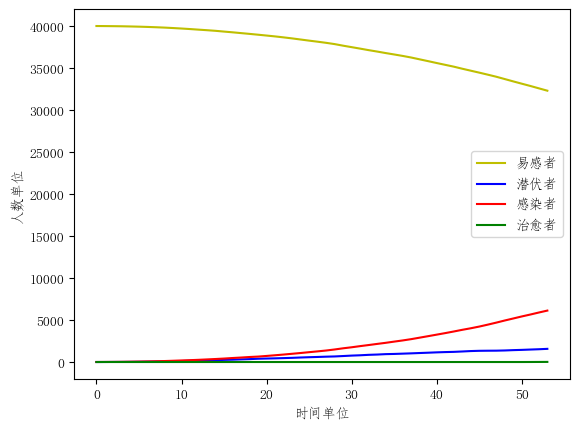

55


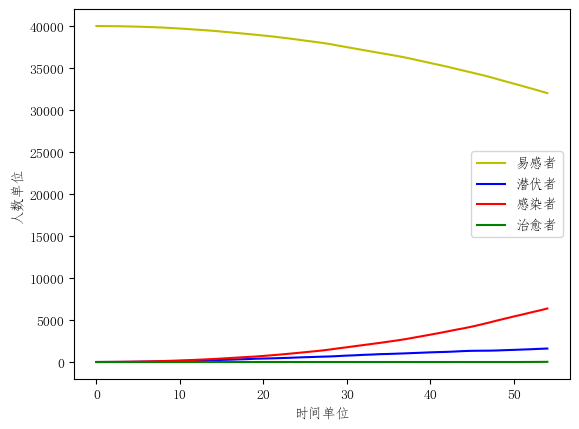

56


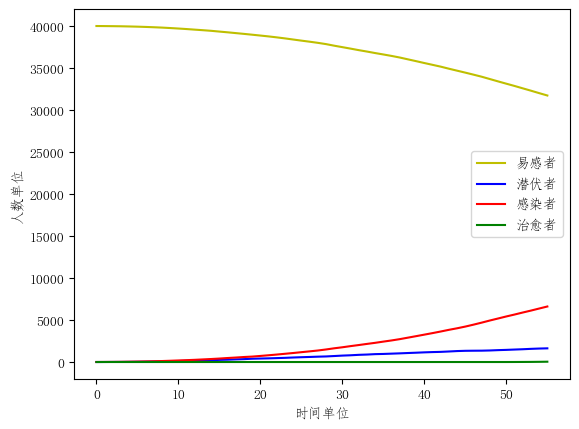

57


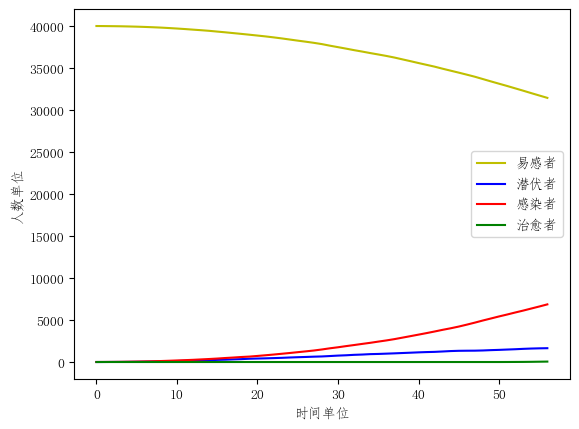

58


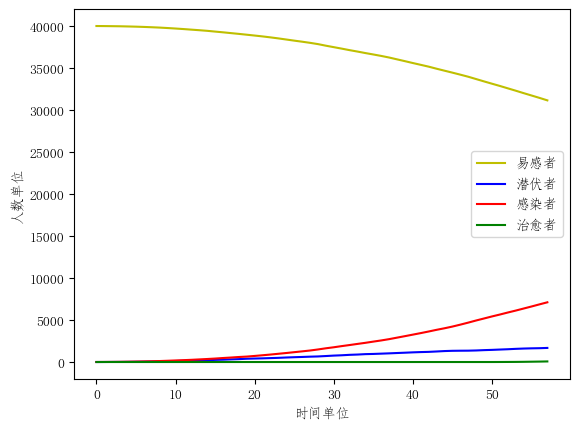

59


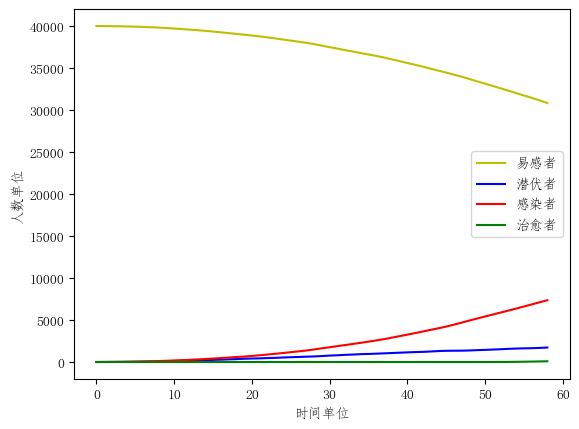

60


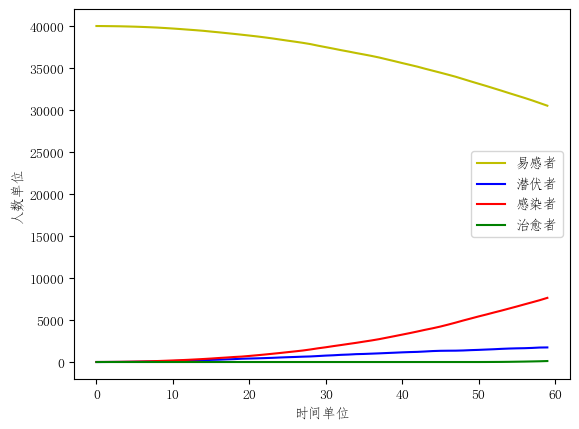

61


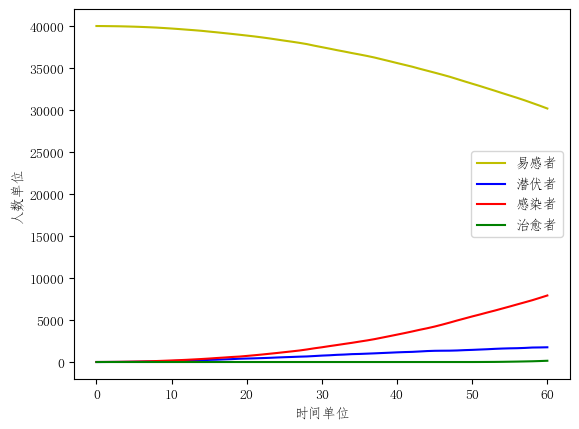

62


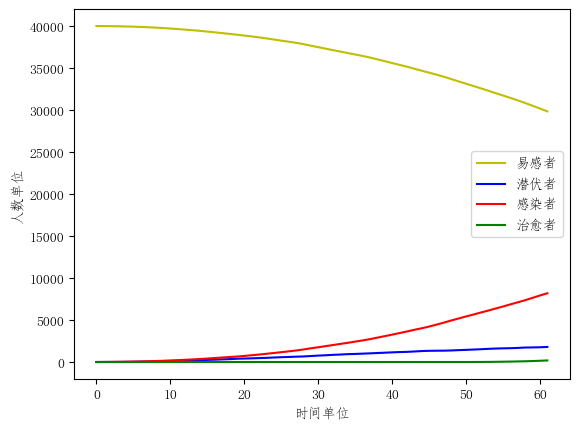

63


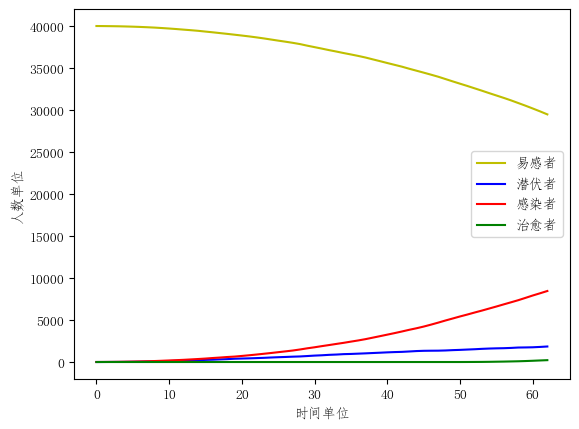

64


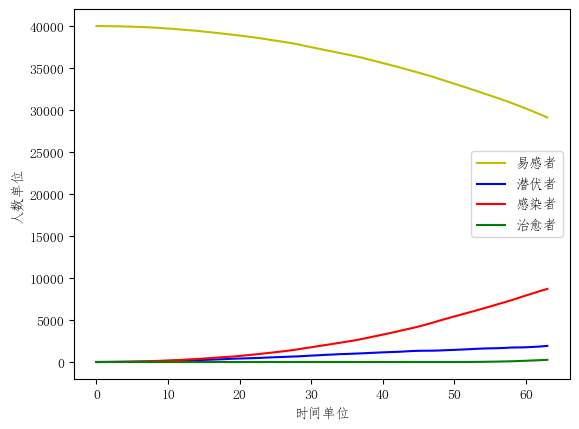

65


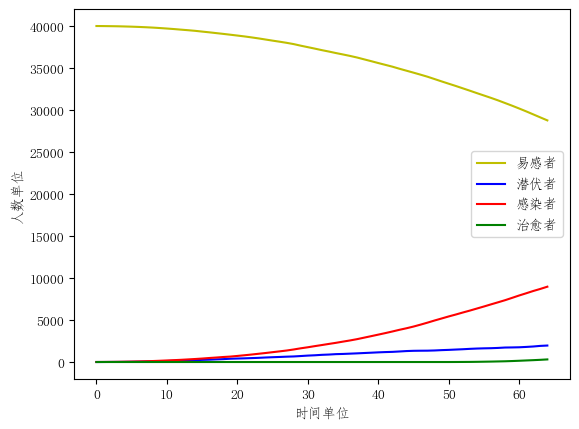

66


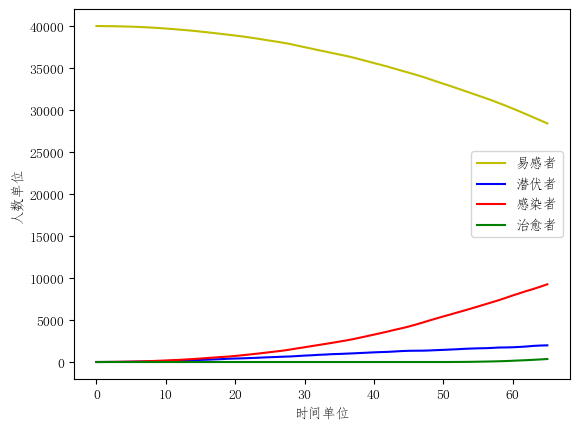

67


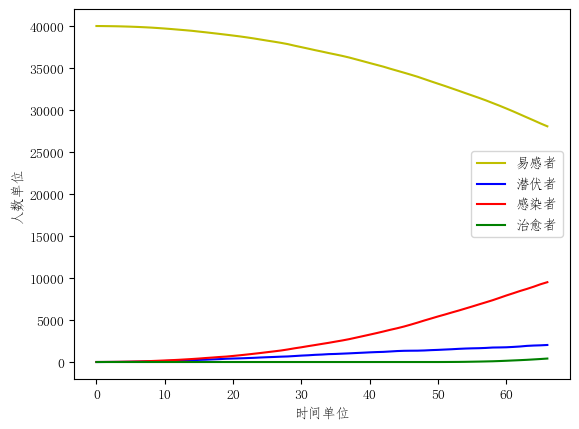

68


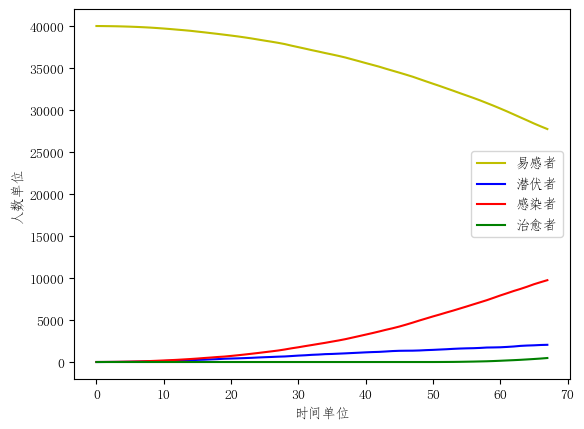

69


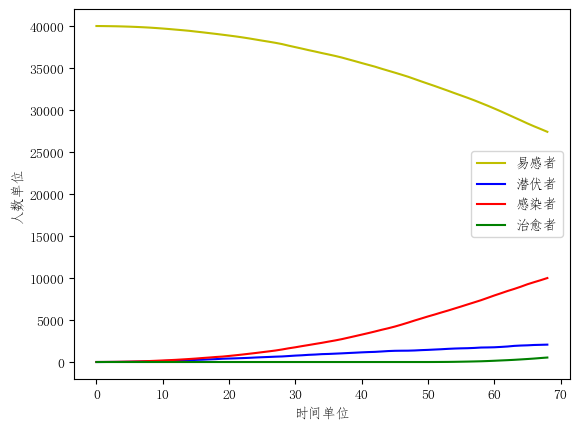

70


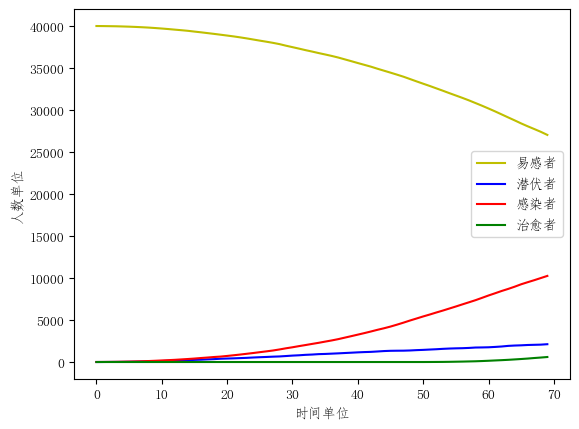

71


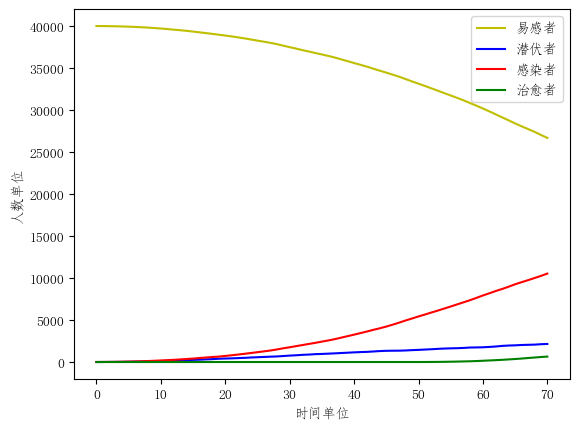

72


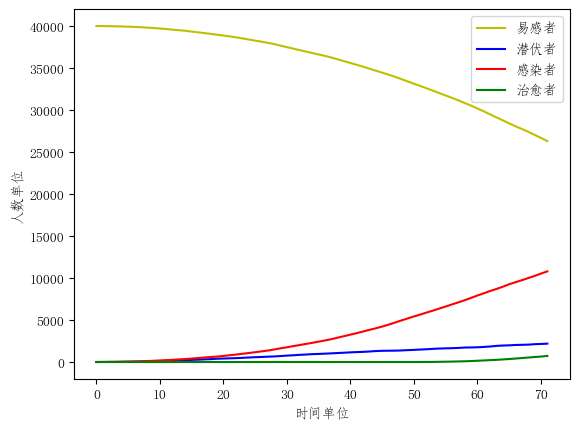

73


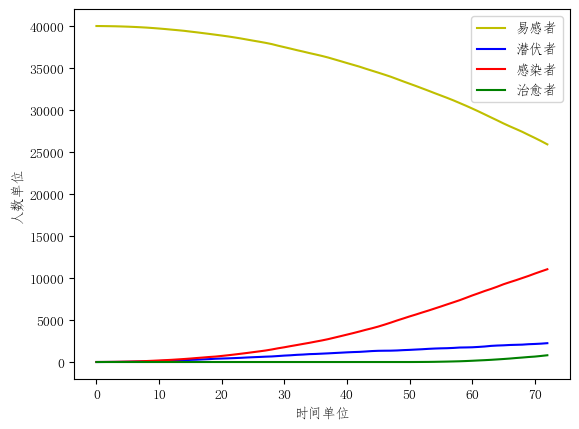

74


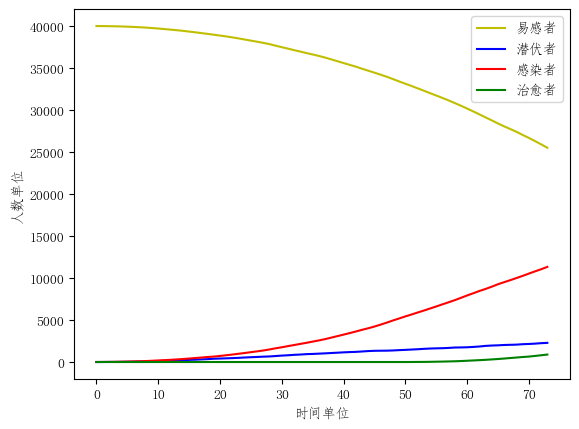

75


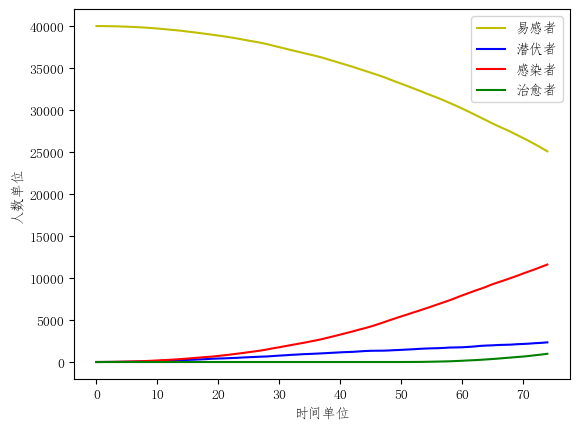

76


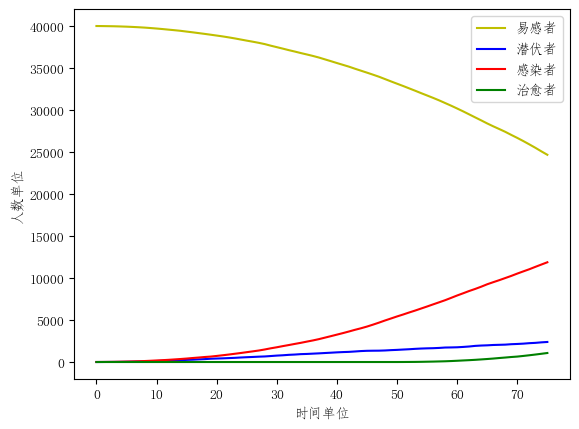

77


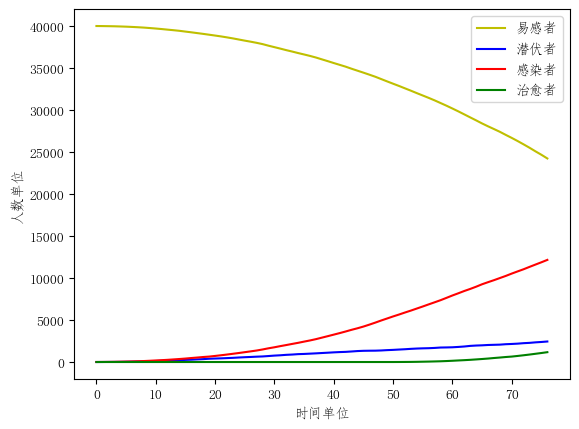

78


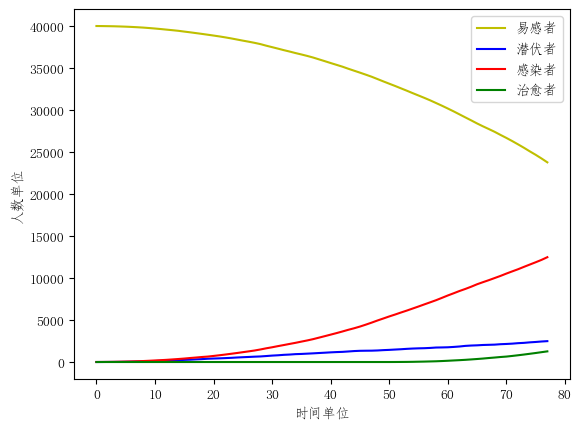

79


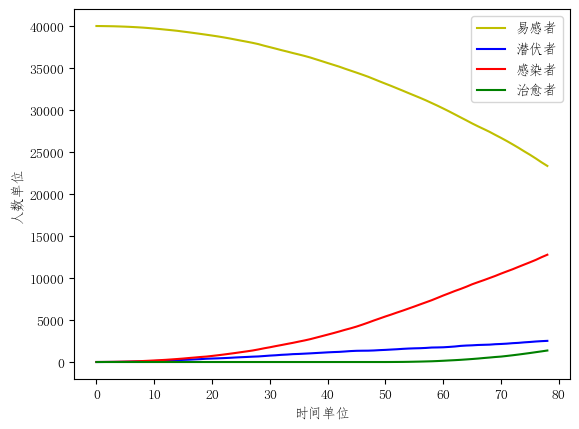

80


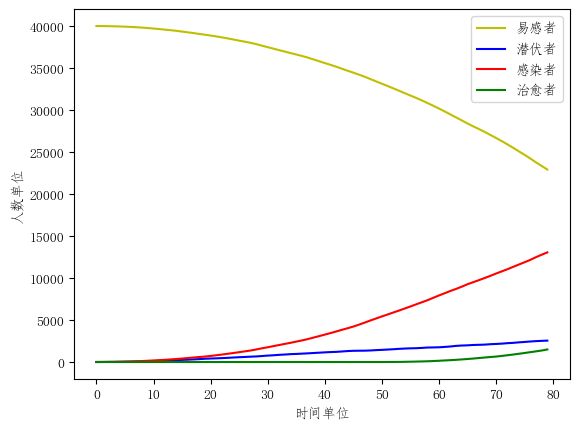

81


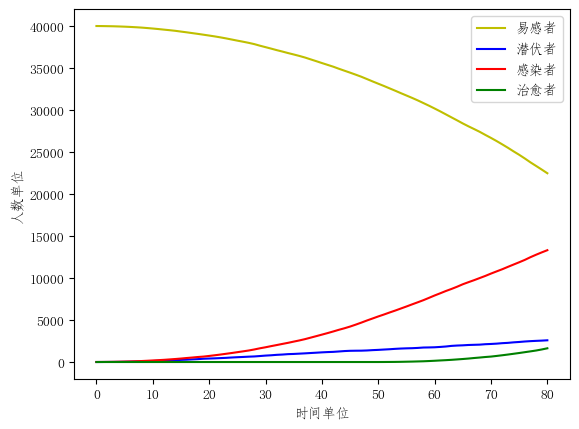

82


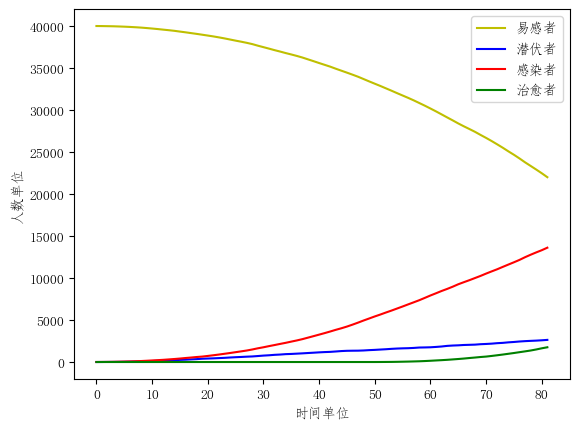

83


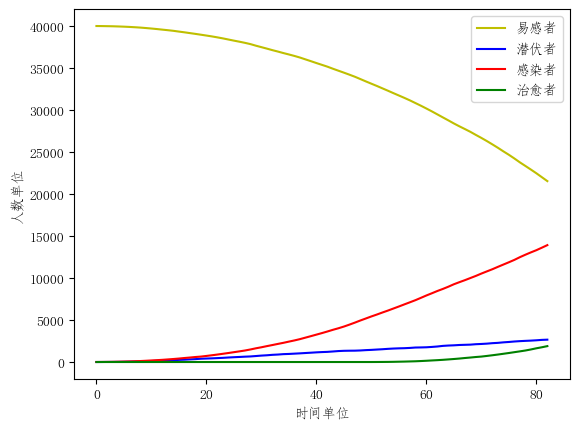

84


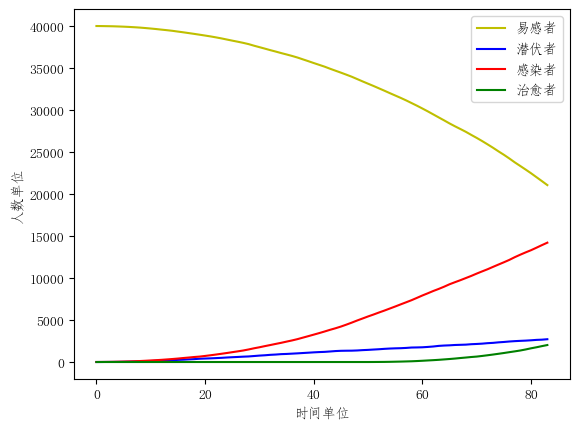

85


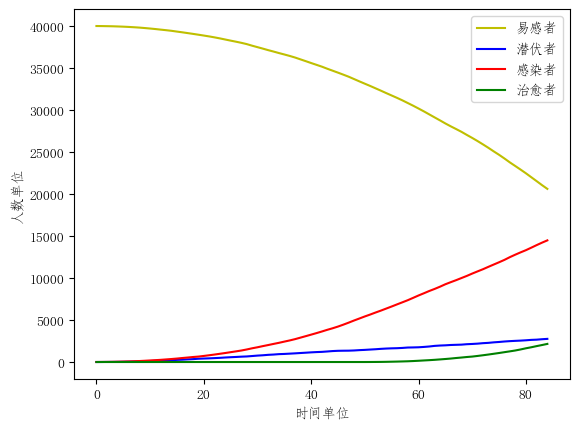

86


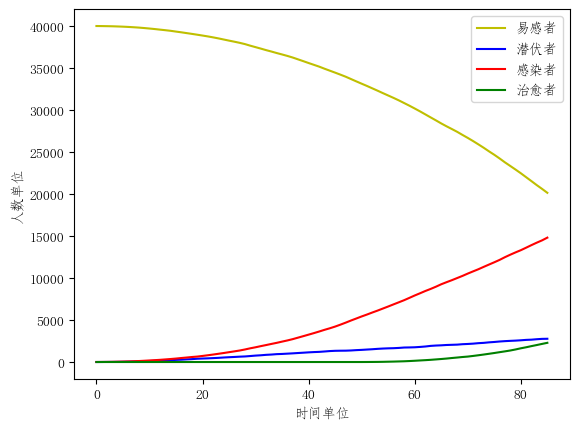

87


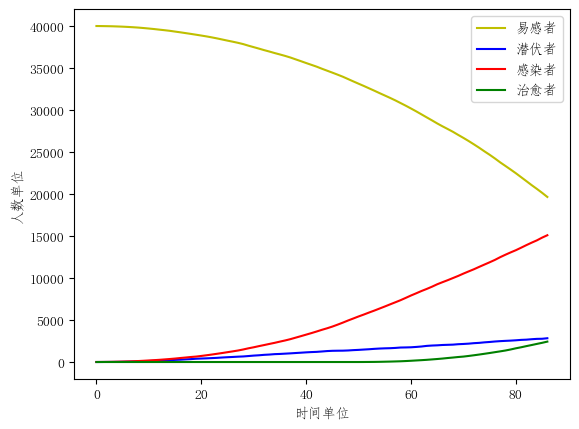

88


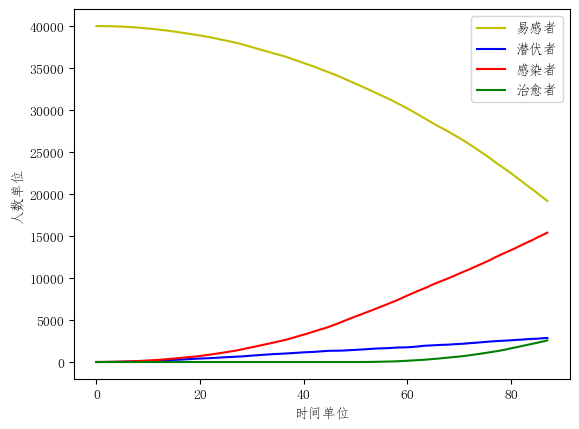

89


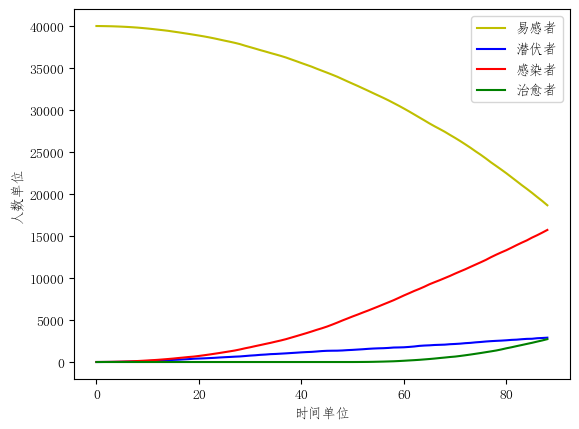

90


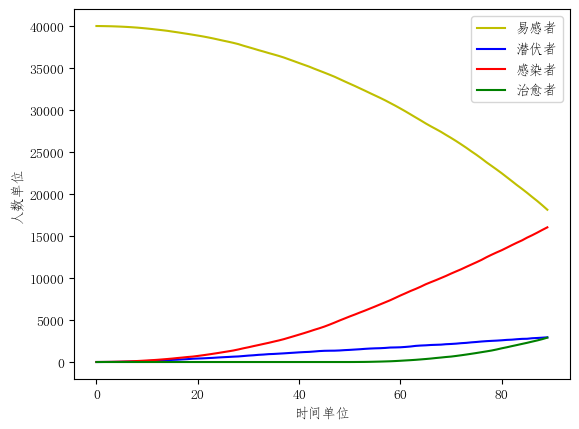

91


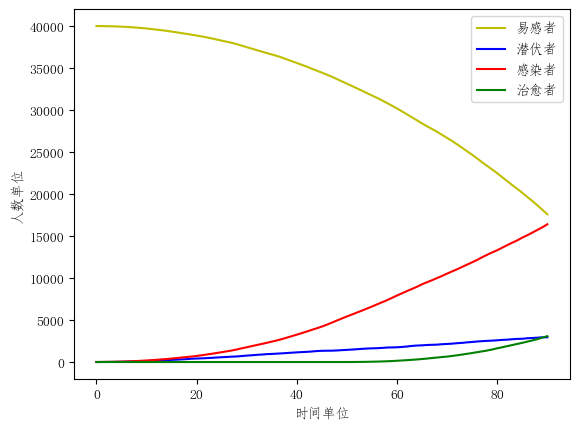

92


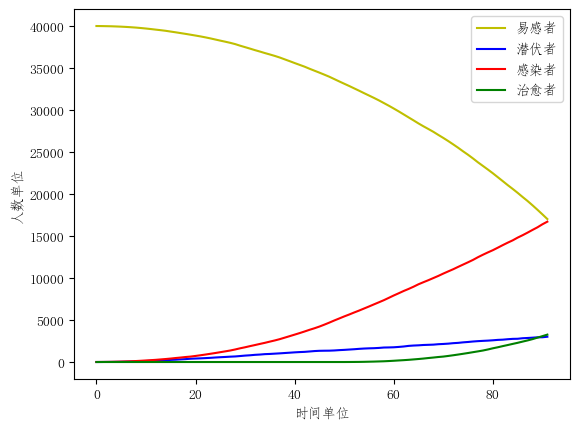

93


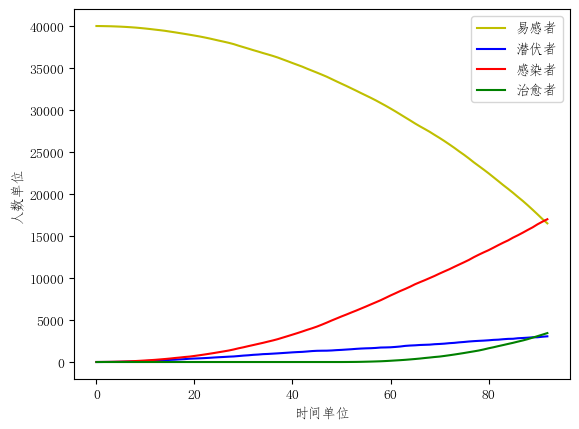

94


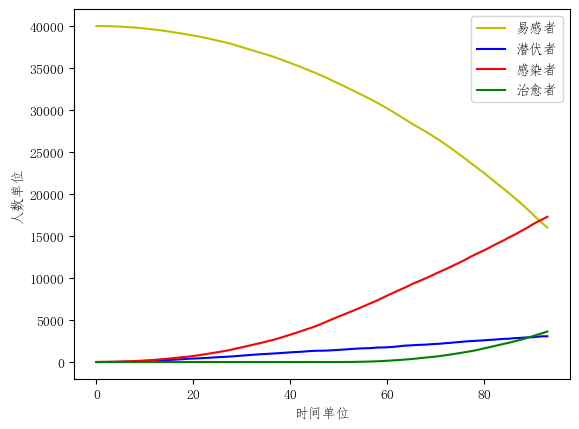

95


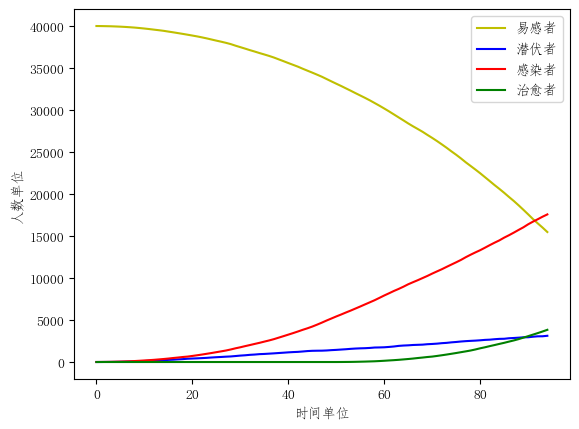

96


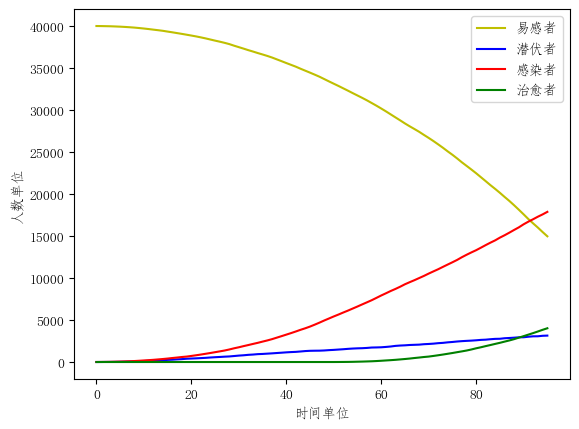

97


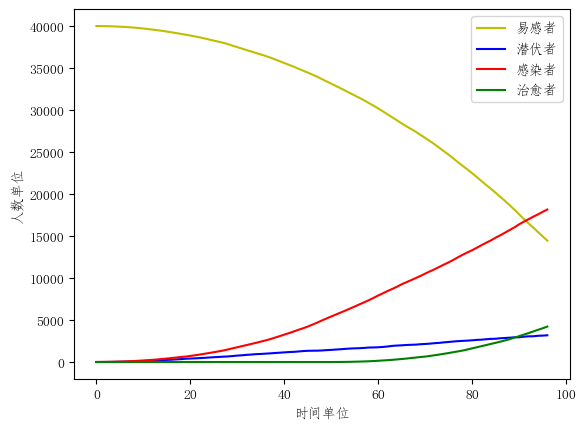

98


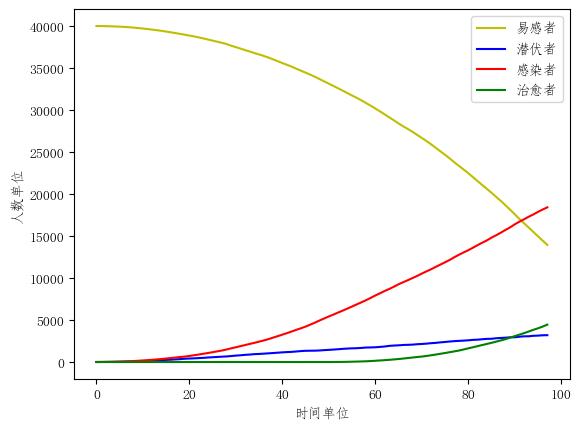

99


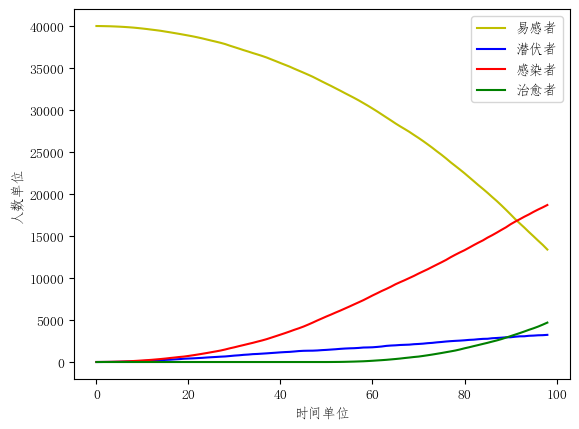

100


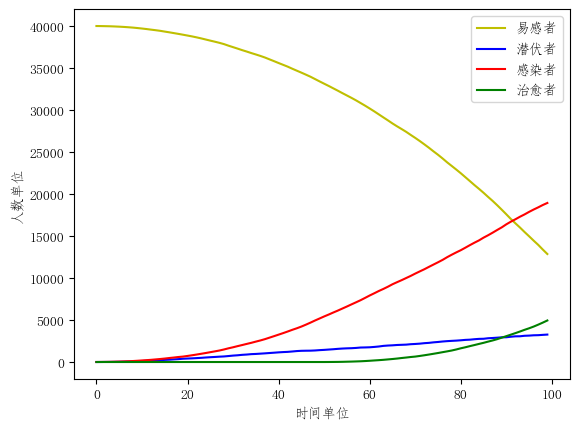

101


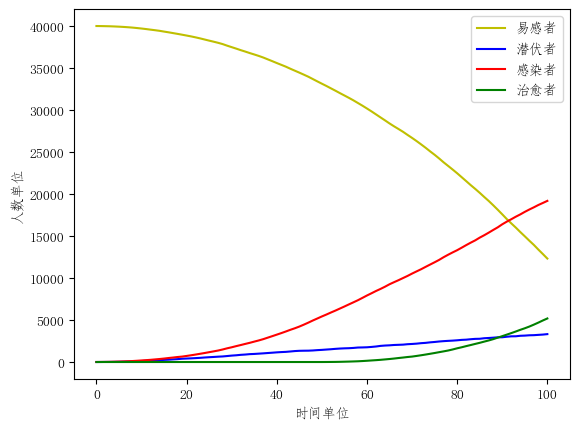

102


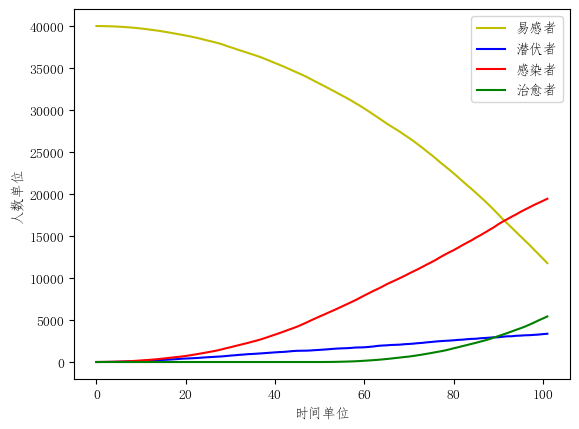

103


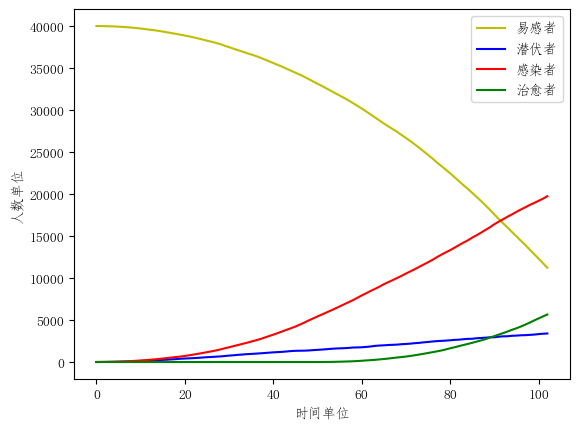

104


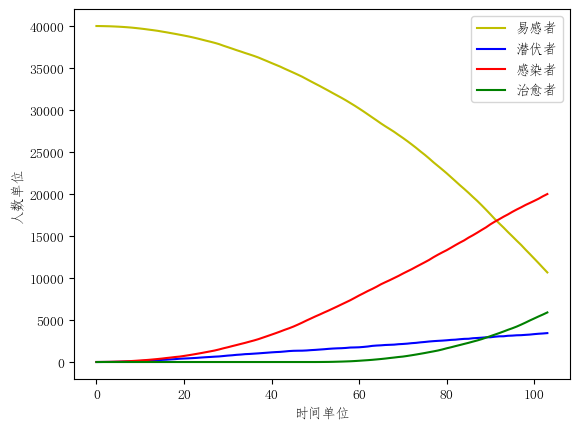

105


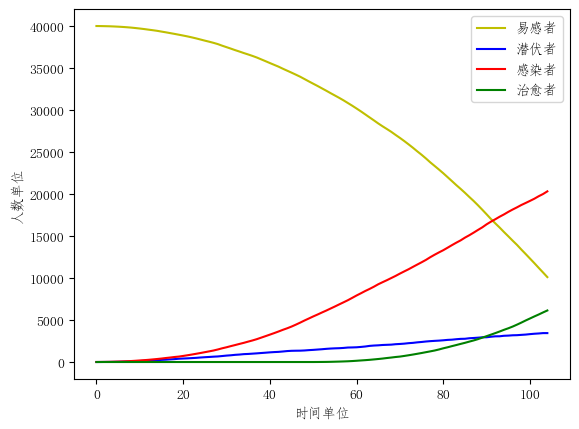

106


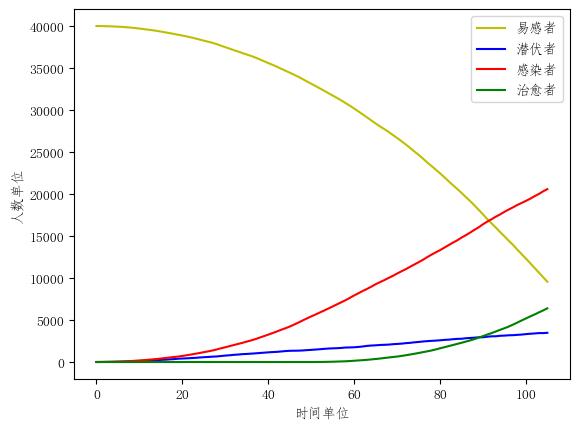

107


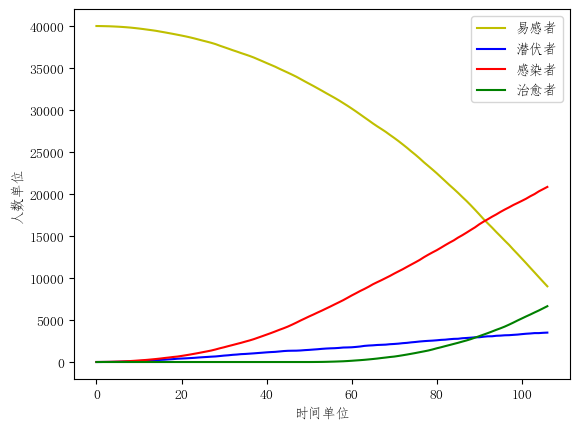

108


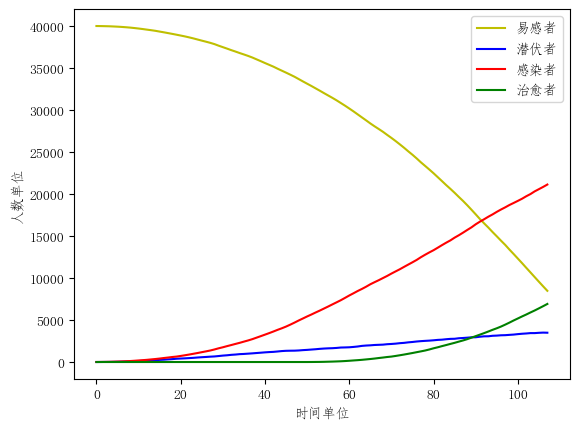

109


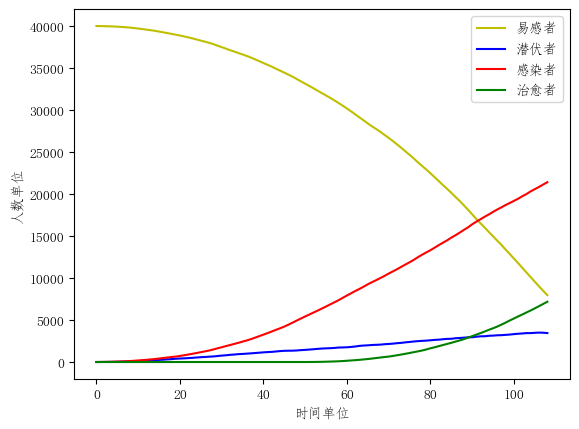

110


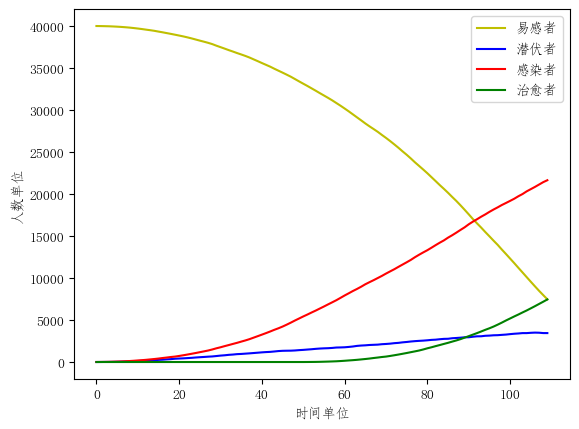

111


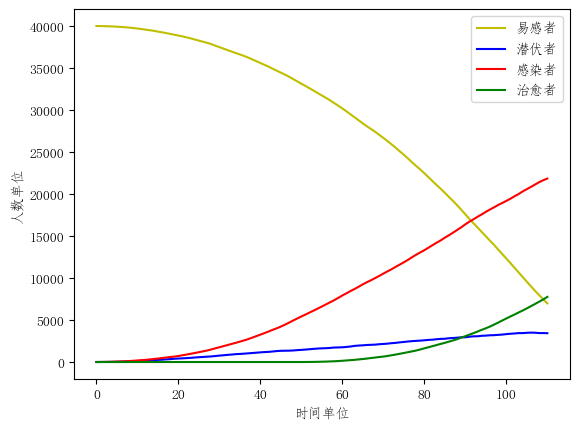

112


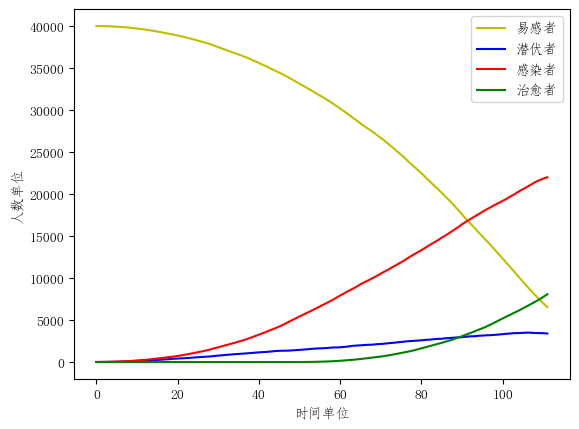

113


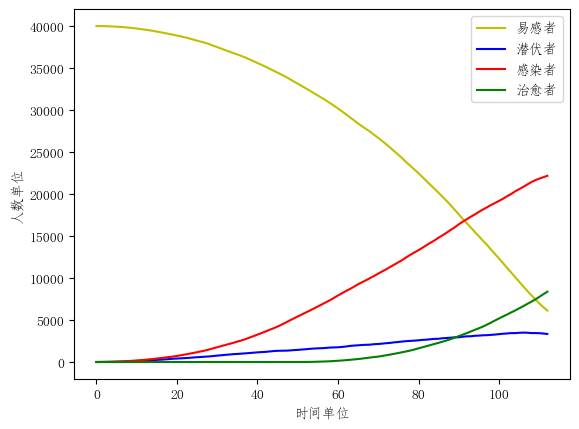

114


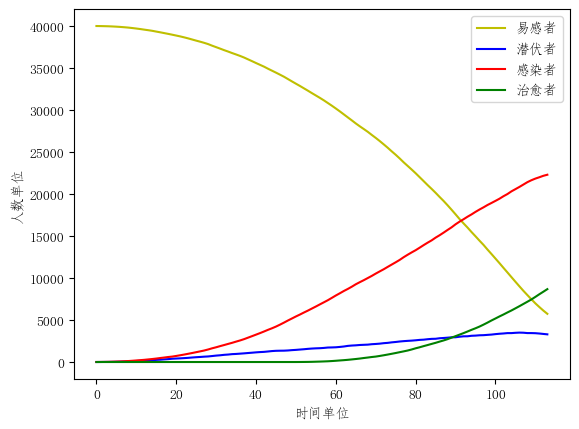

115


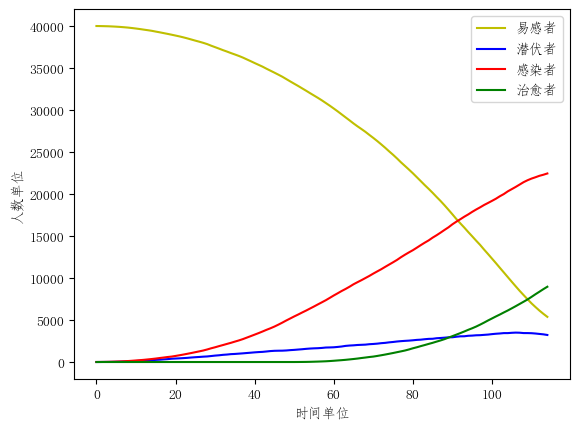

116


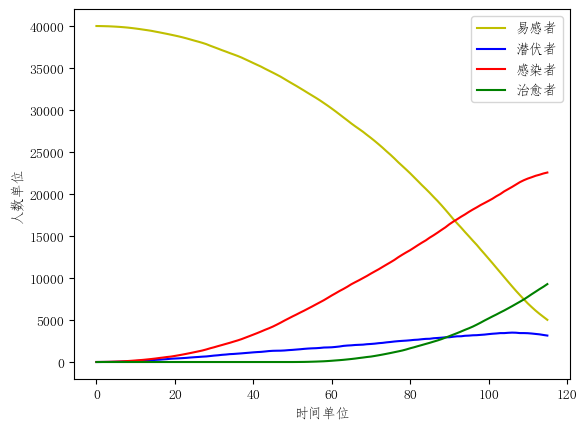

117


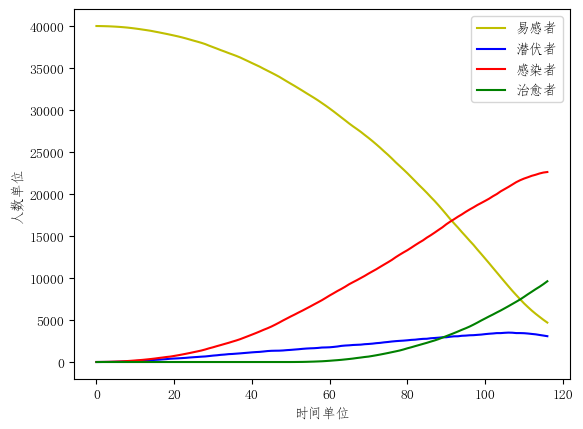

118


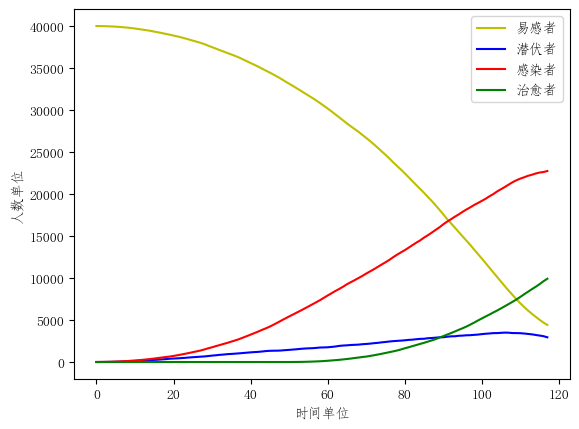

119


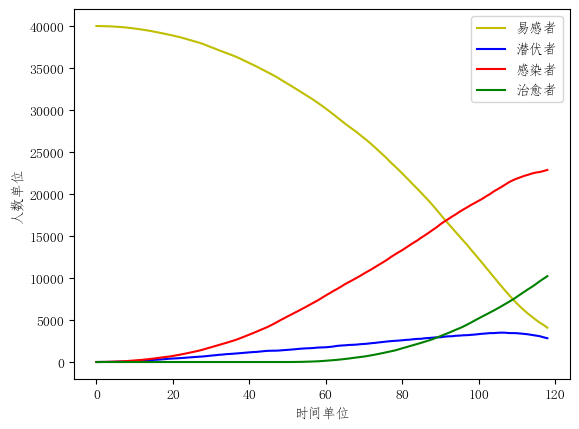

120


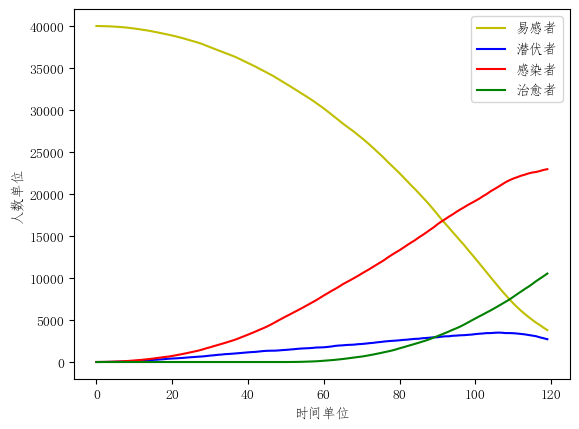

121


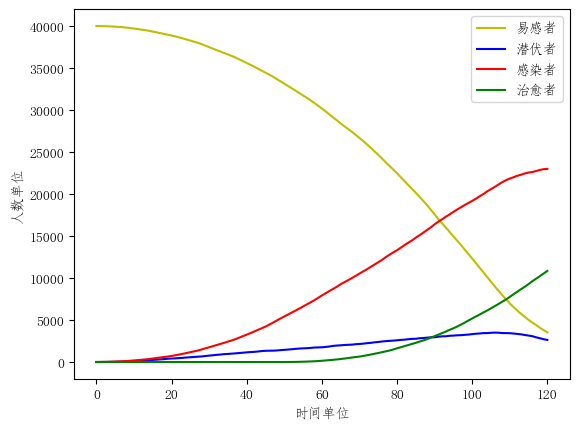

122


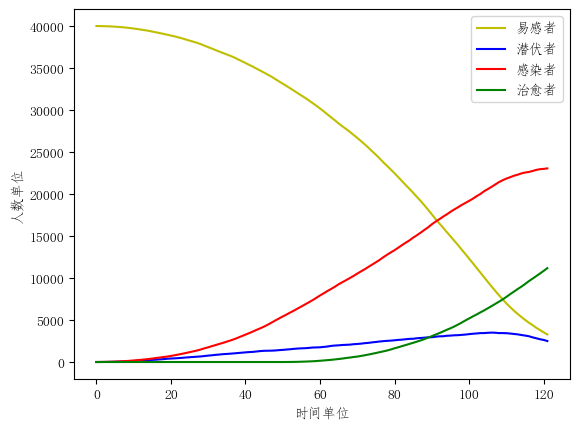

123


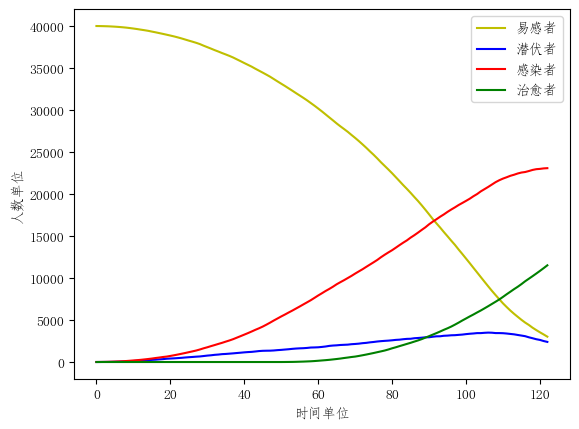

124


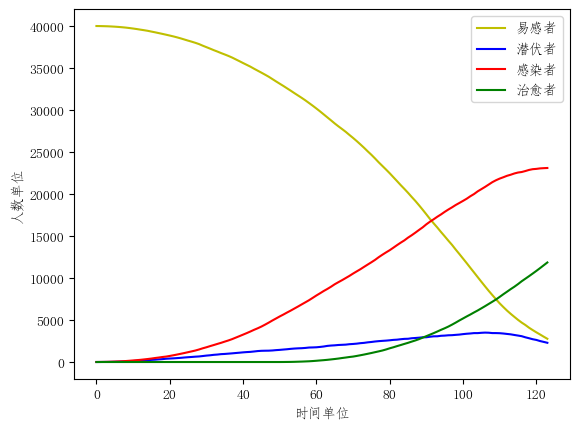

125


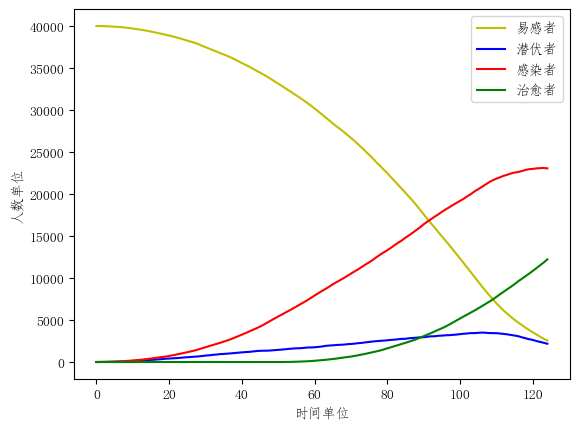

126


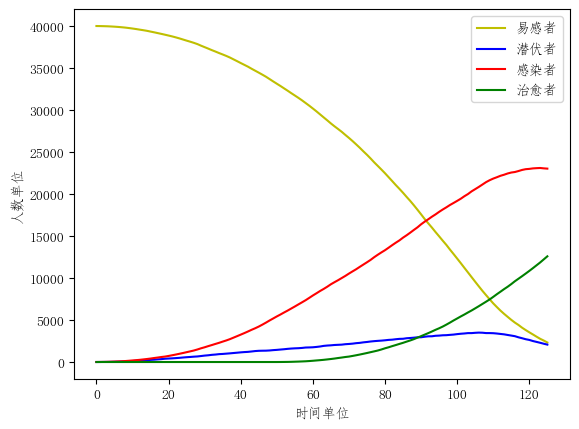

127


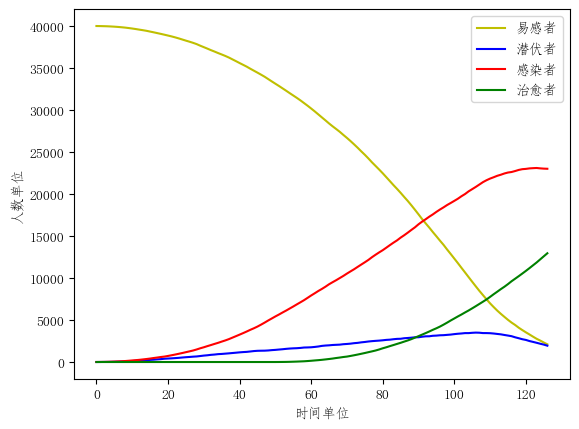

128


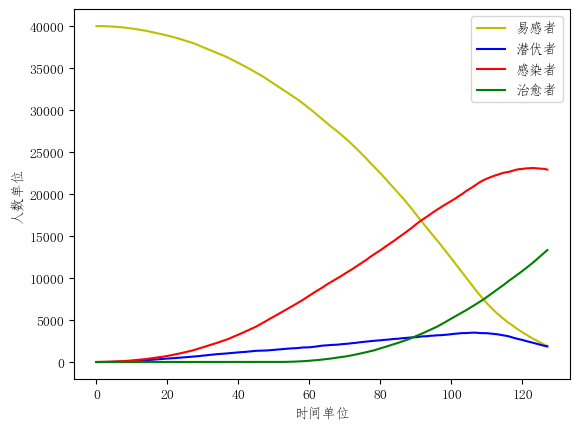

129


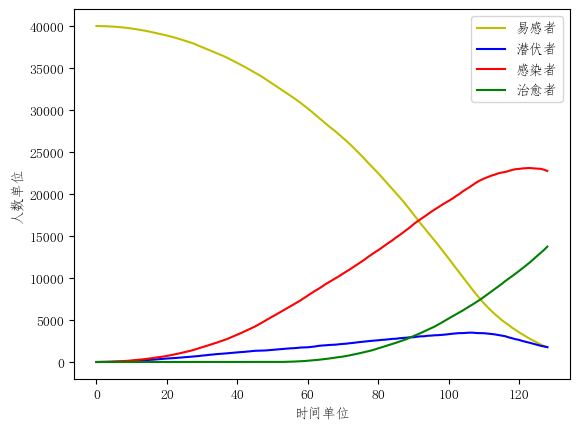

130


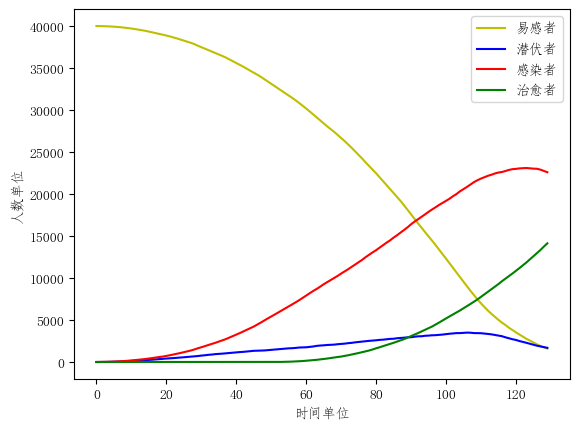

131


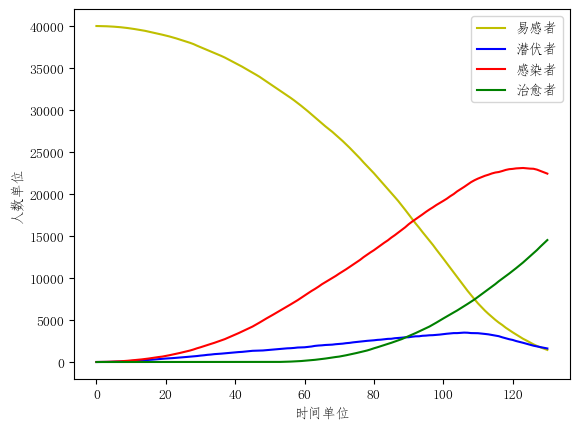

132


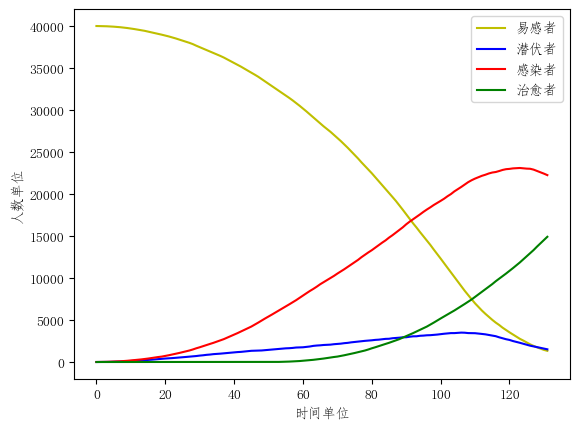

133


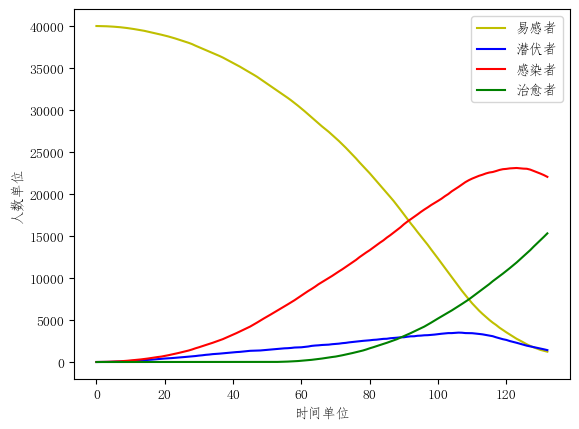

134


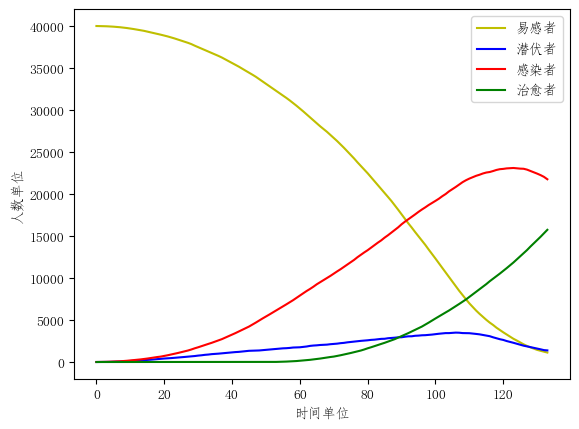

135


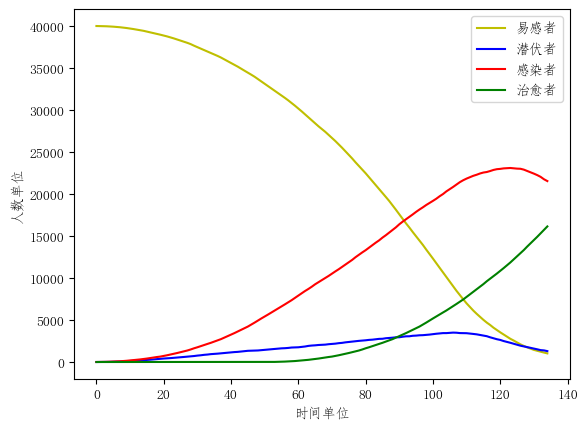

136


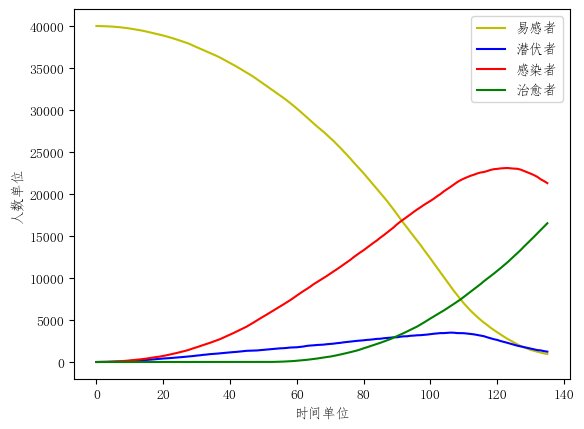

137


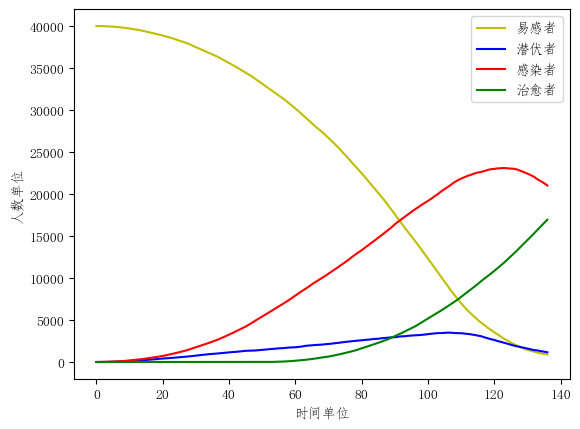

138


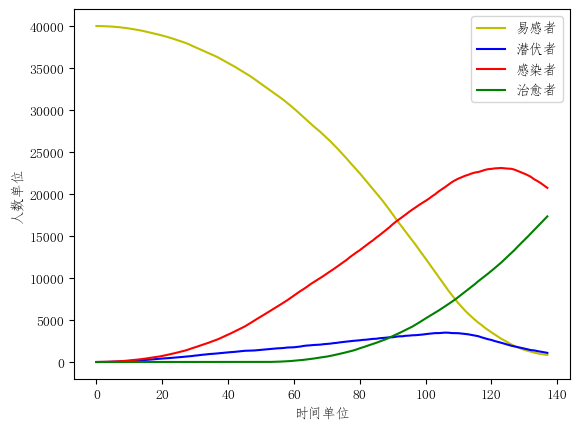

139


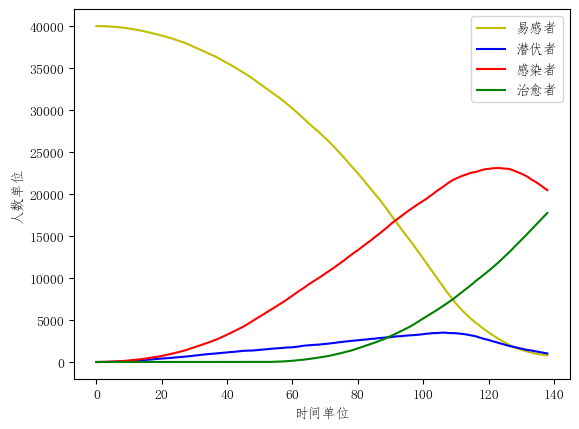

140


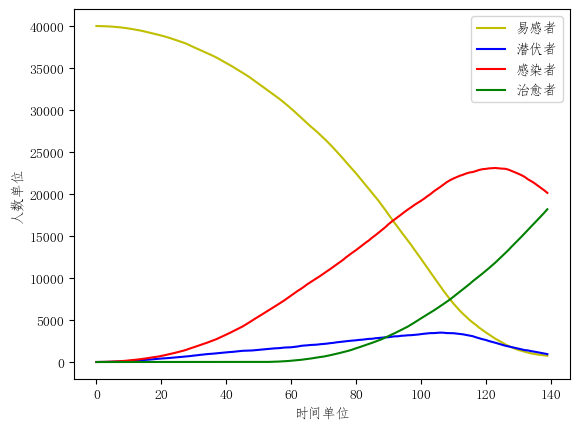

141


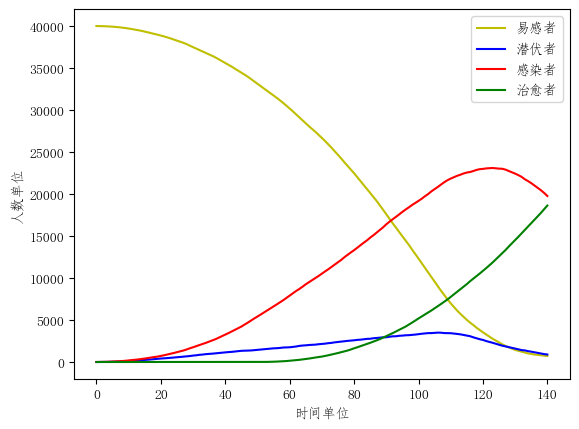

142


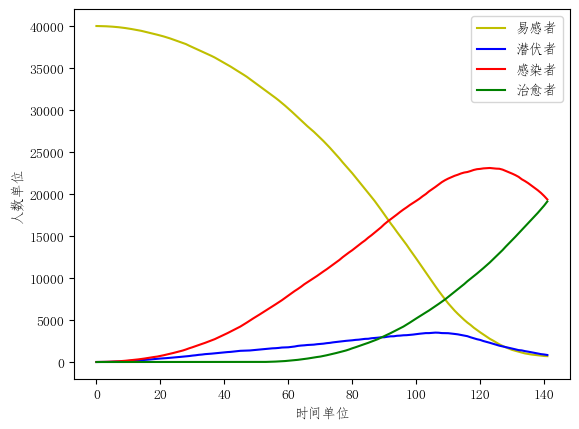

143


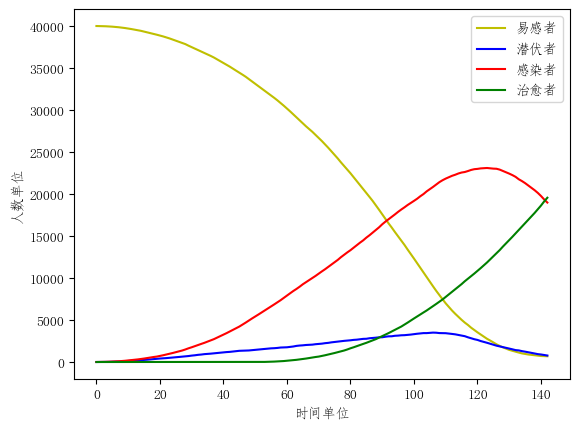

144


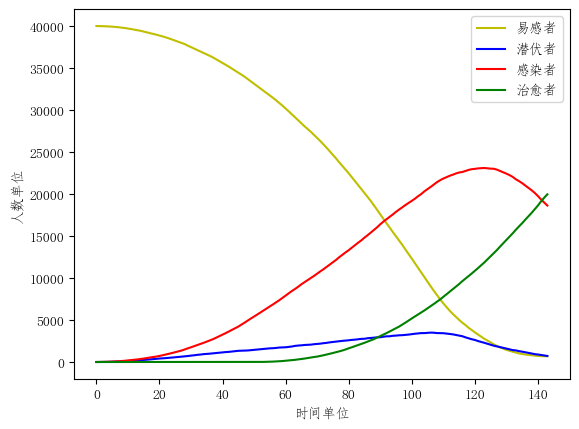

145


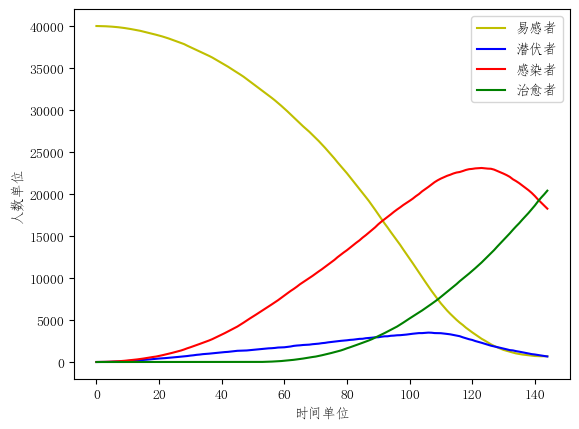

146


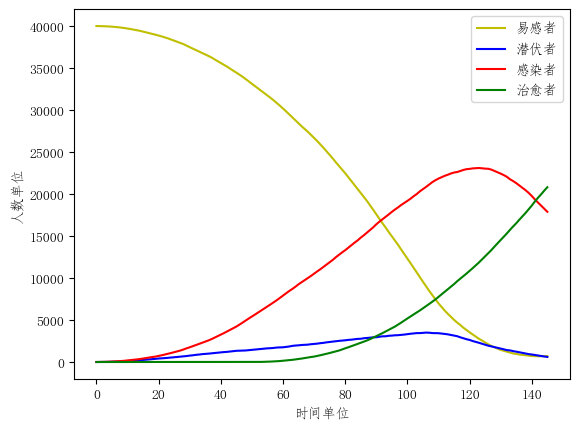

147


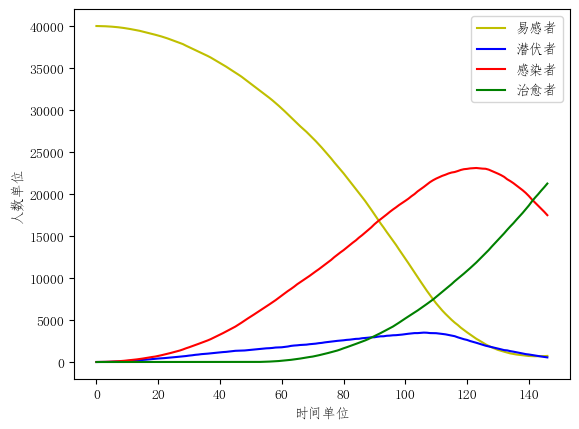

148


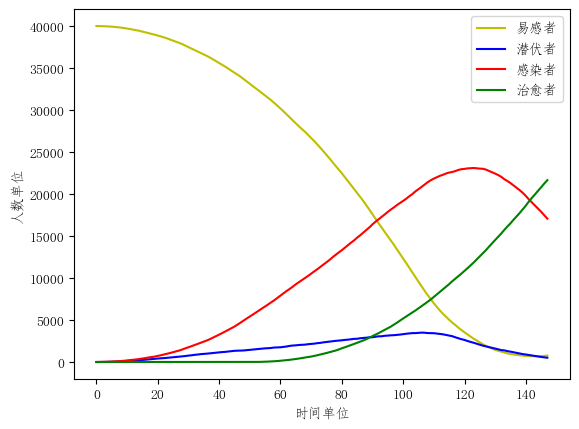

149


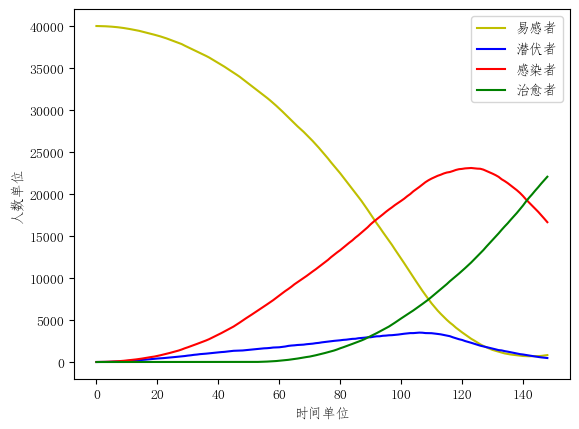

150


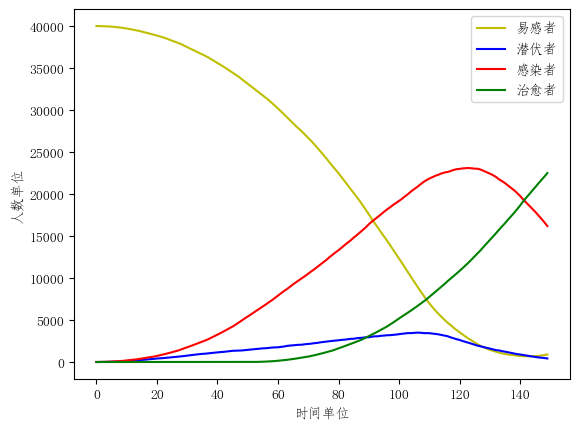

151


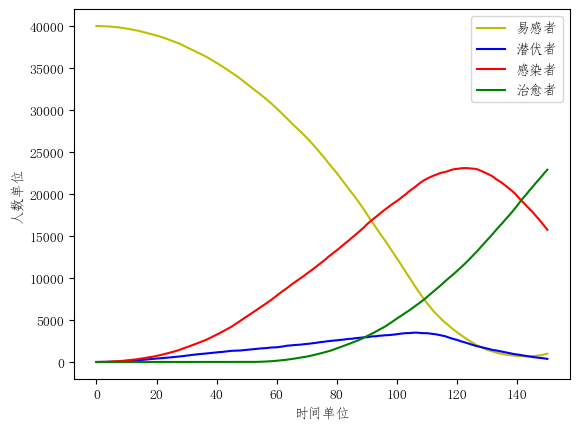

152


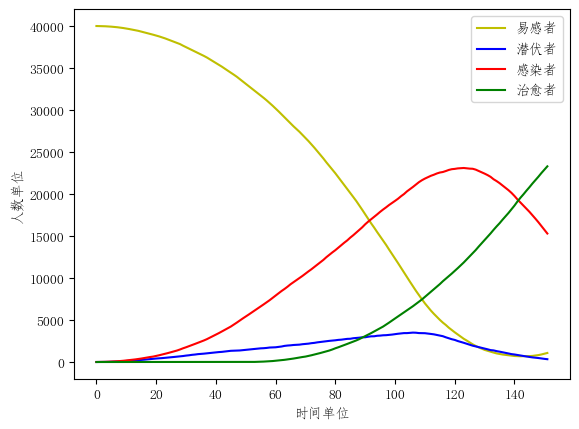

153


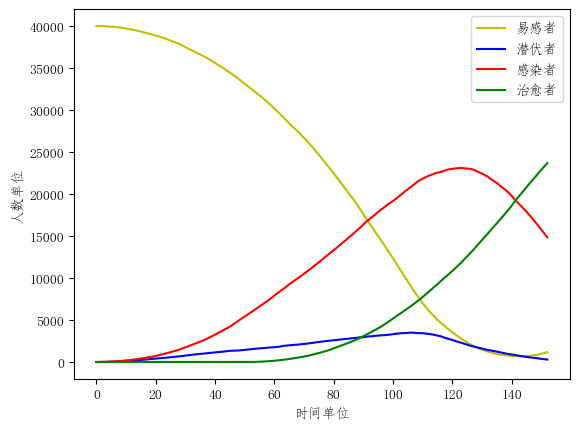

154


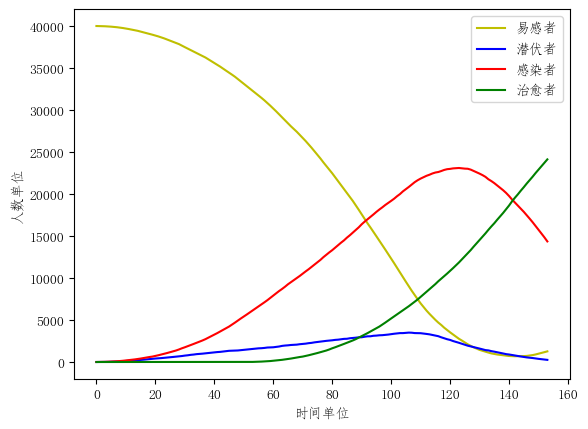

155


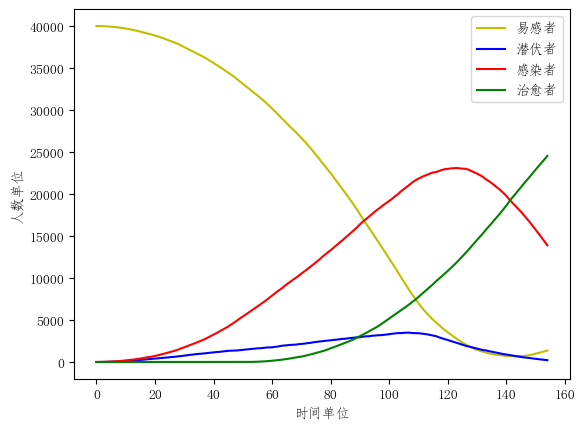

156


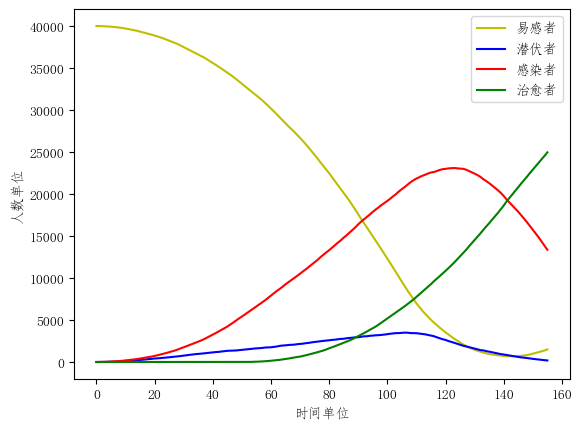

157


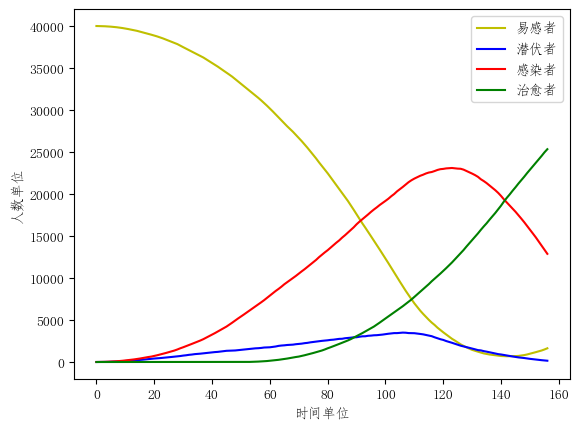

158


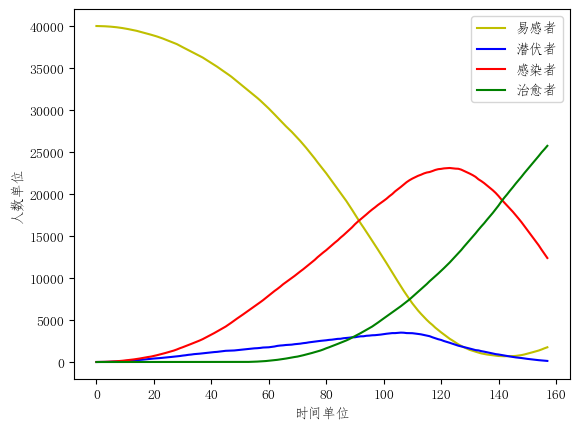

159


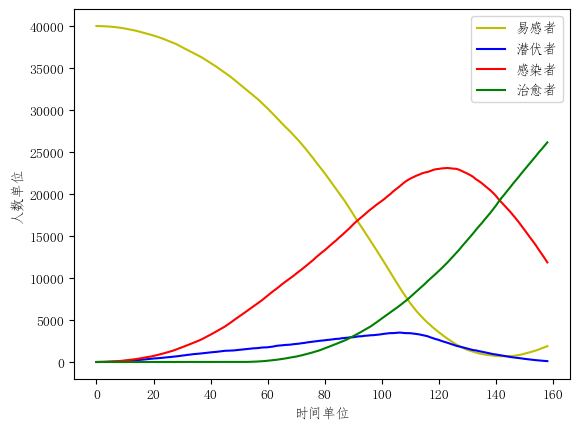

160


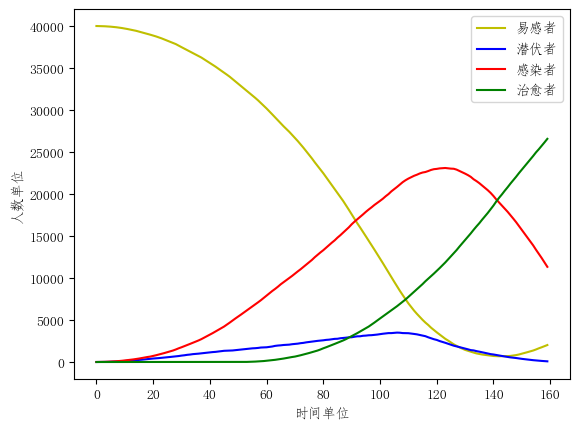

161


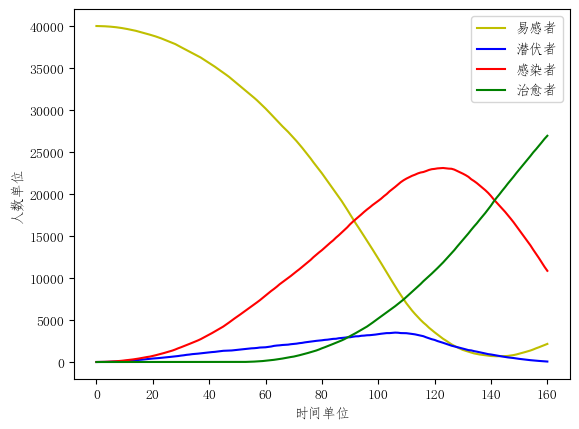

162


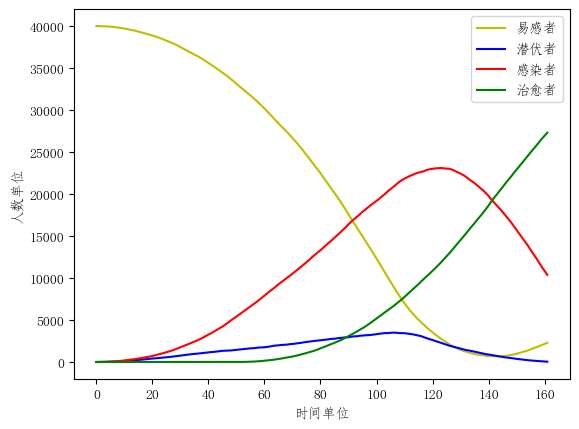

163


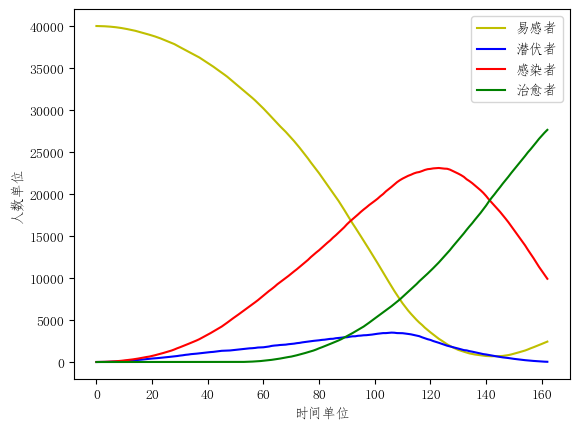

164


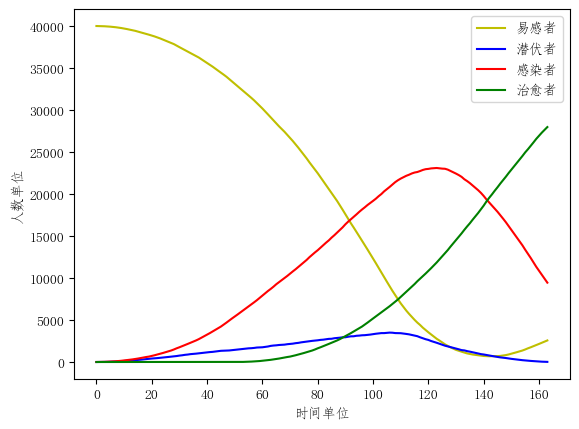

165


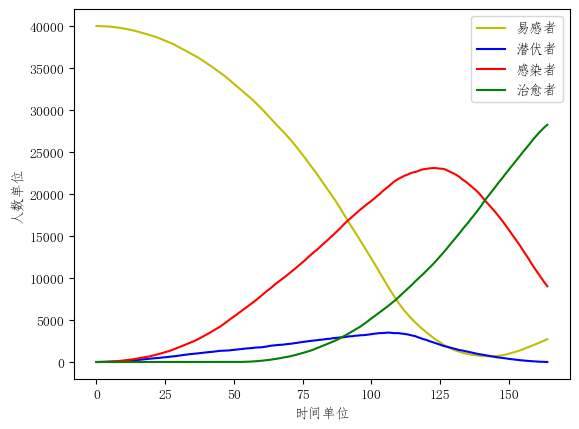

166


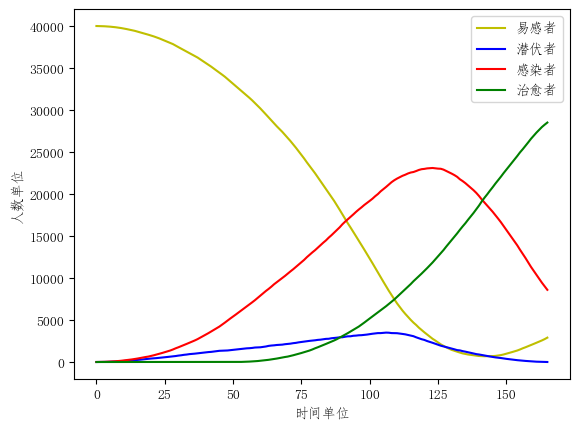

167


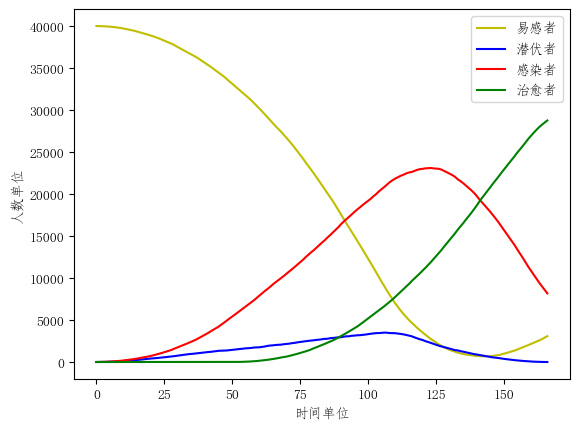

168


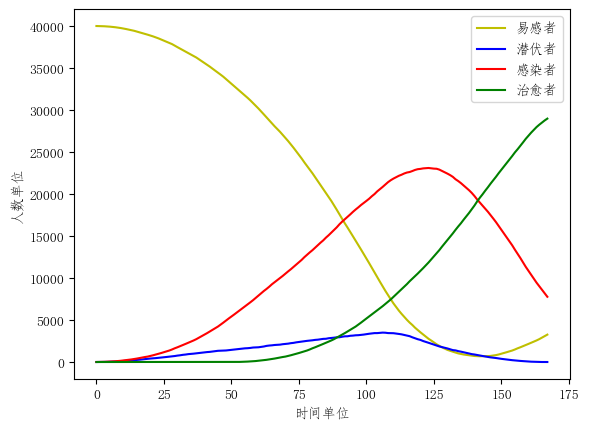

169


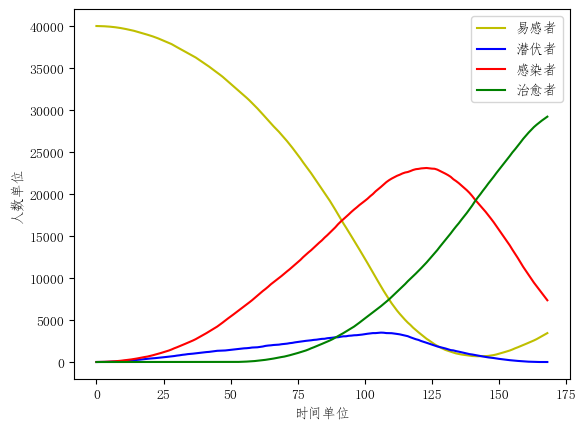

170


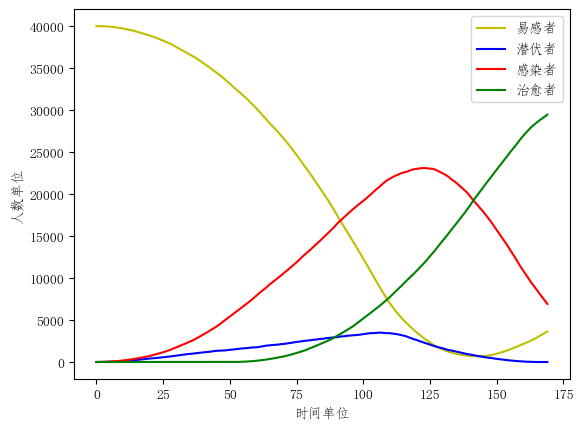

171


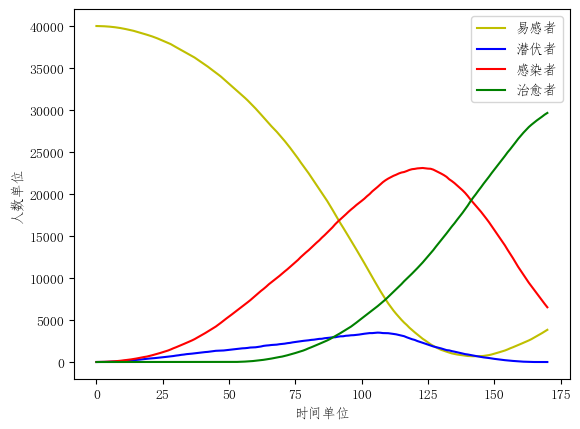

172


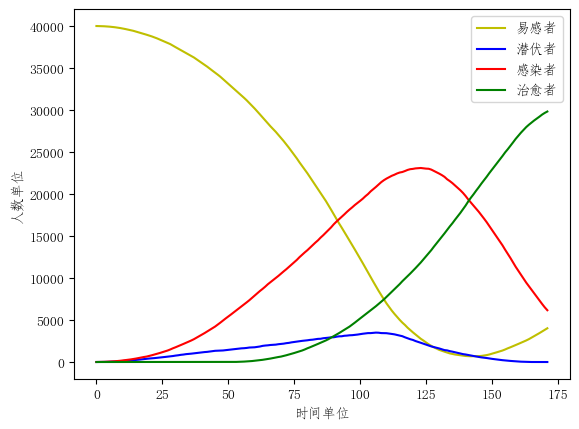

173


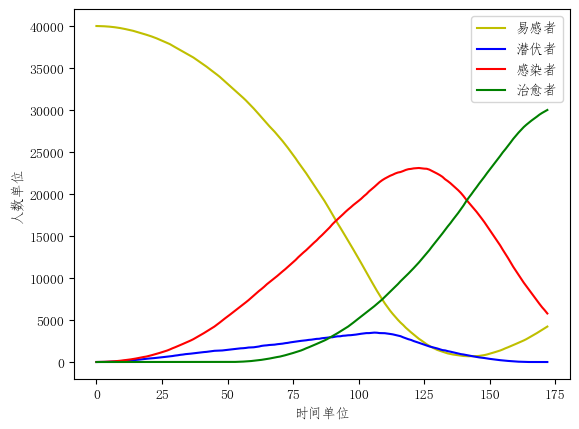

174


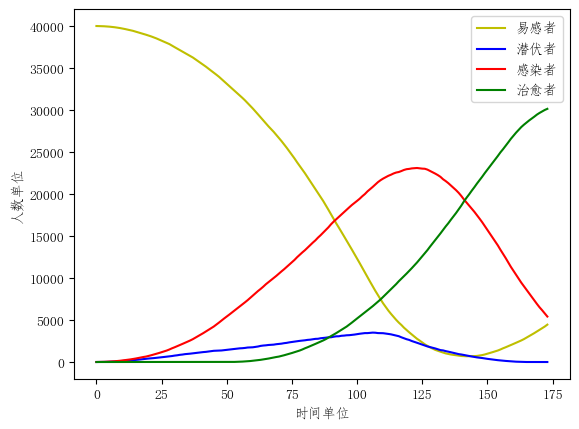

175


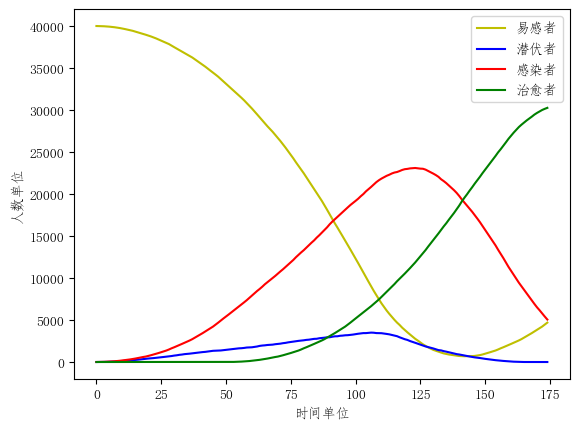

176


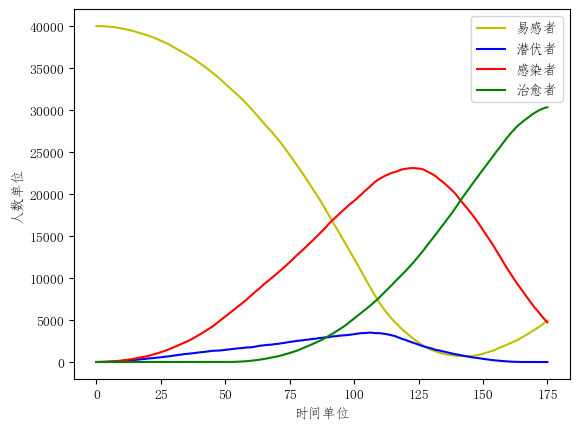

177


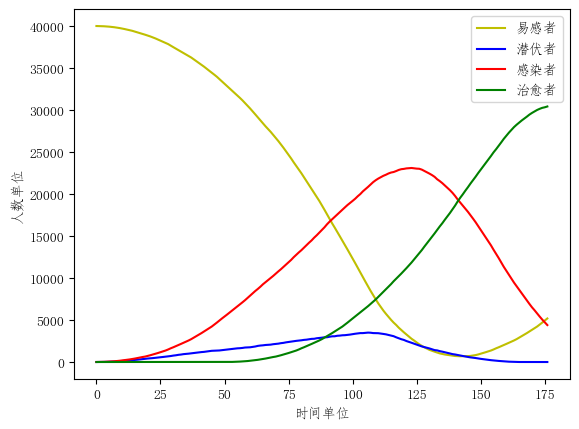

178


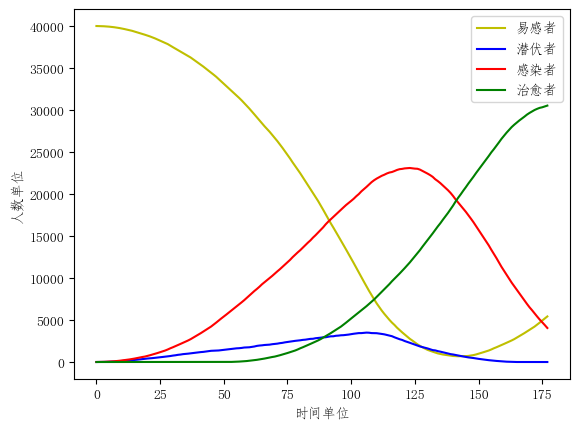

179


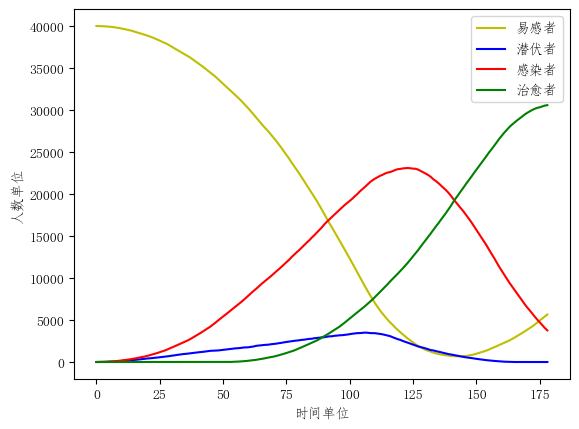

180


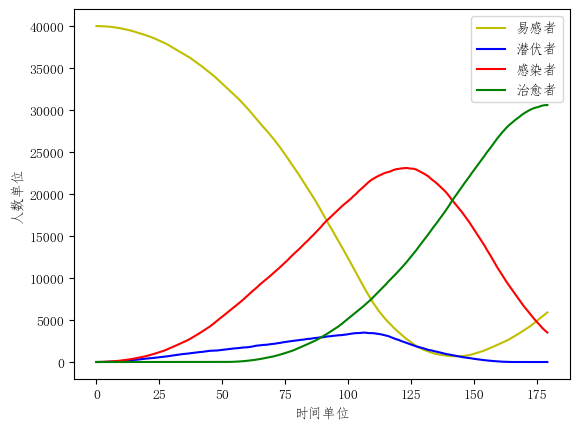

181


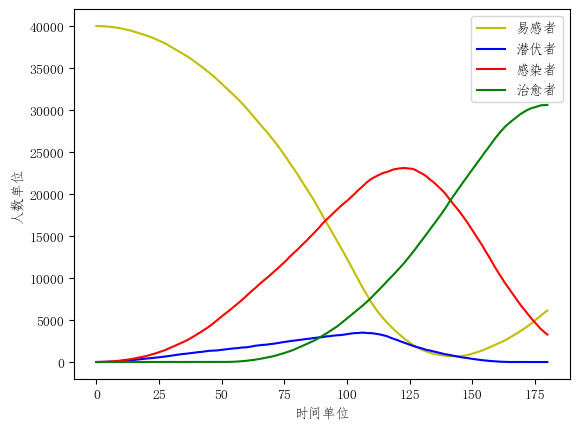

182


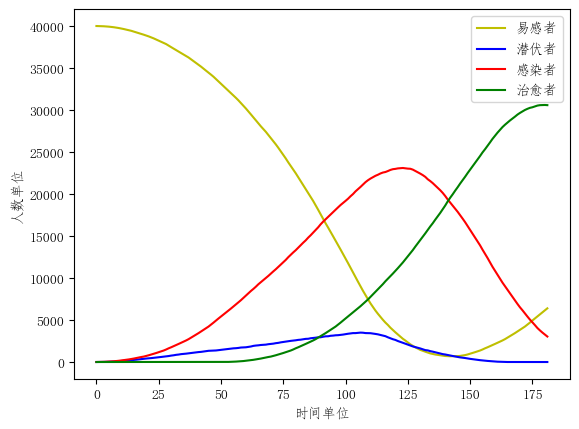

183


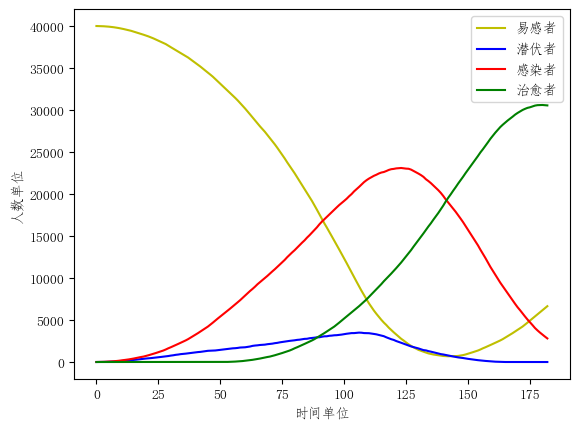

184


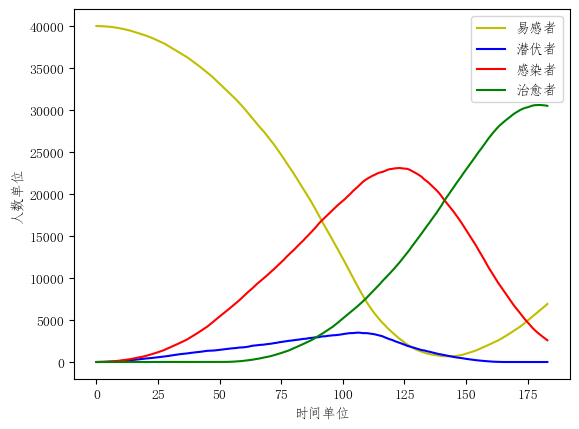

185


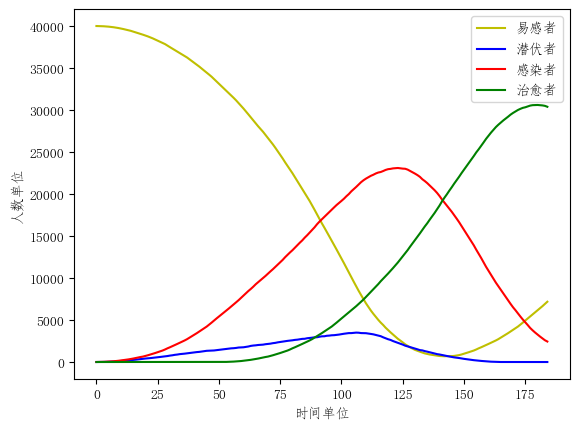

186


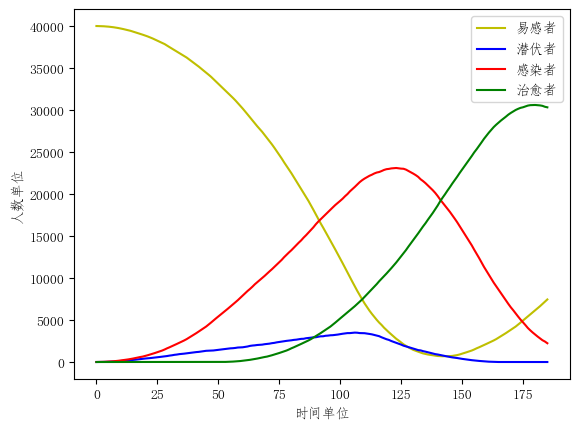

187


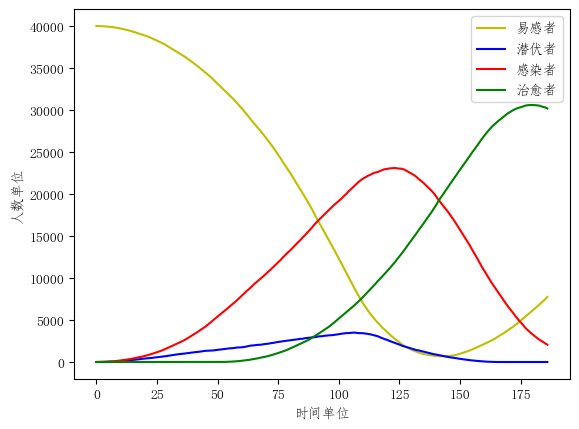

188


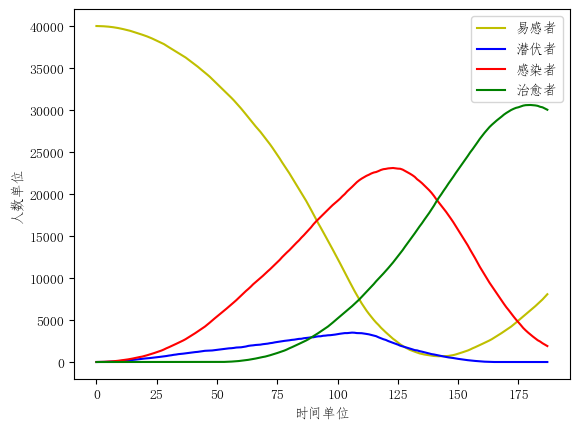

189


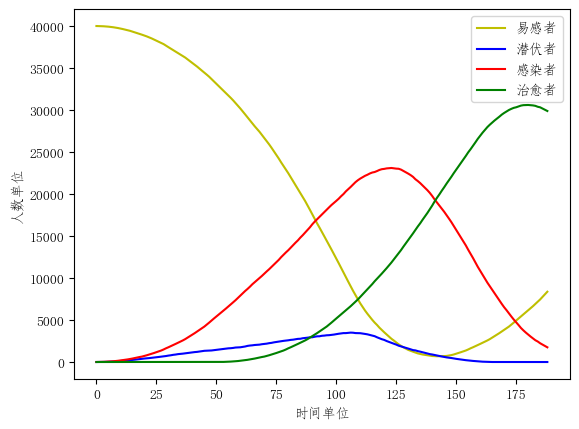

190


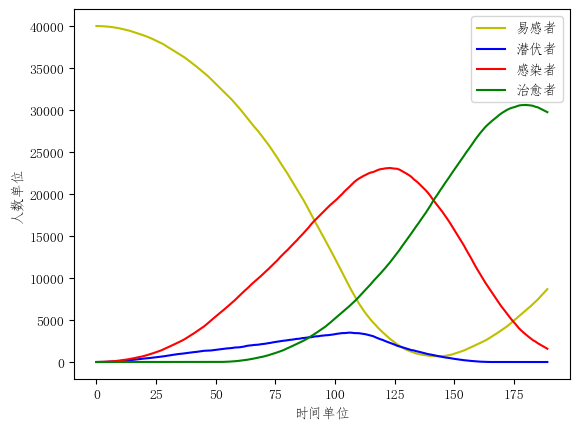

191


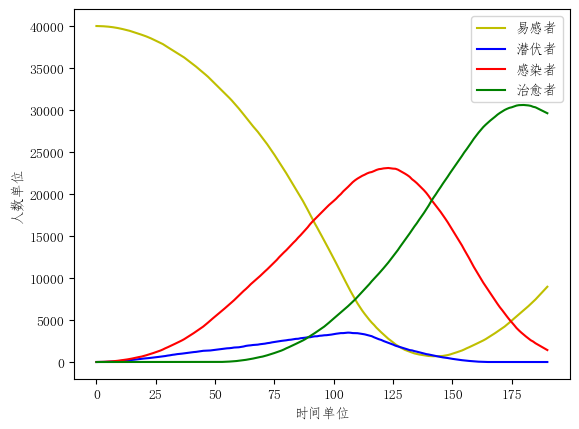

192


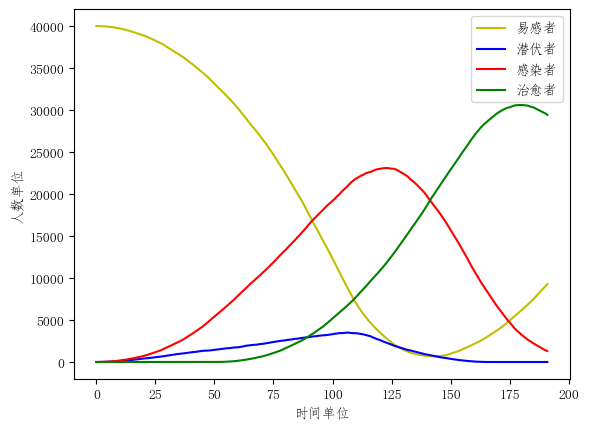

193


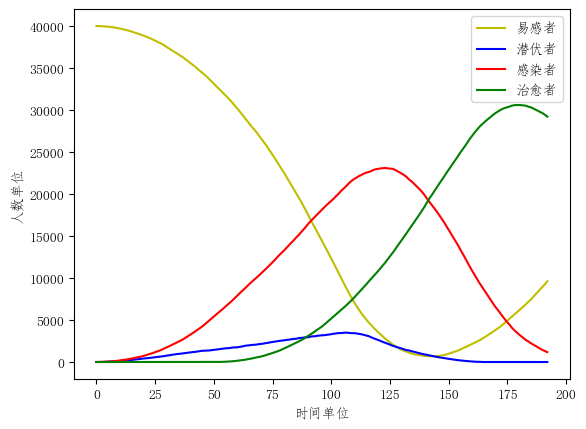

194


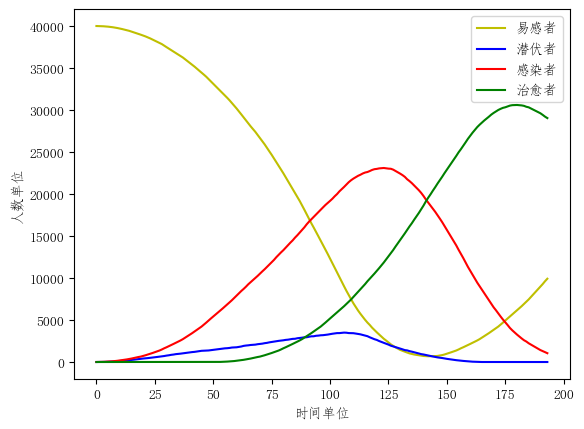

195


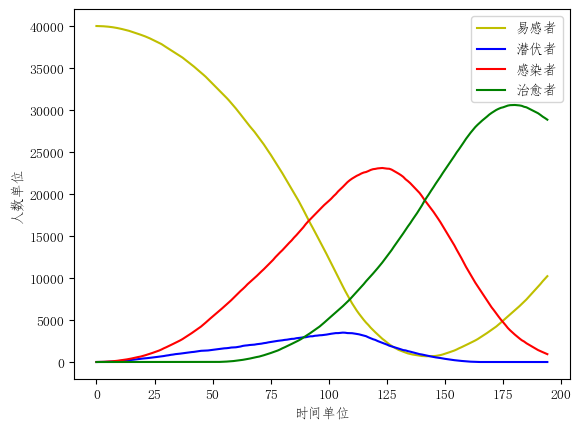

196


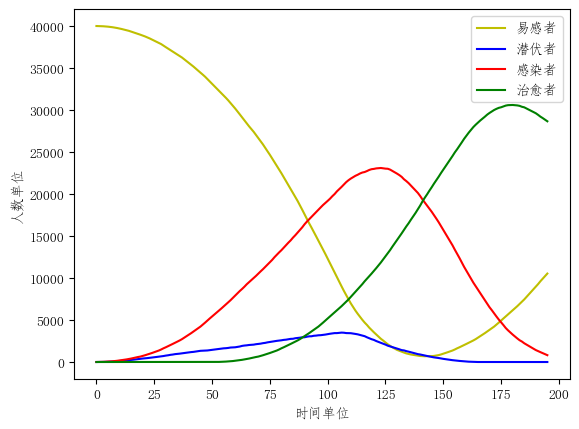

197


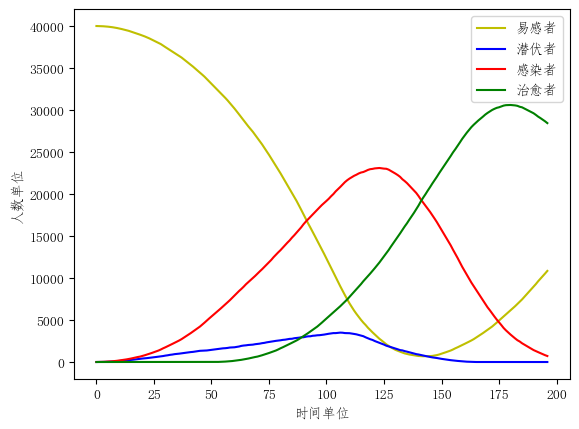

198


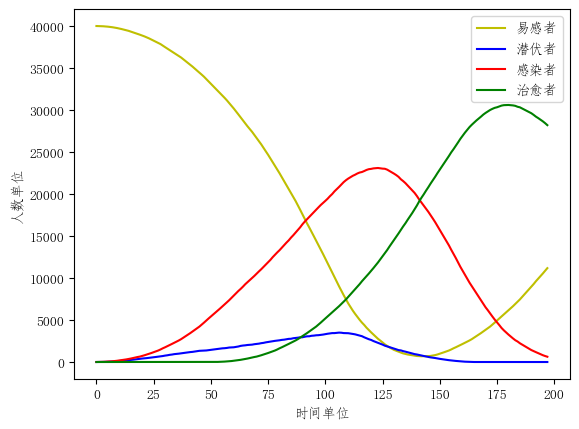

199


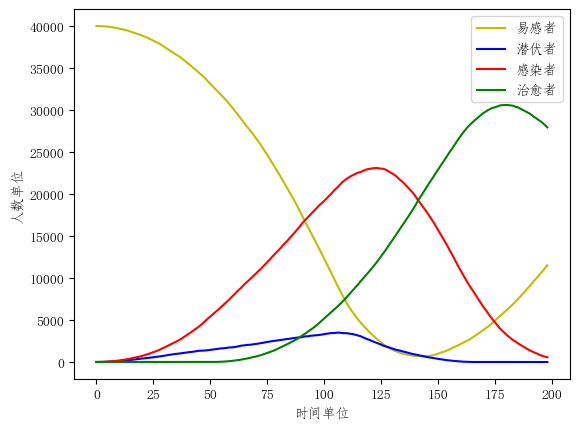

200


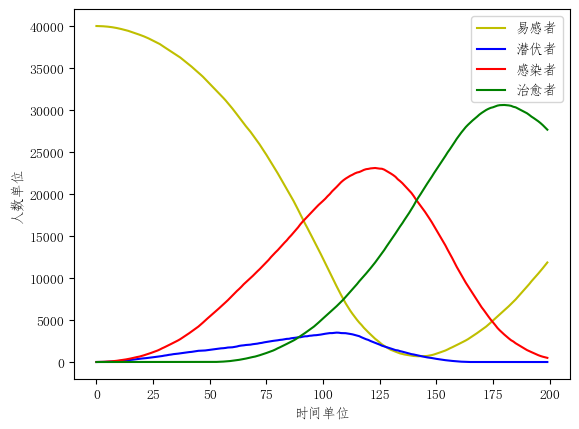

201


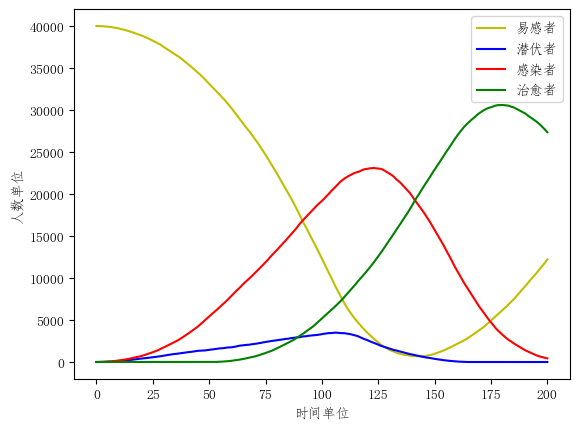

202


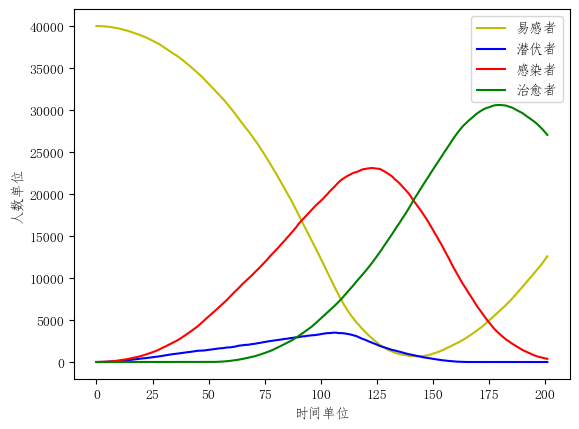

203


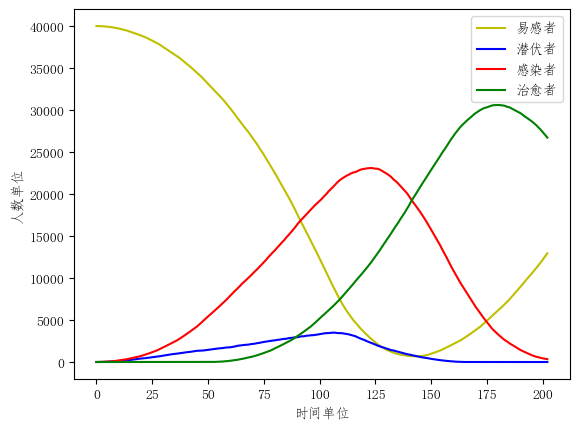

204


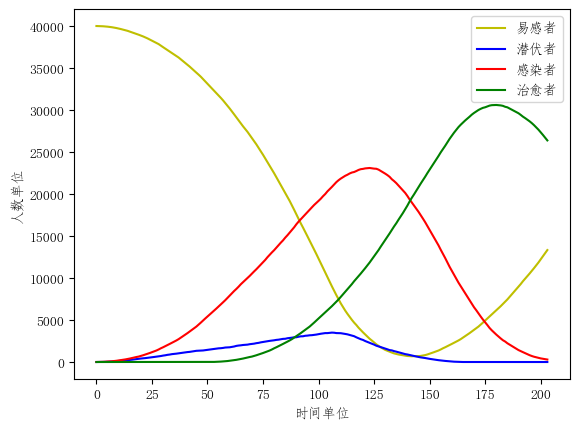

205


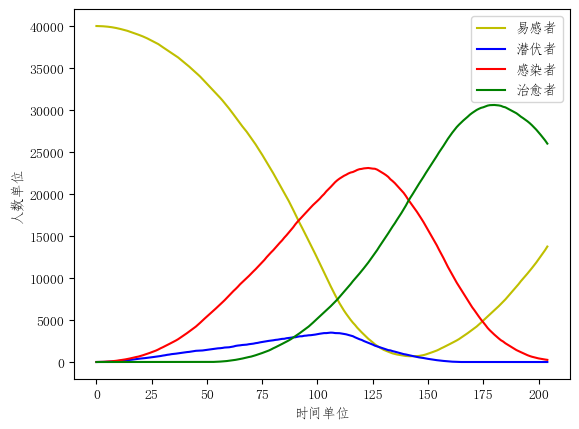

206


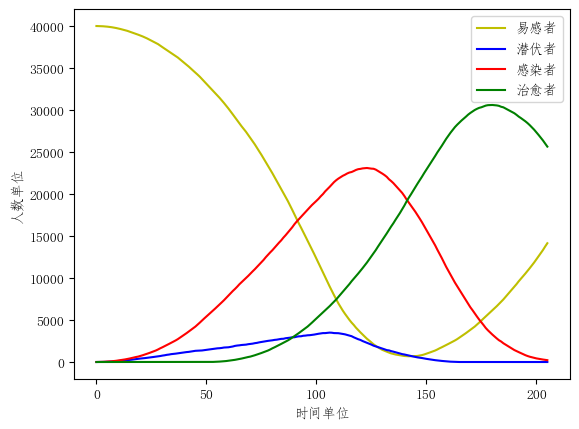

207


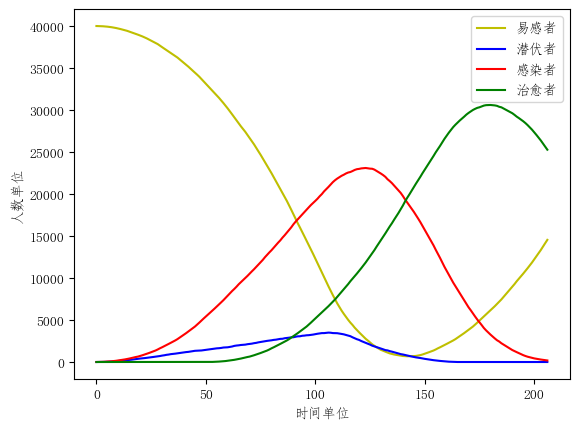

208


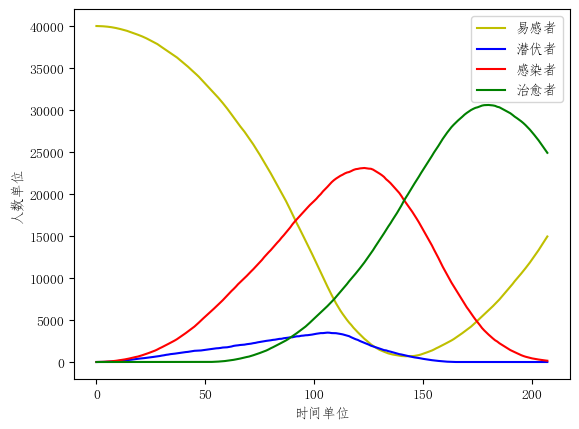

209


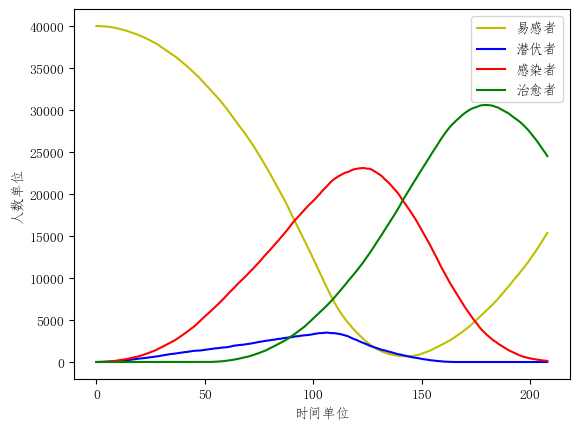

210


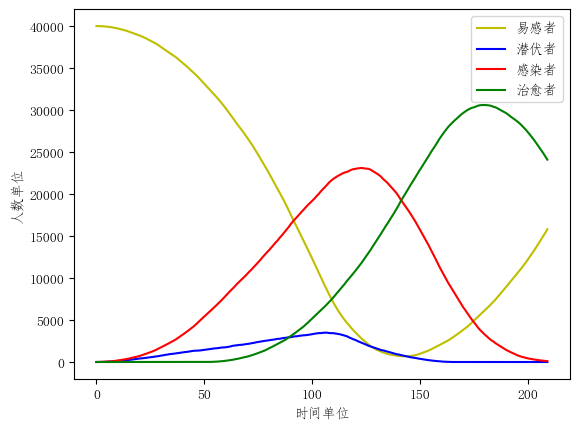

211


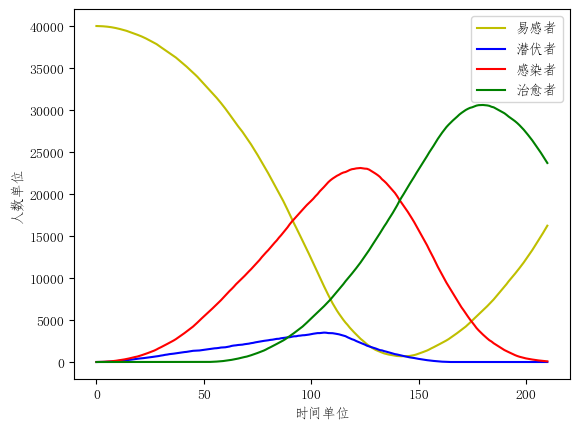

212


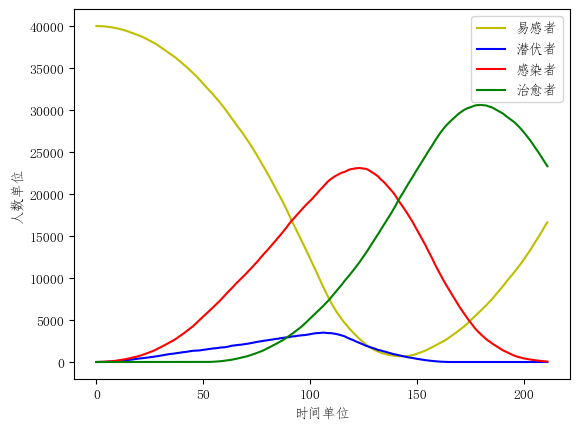

213


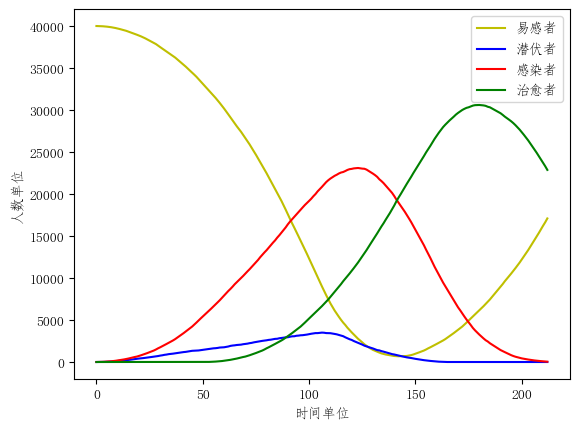

214


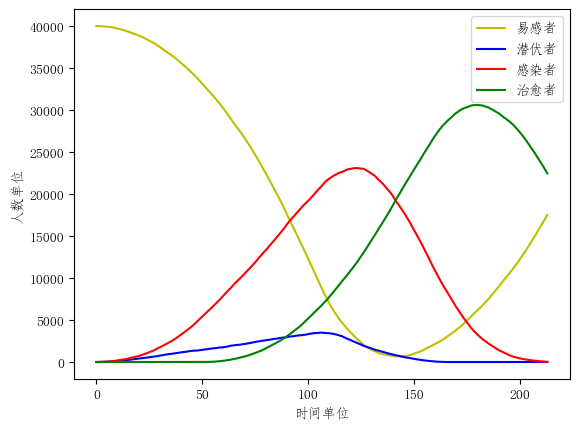

215


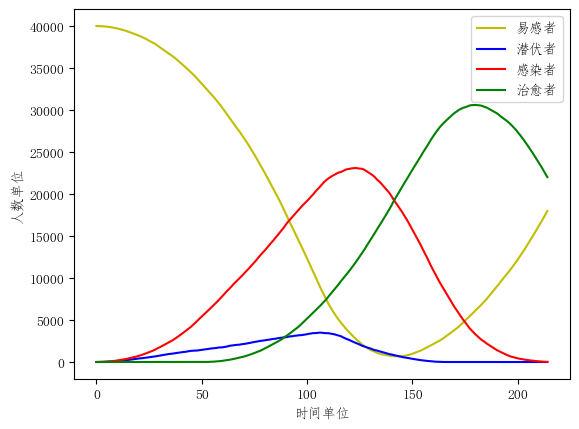

216


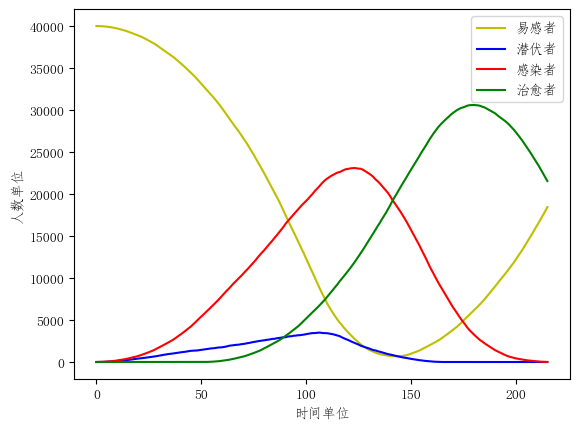

217


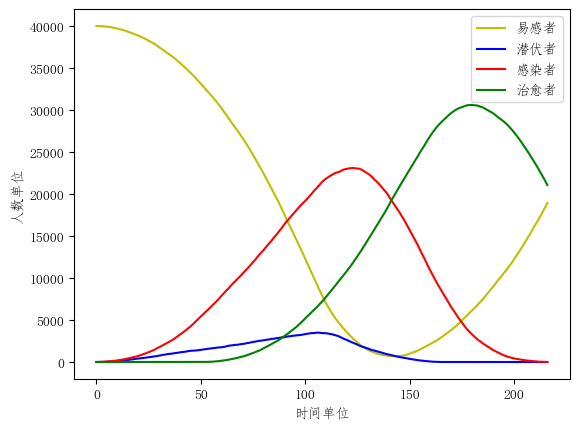

218


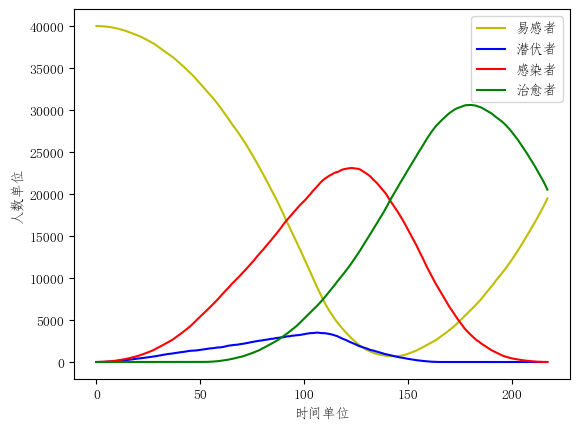

219


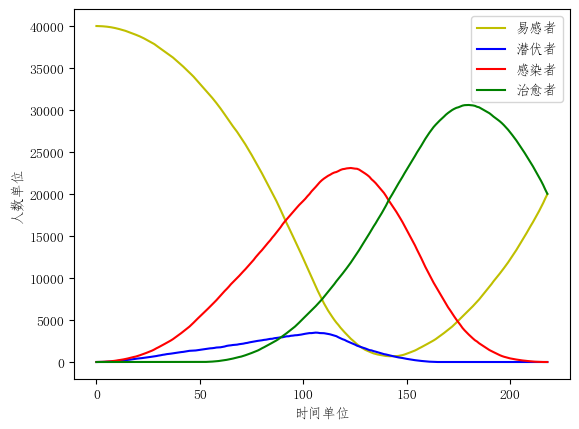

220


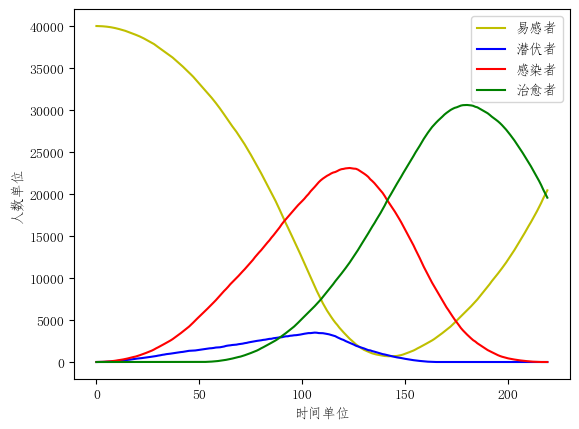

221


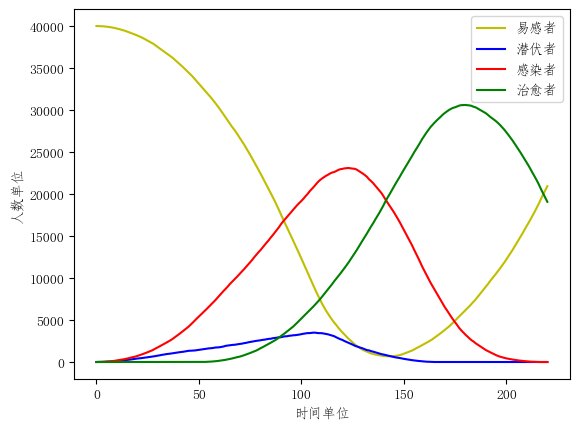

222


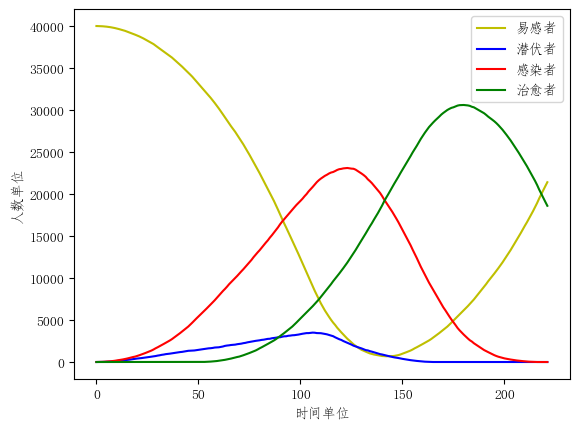

223


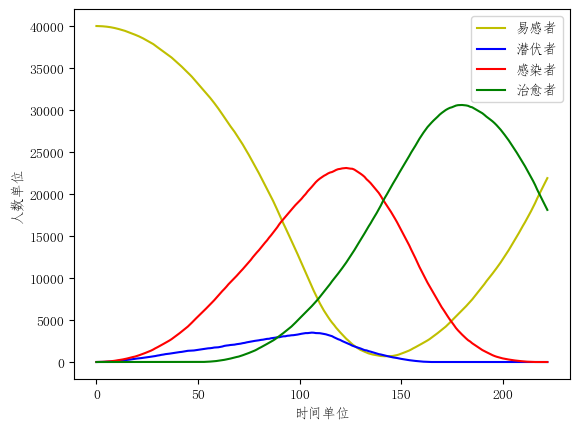

224


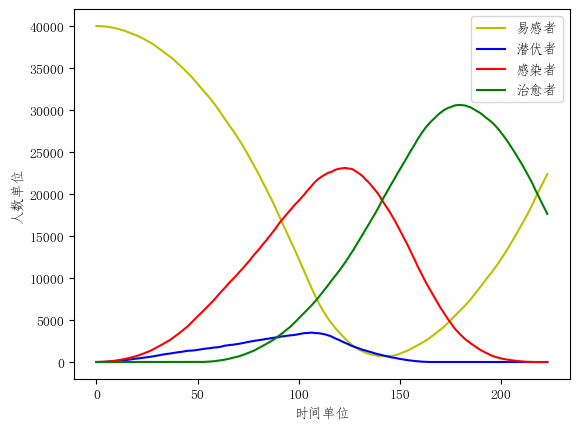

225


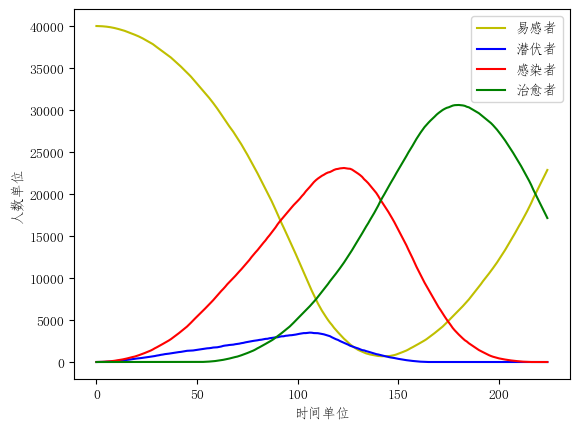

226


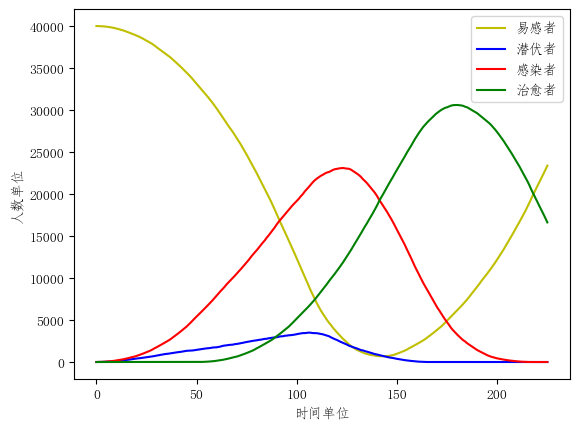

227


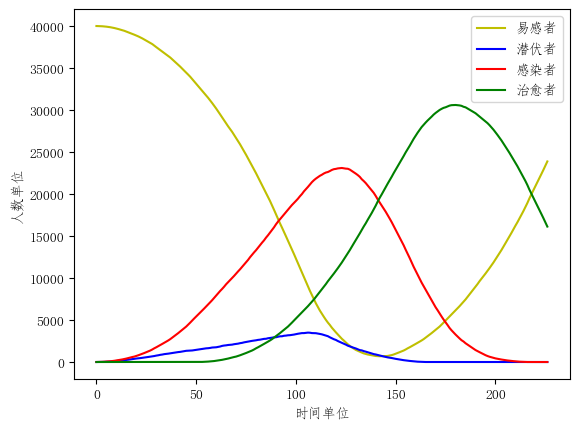

228


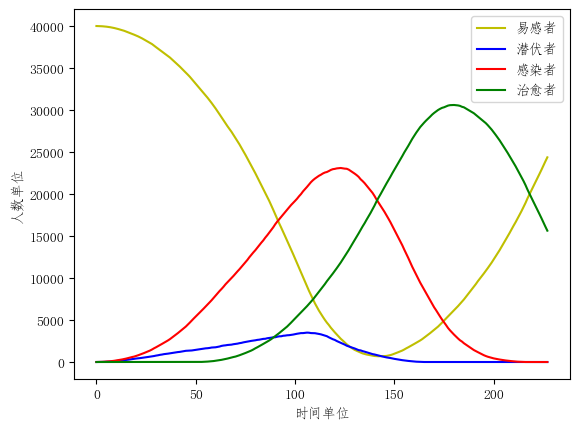

229


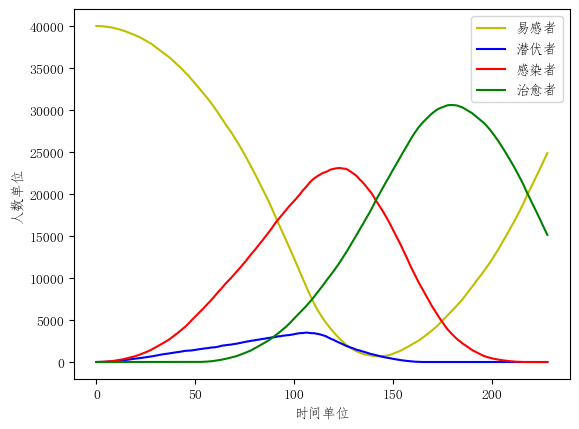

230


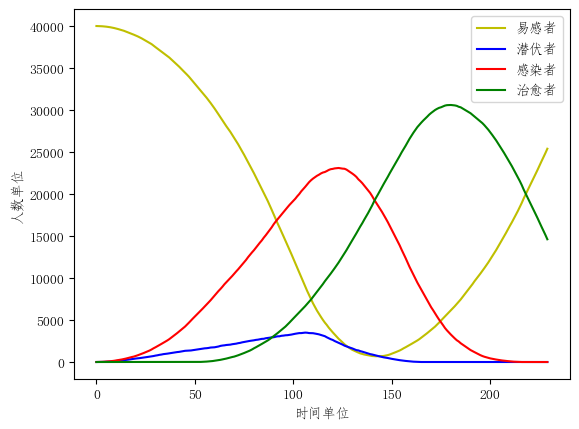

231


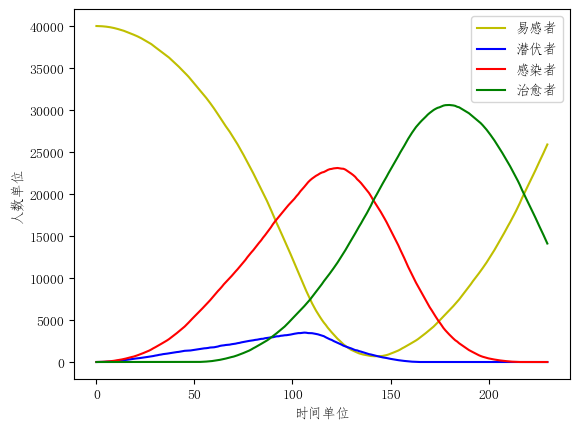

232


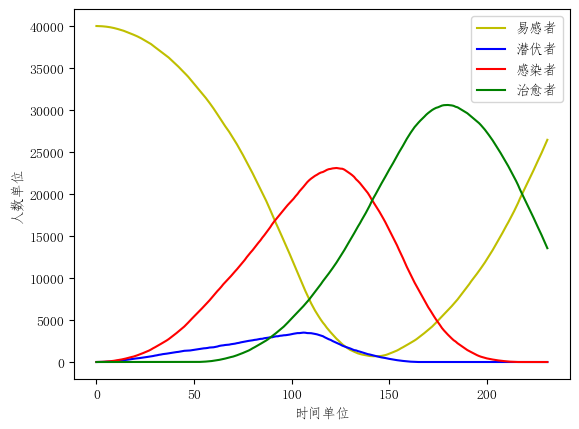

233


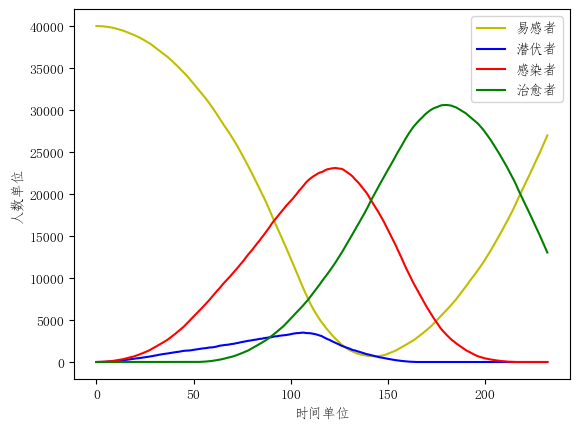

234


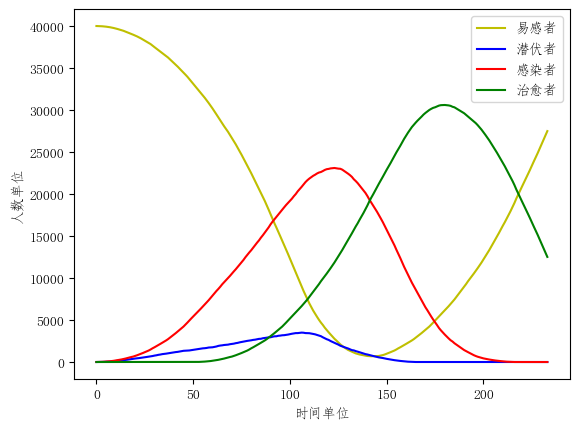

235


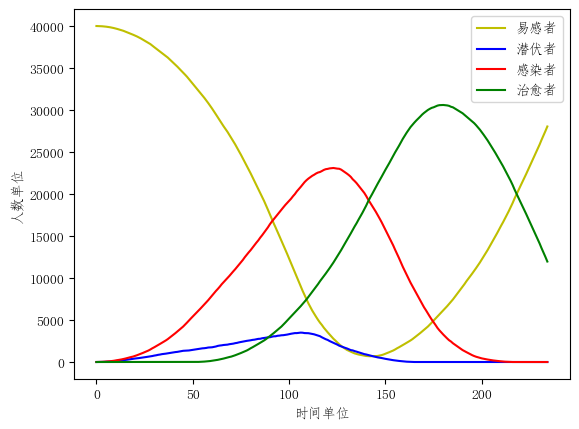

236


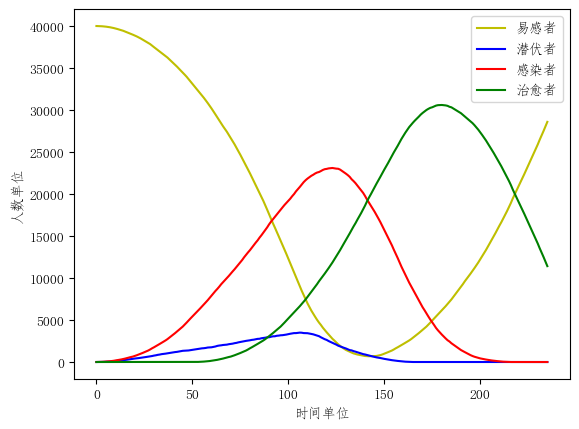

237


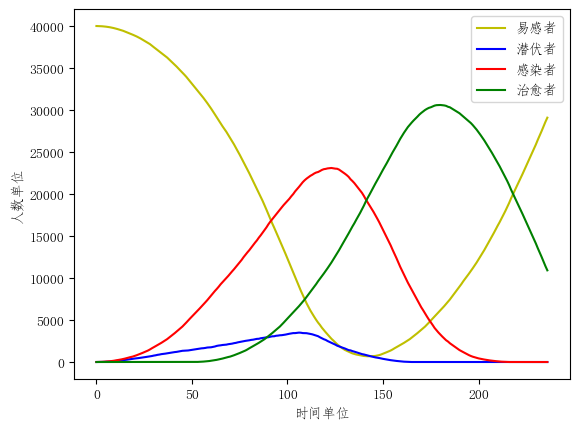

238


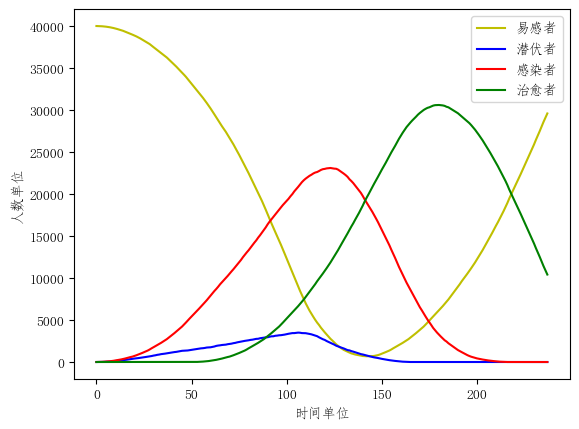

239


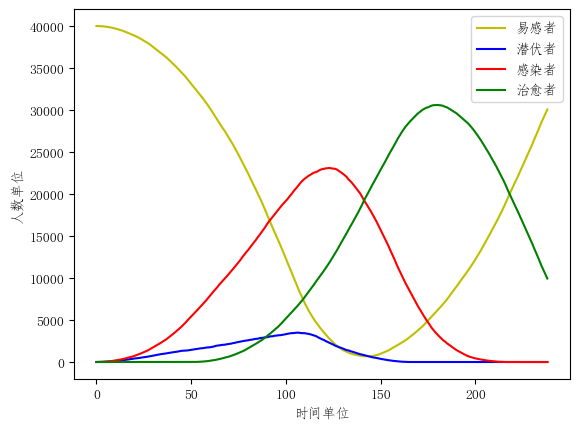

240


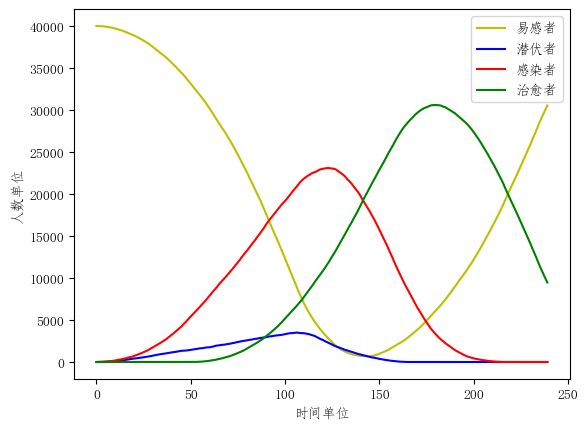

241


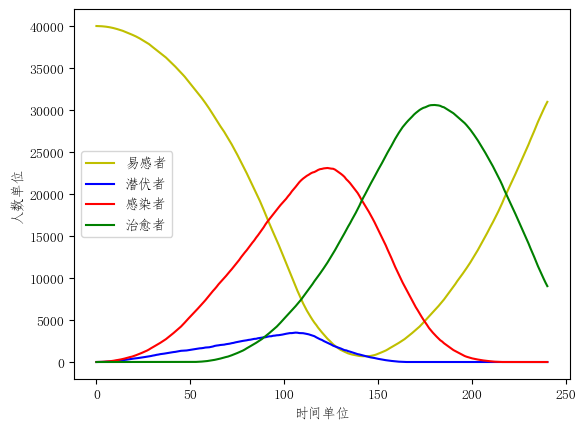

242


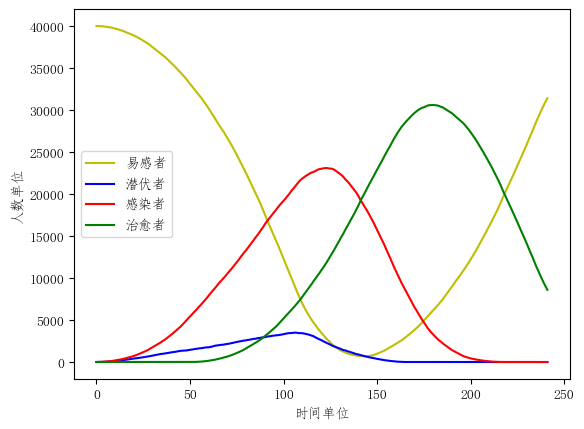

243


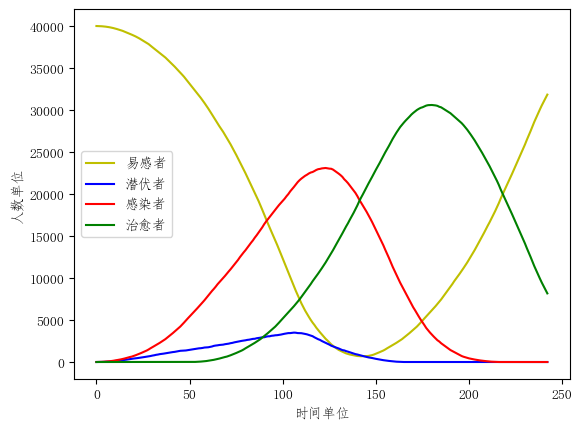

244


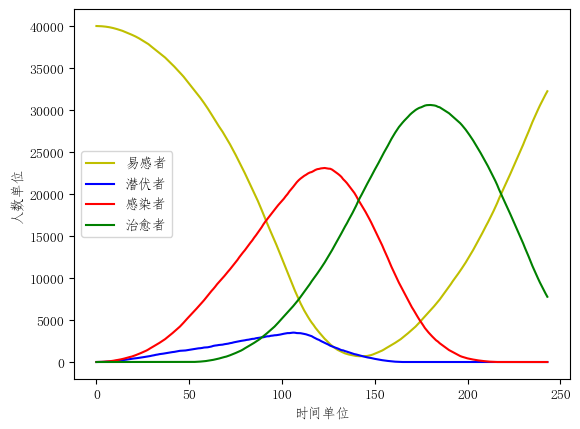

245


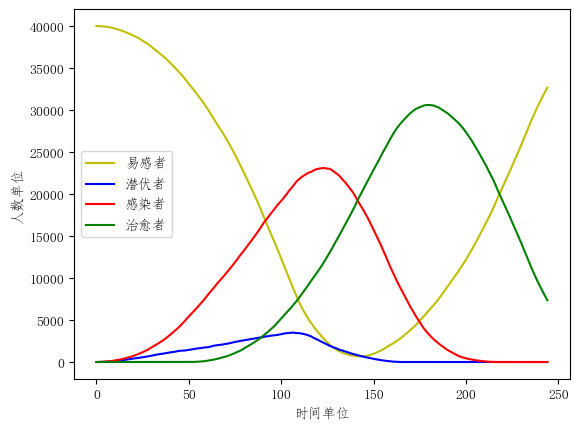

246


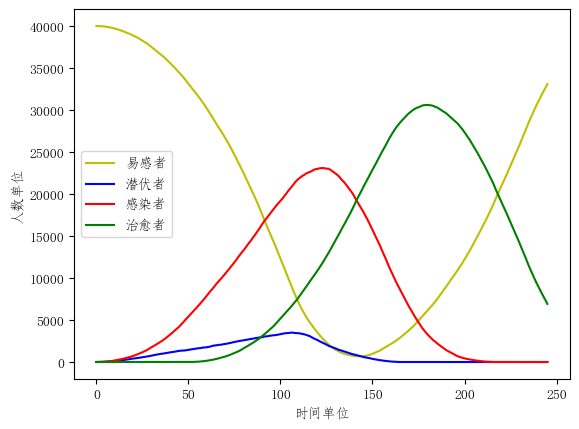

247


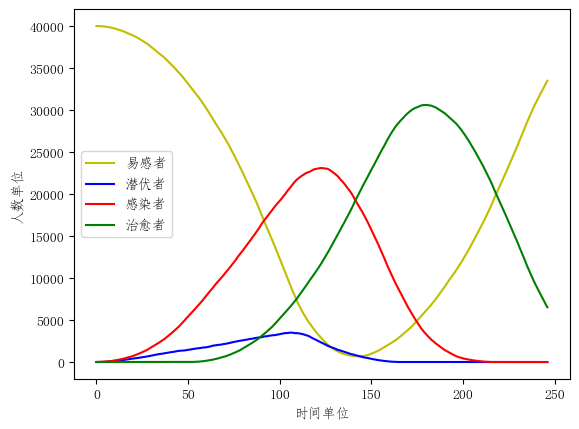

248


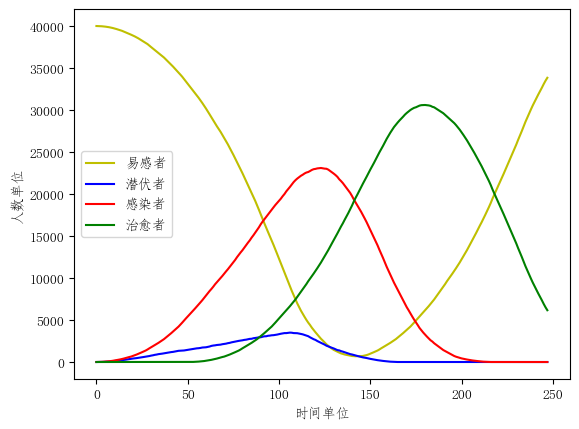

249


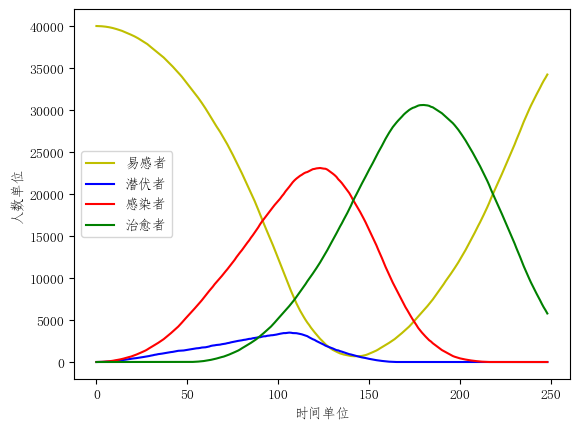

250


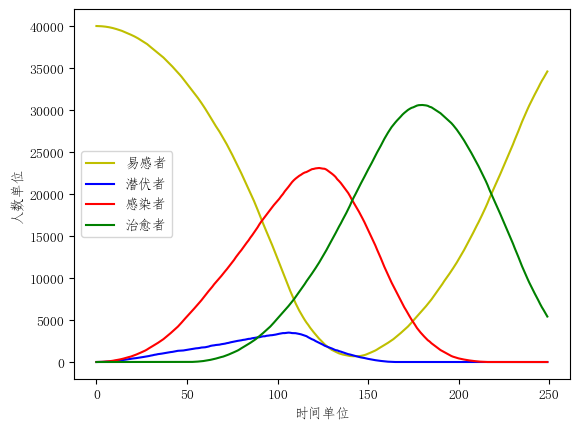

251


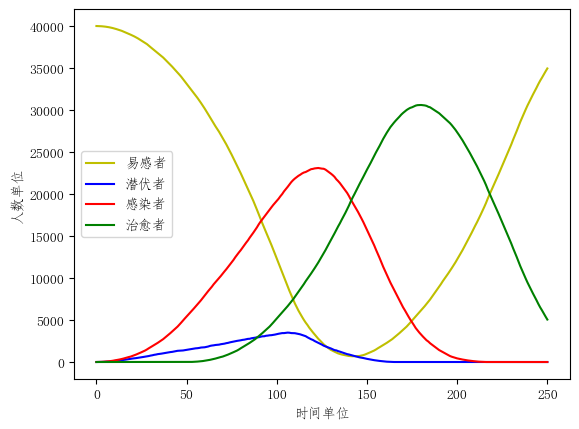

252


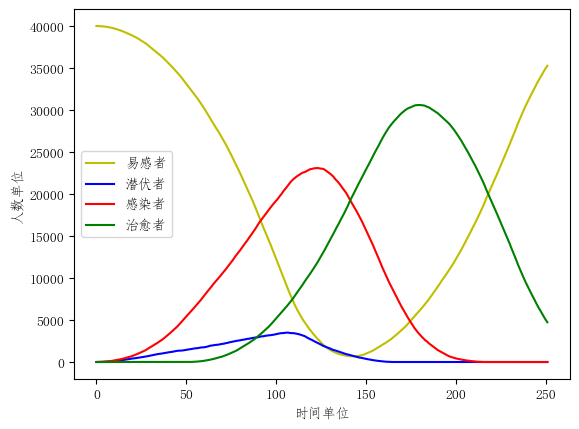

253


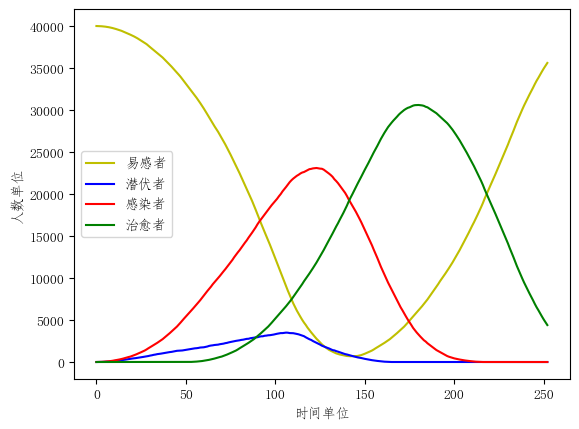

254


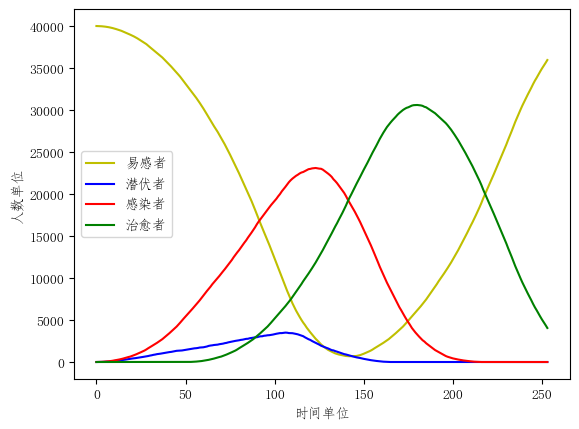

255


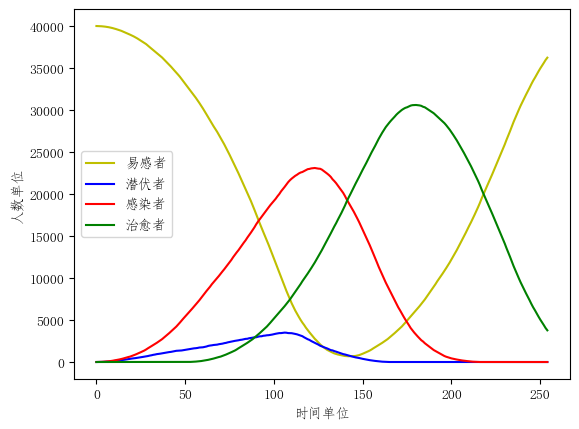

256


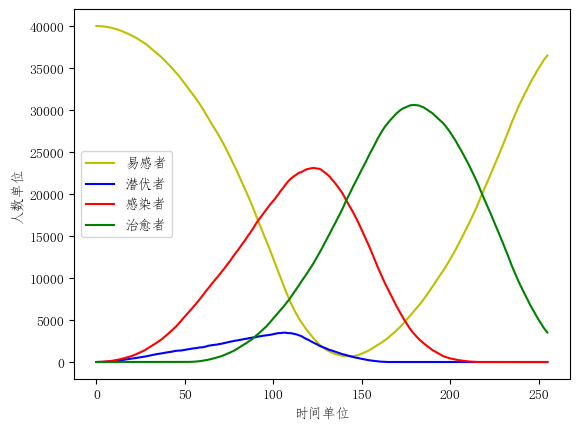

257


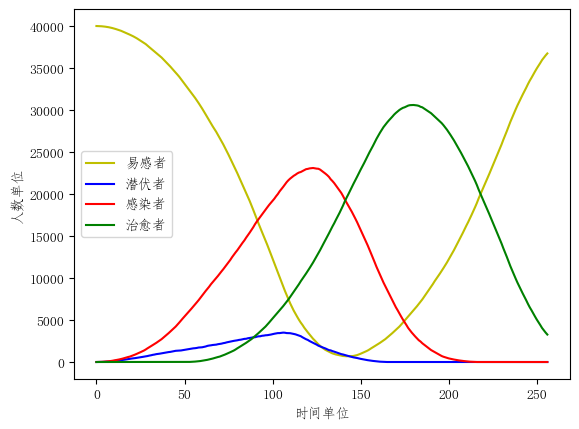

258


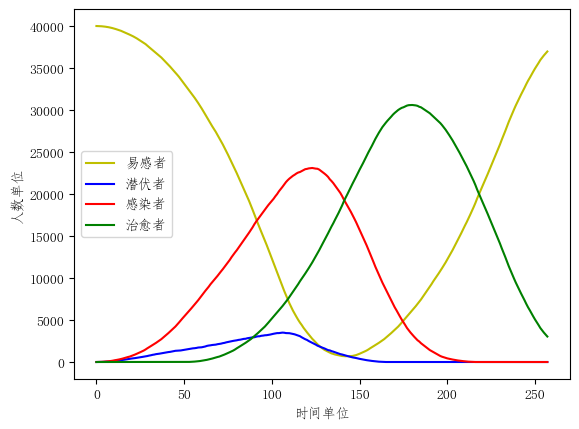

259


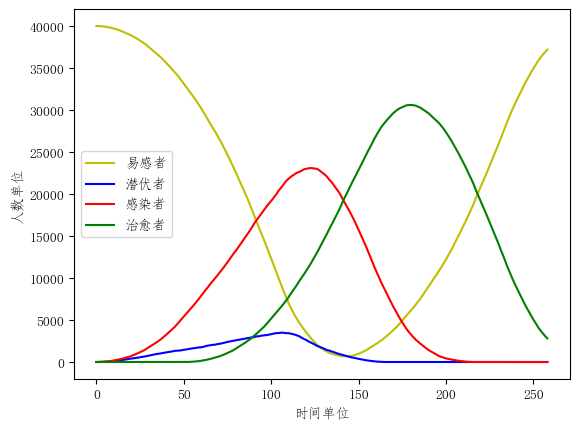

260


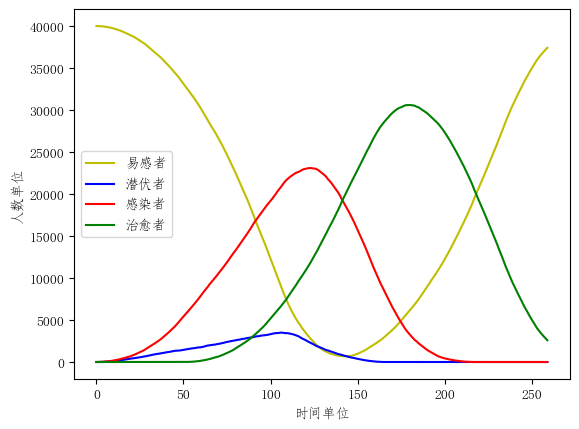

261


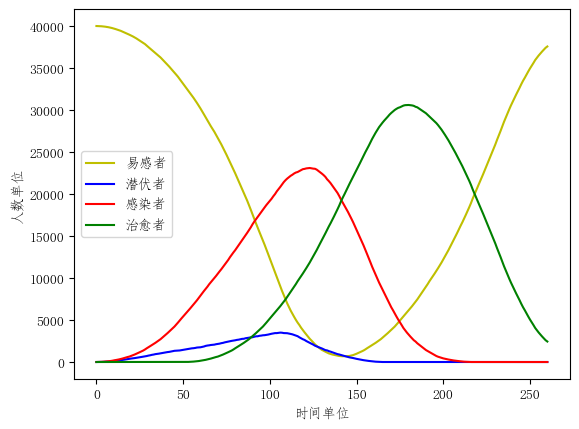

262


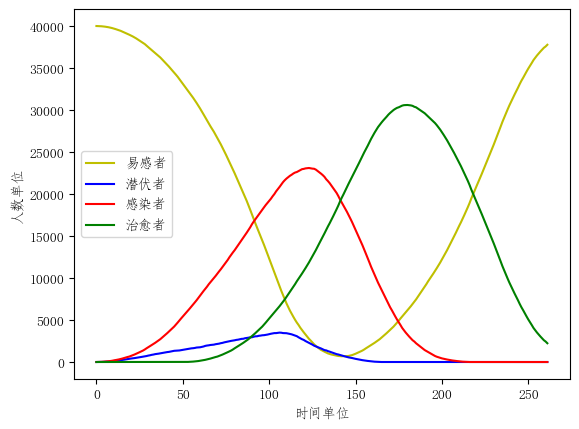

263


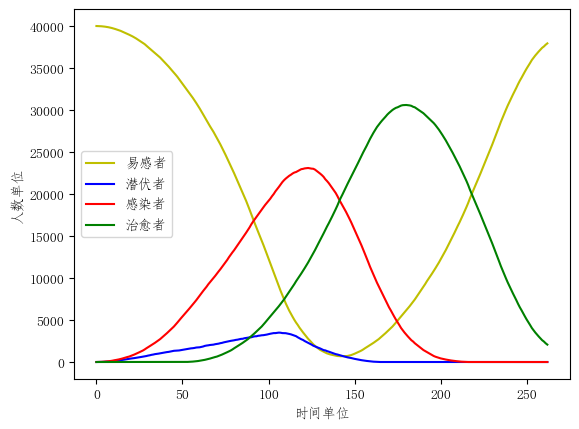

264


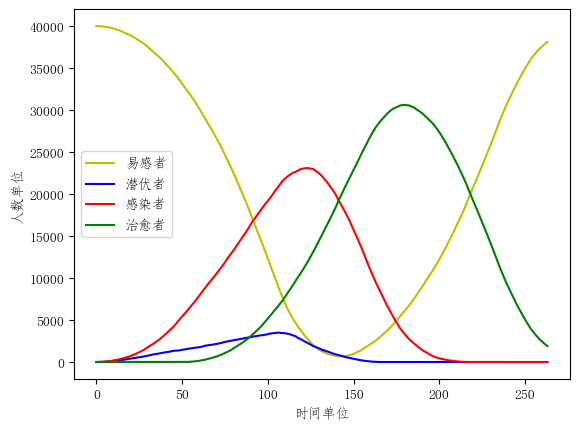

265


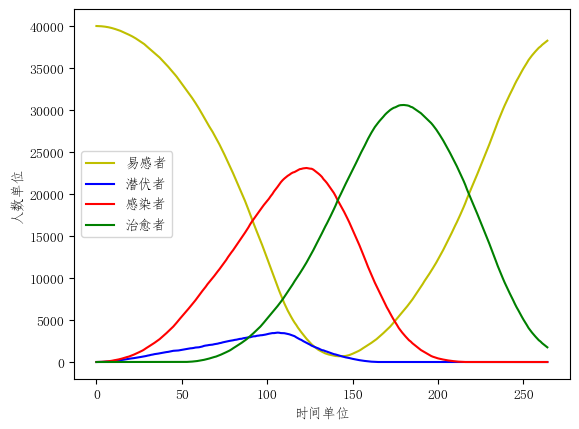

266


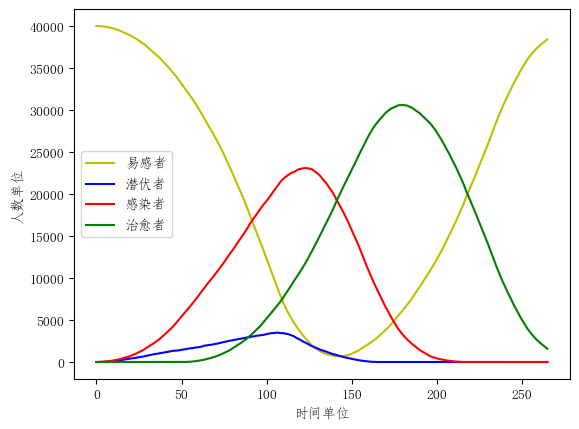

267


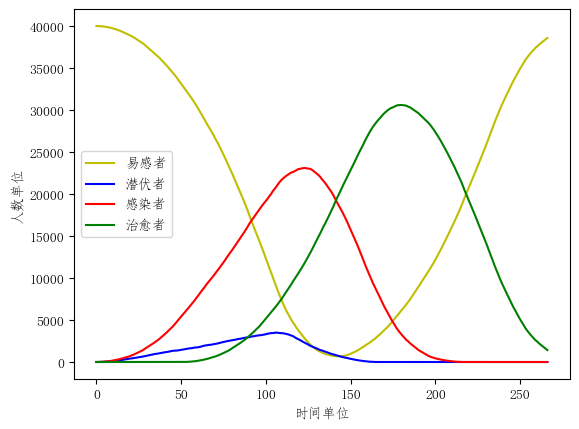

268


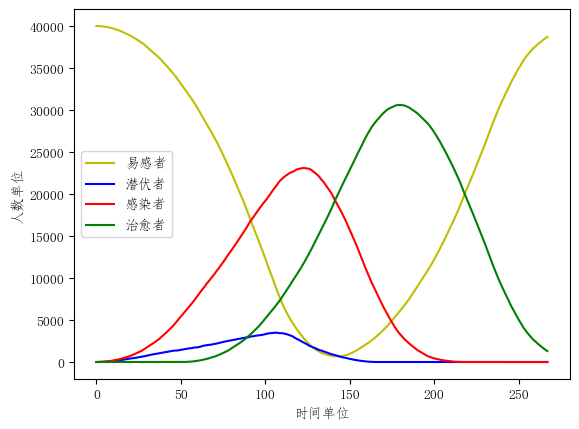

269


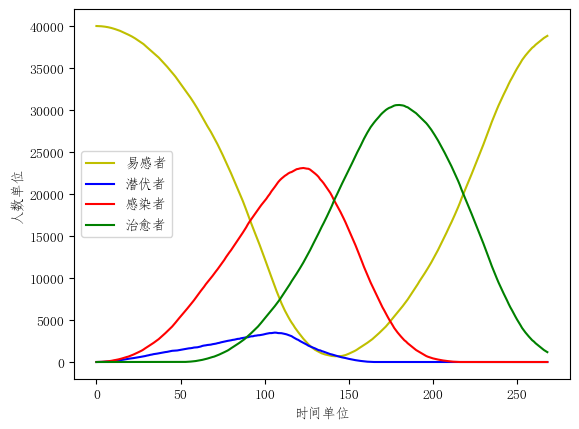

270


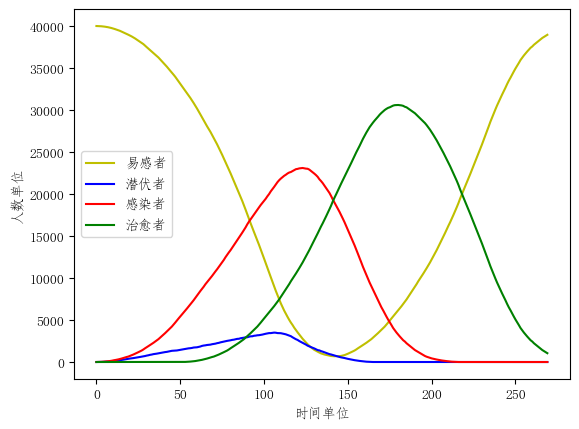

271


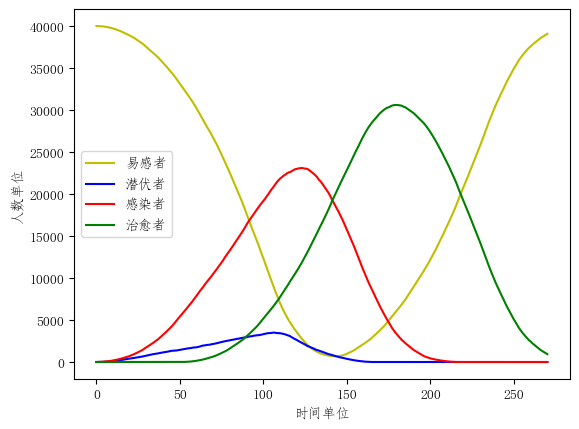

272


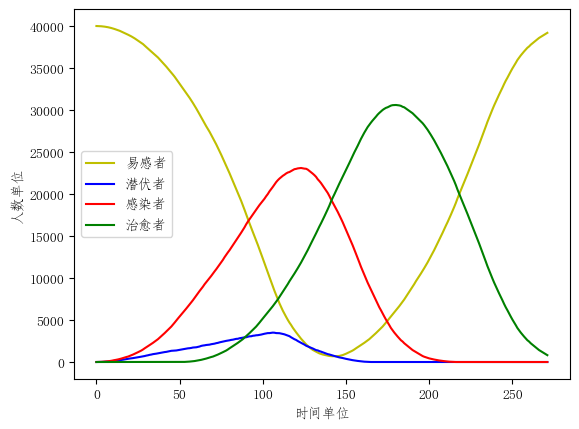

273


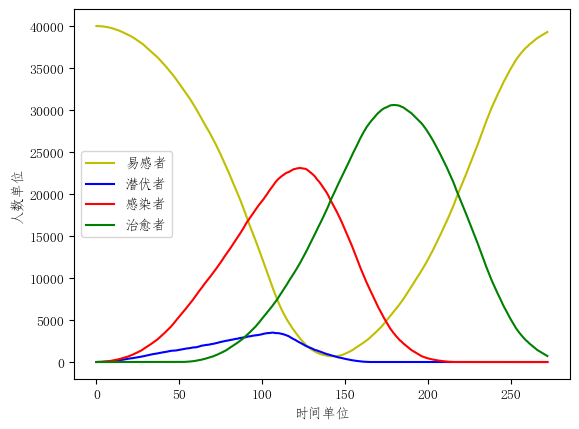

274


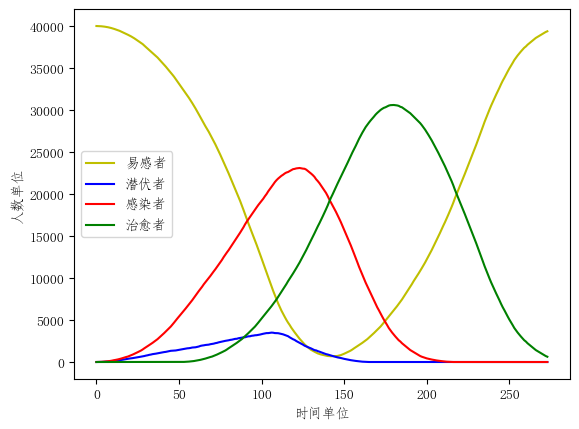

275


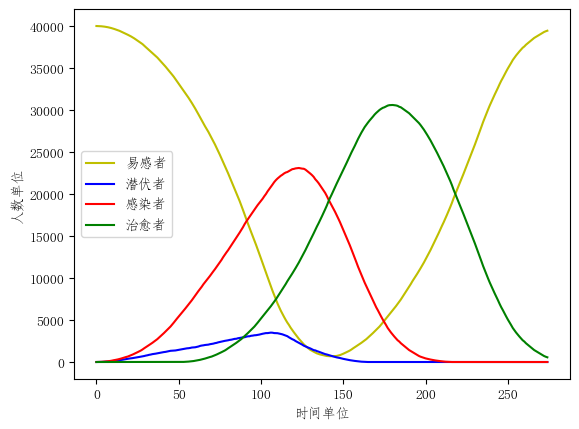

276


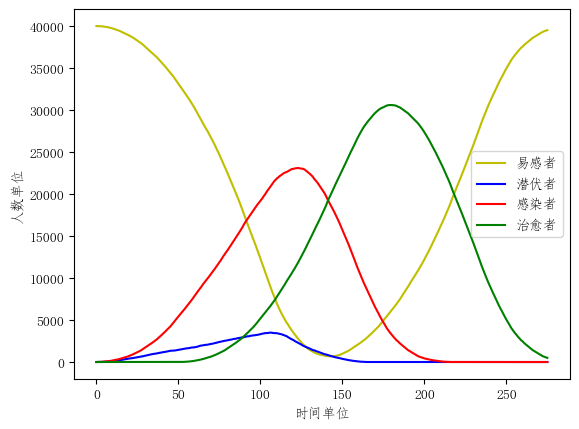

277


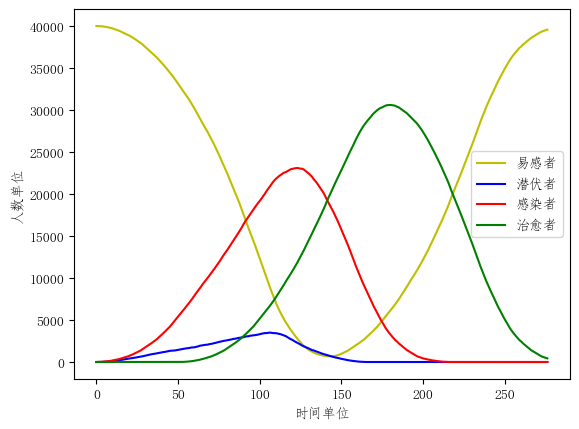

278


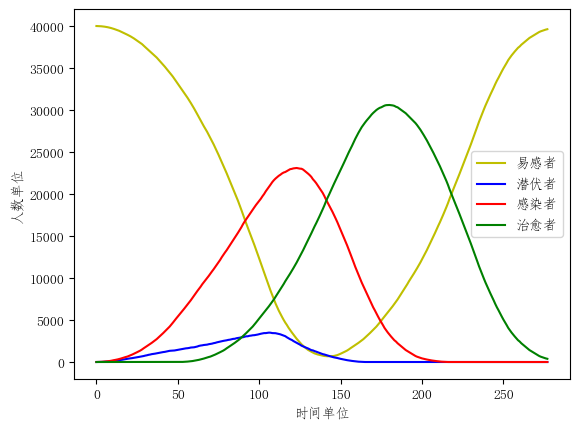

279


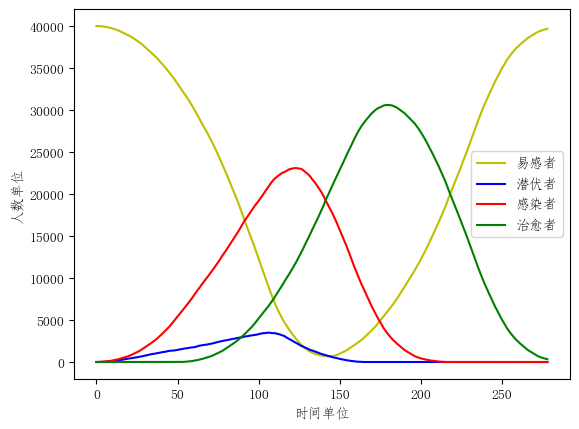

280


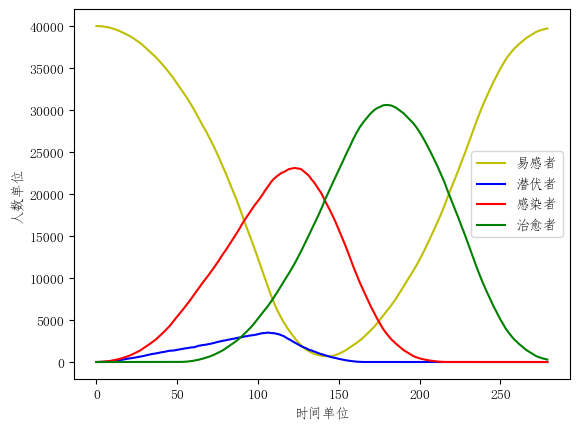

281


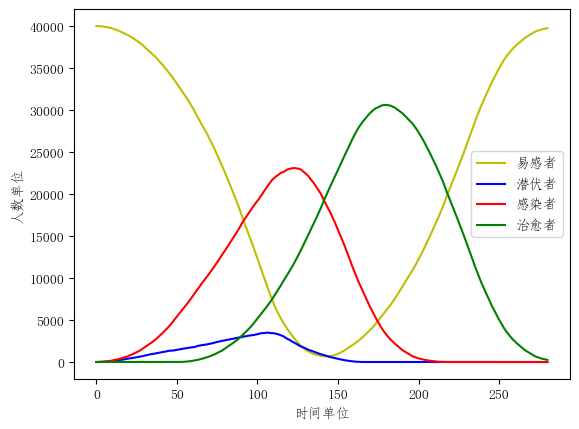

282


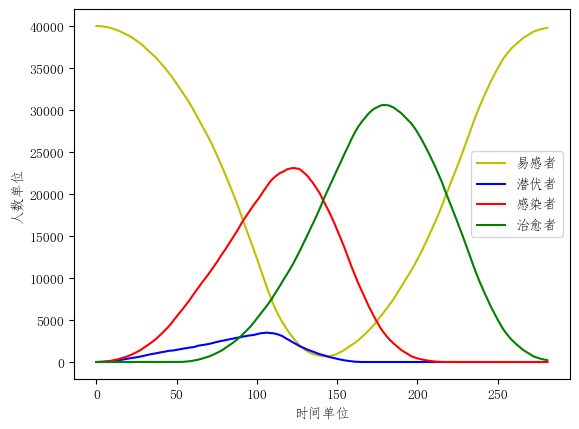

283


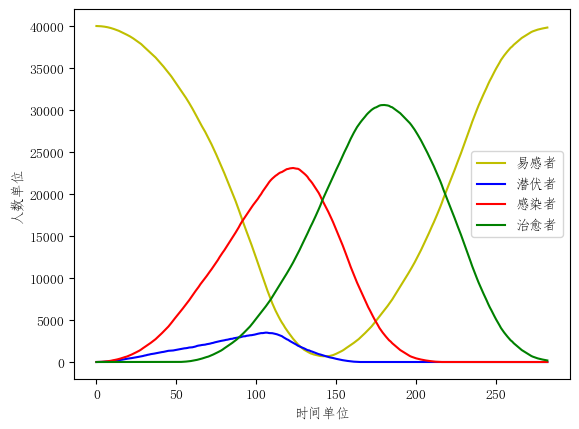

284


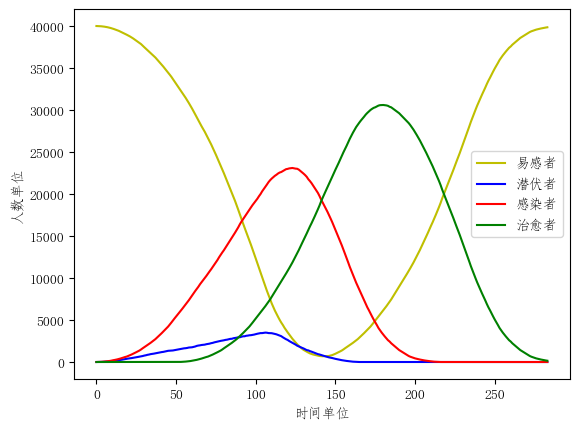

285


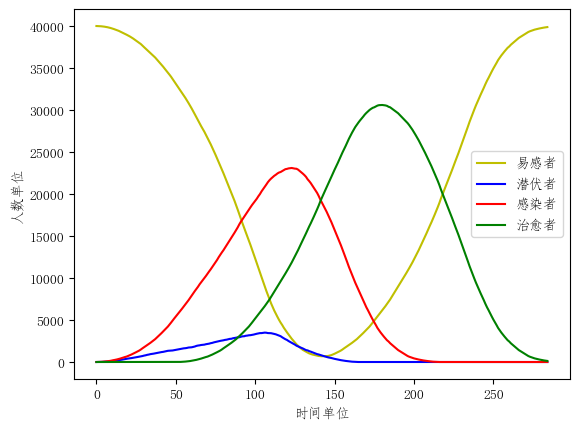

286


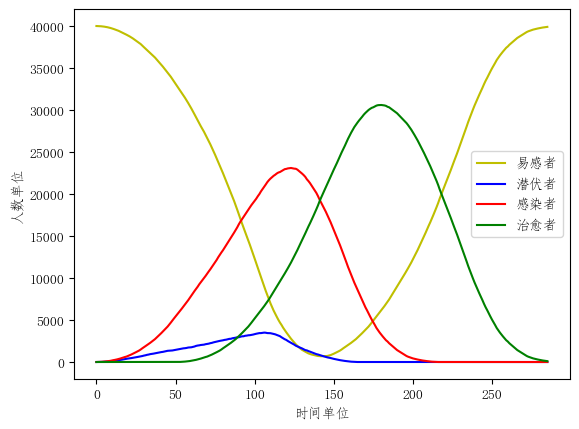

287


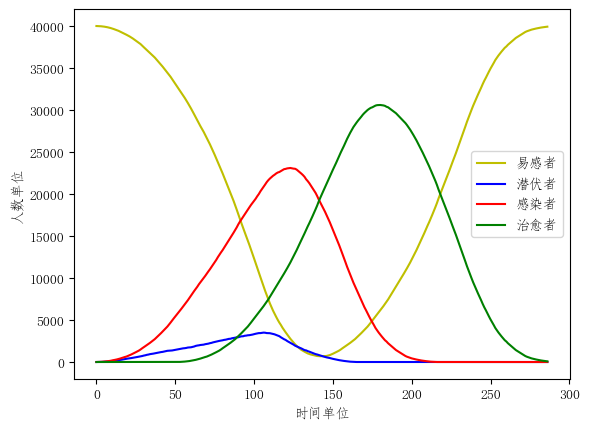

288


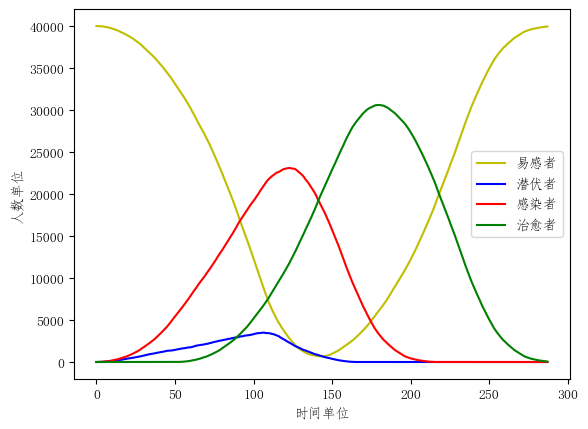

289


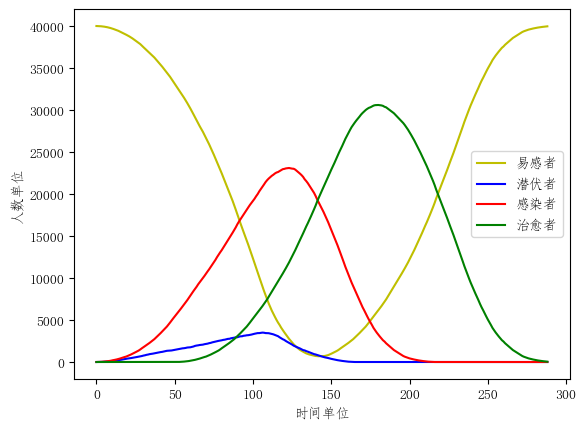

290


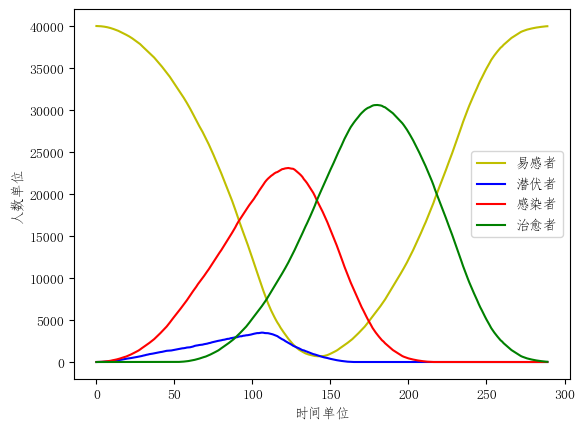

291


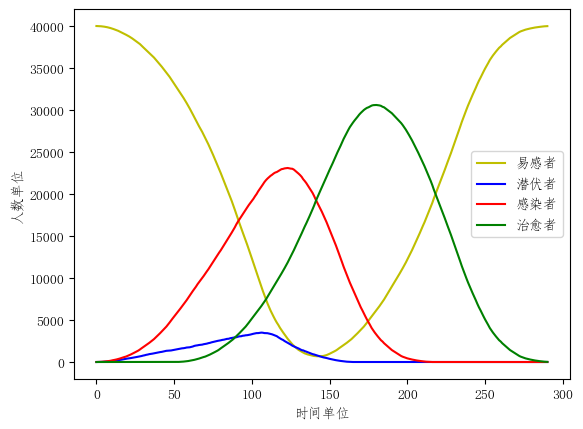

292


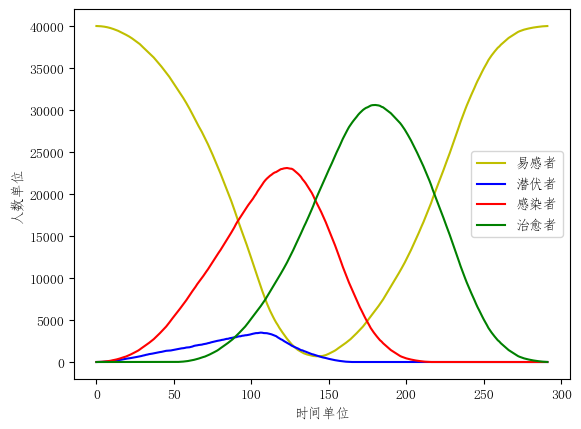

293


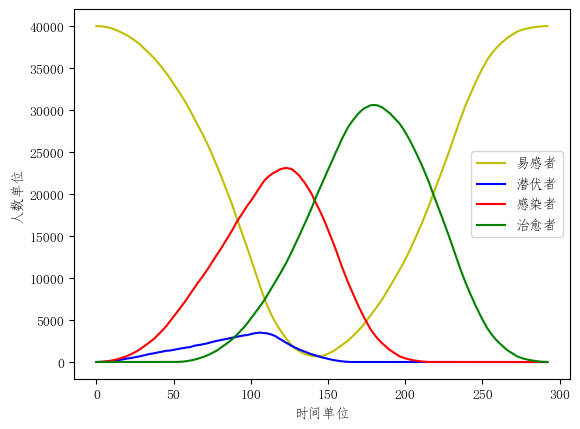

294


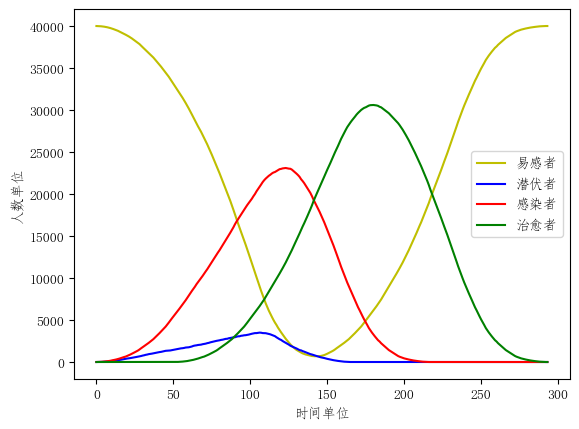

295


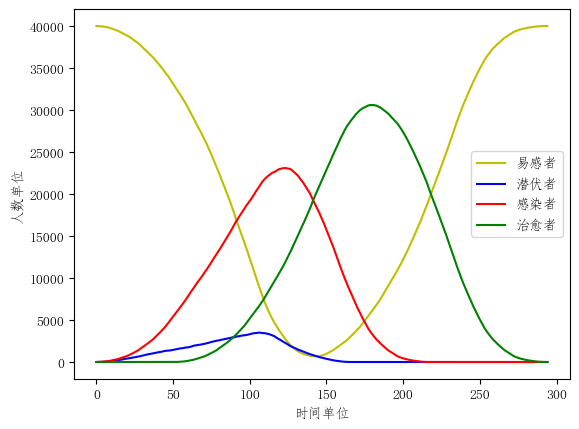

296


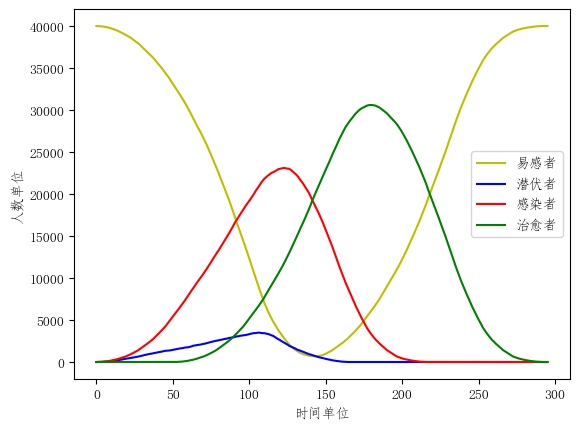

297


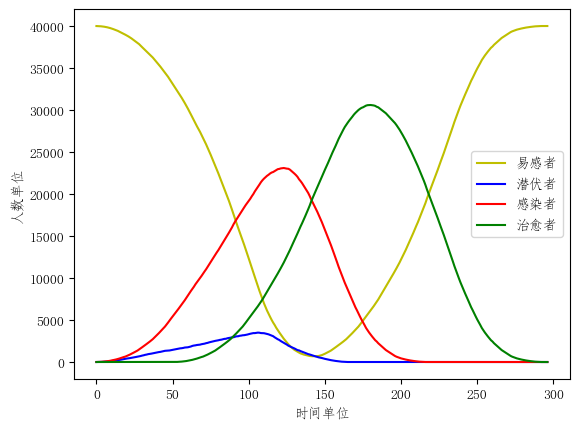

298


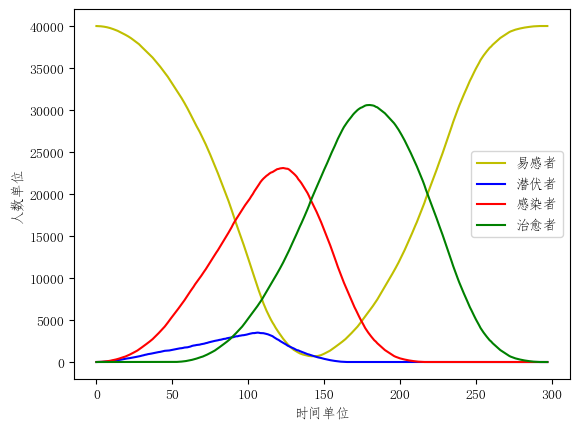

299


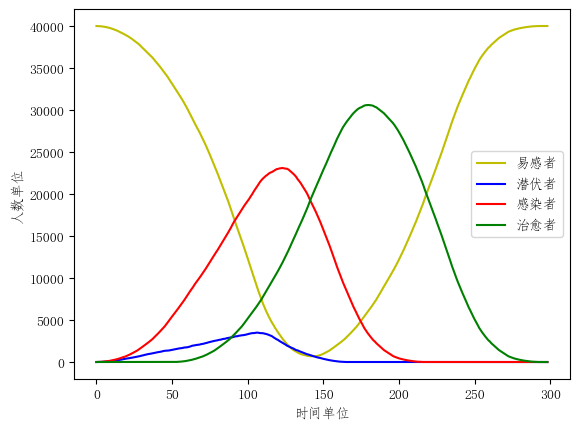

300


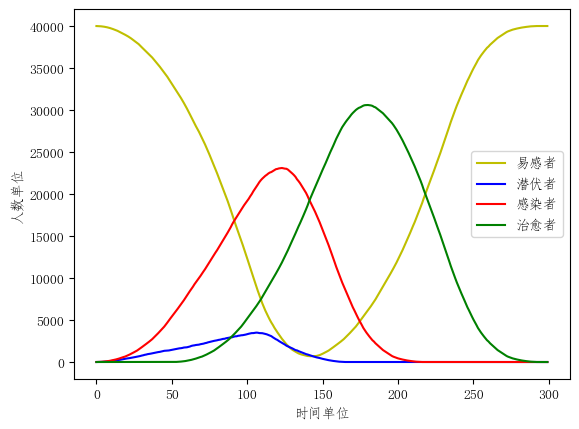

301


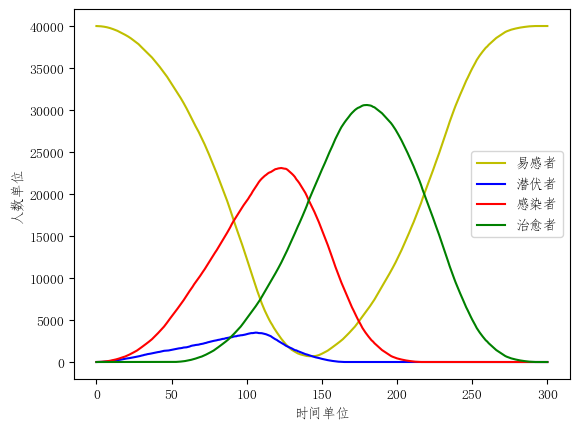

302


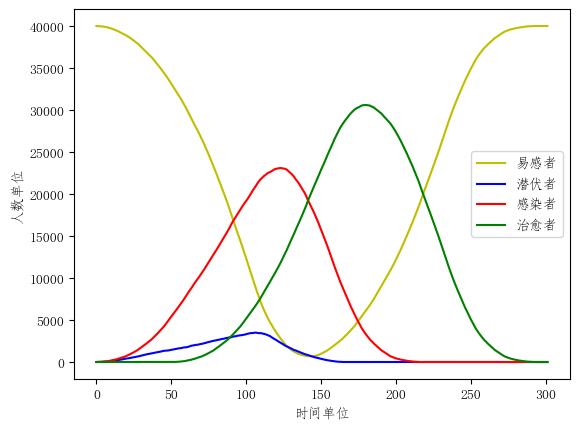

303


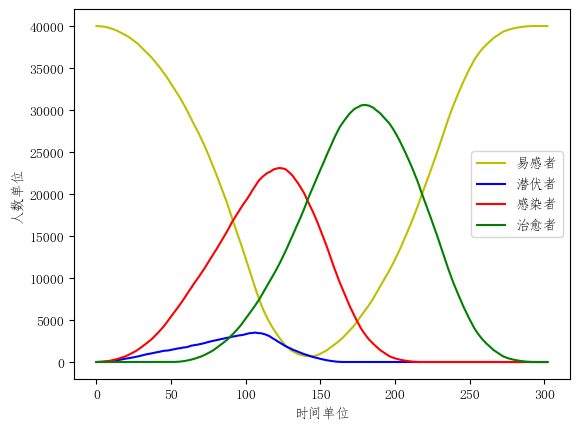

304


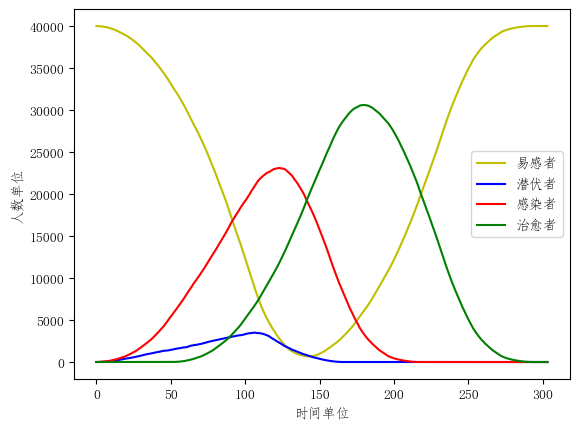

305


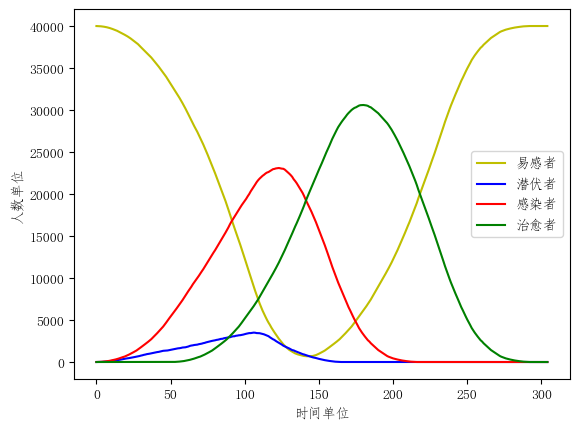

306


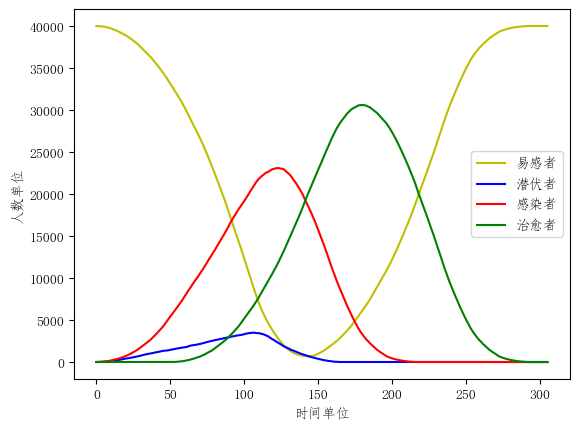

307


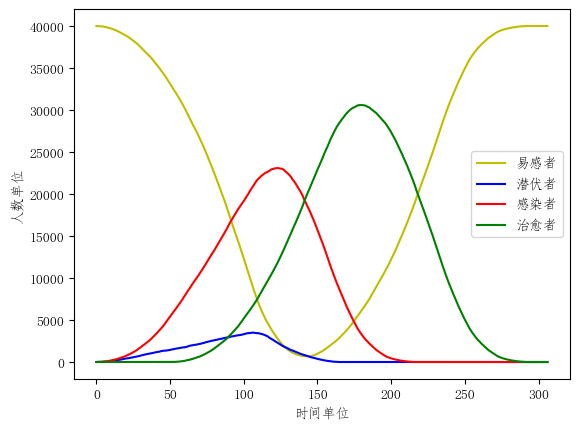

308


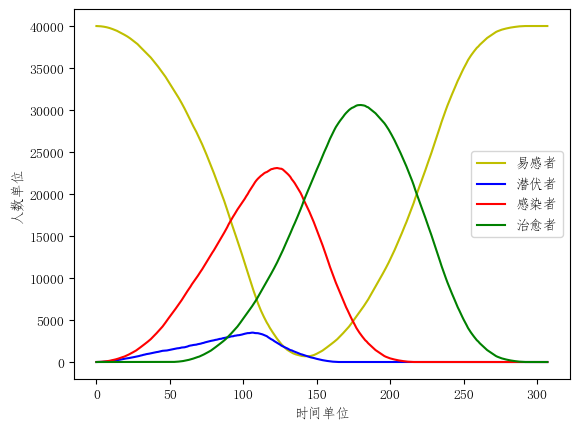

309


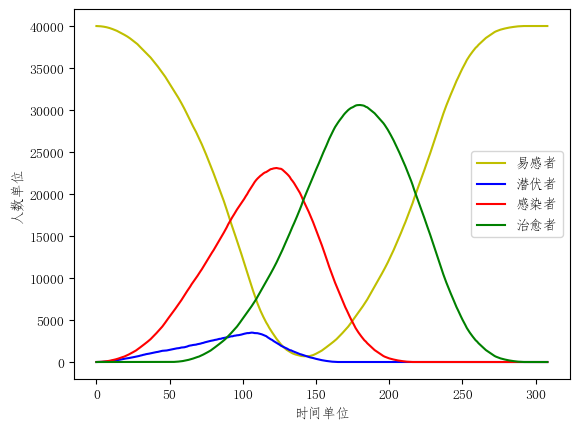

310


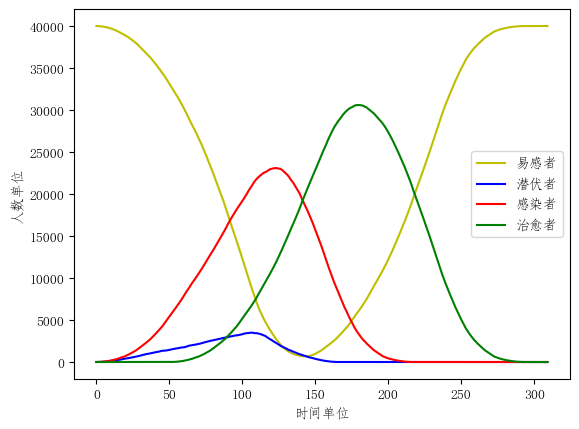

311


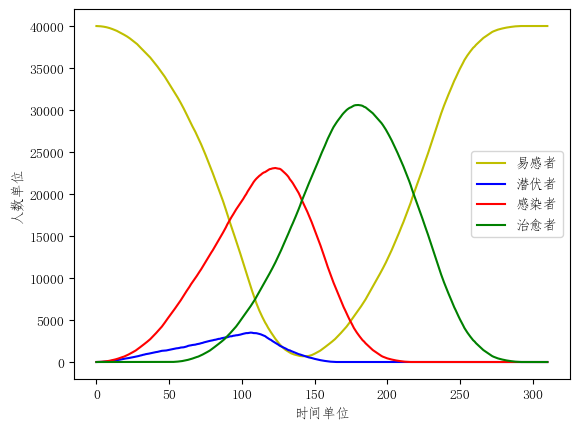

312


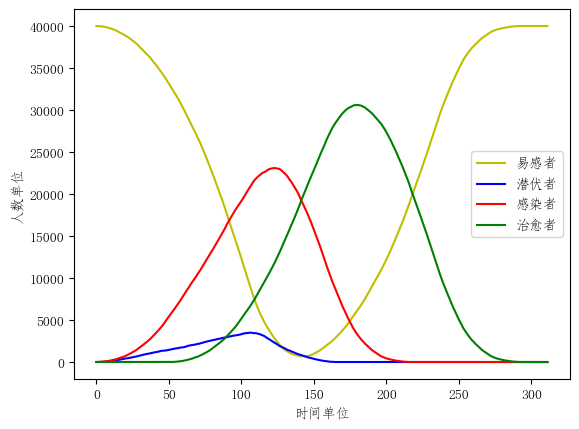

313


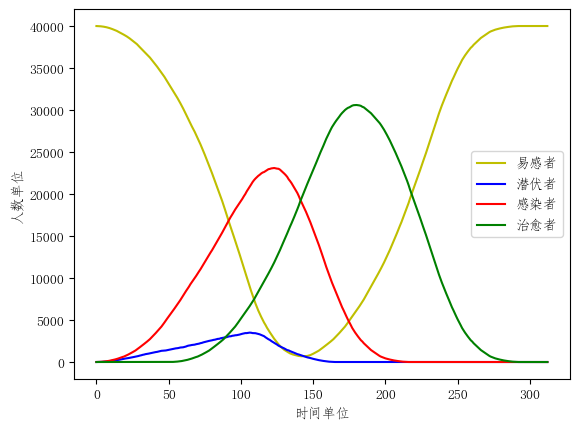

314


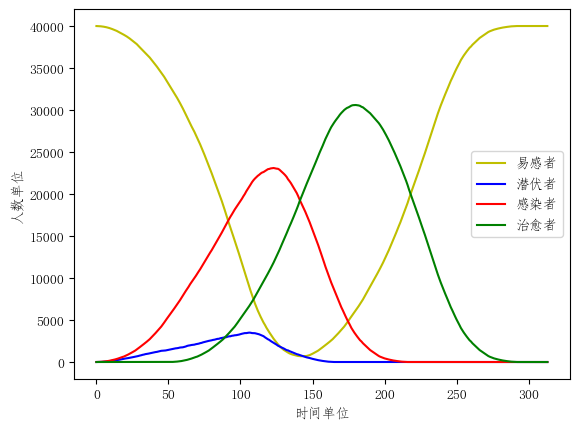

315


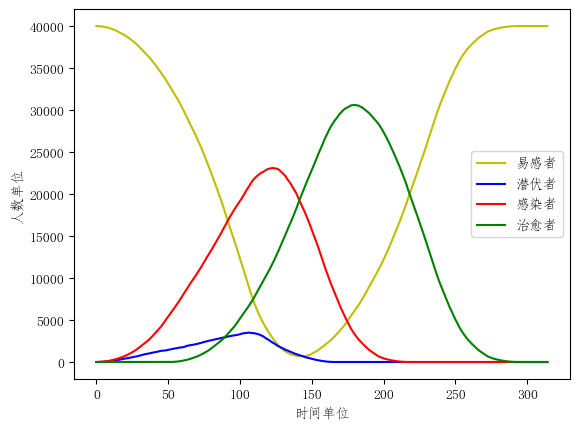

316


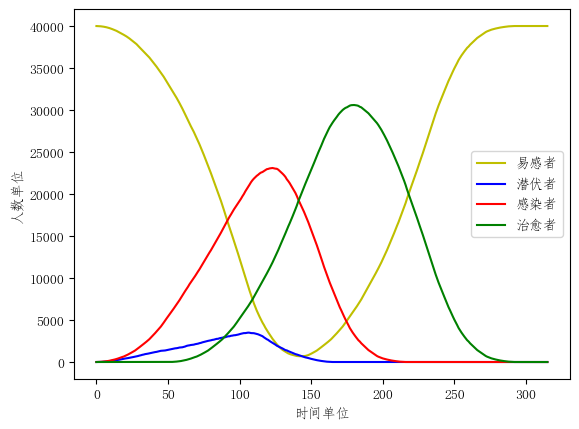

317


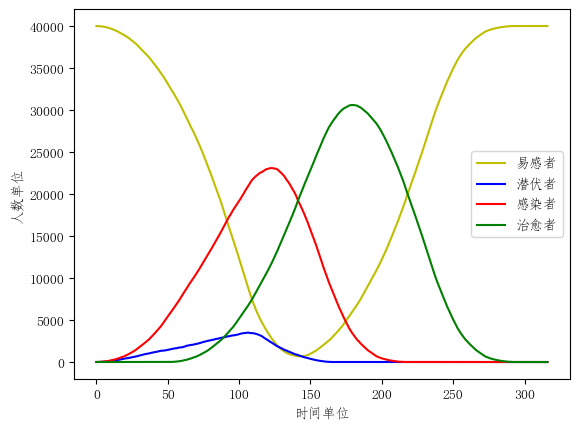

318


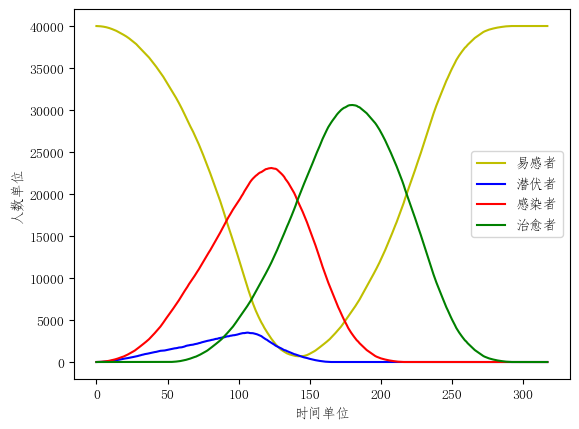

319


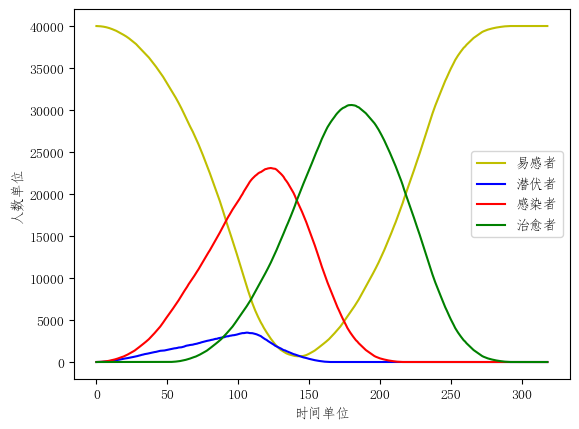

320


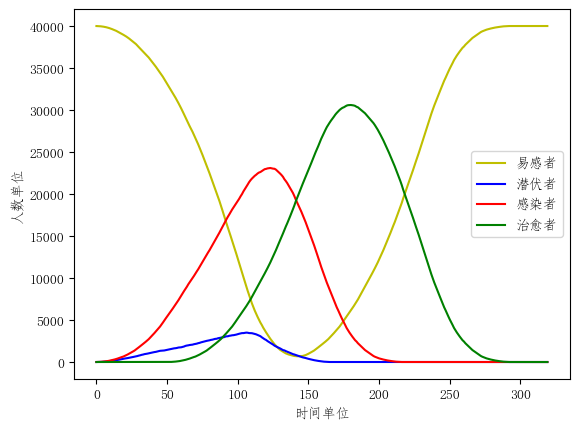

321


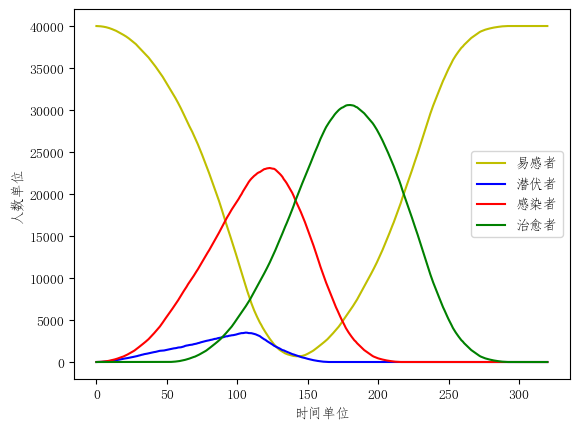

322


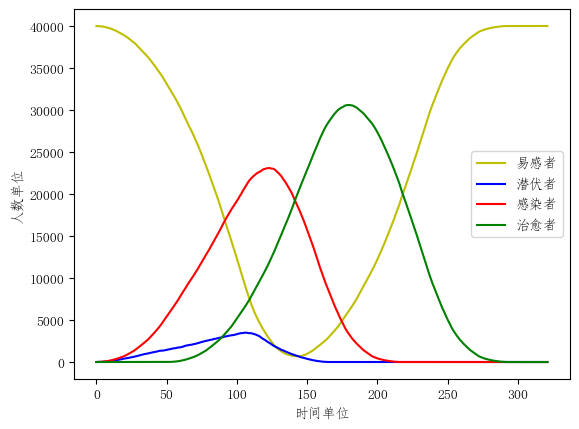

323


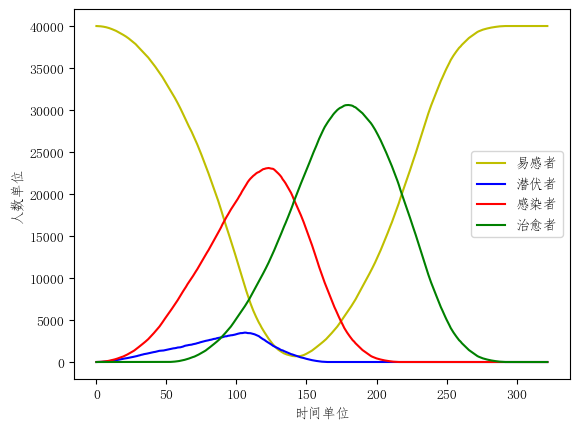

324


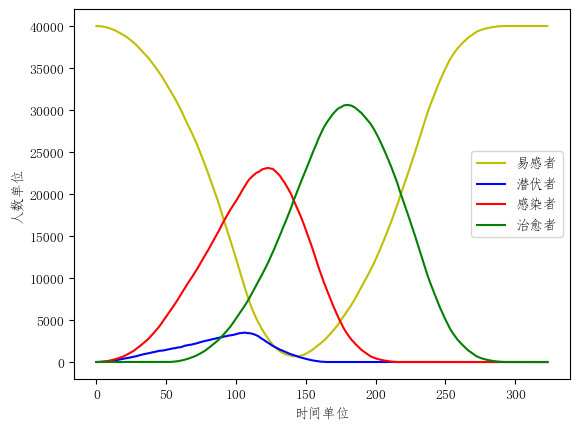

325


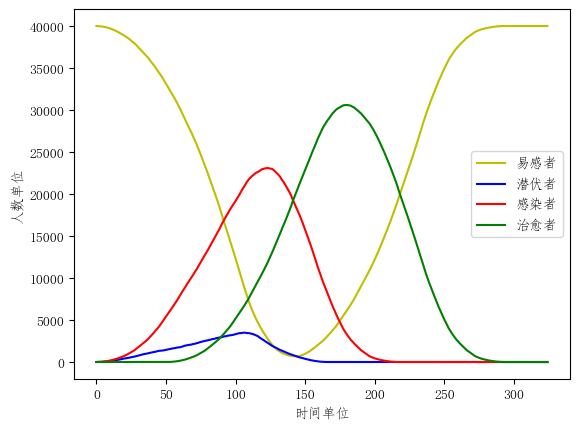

326


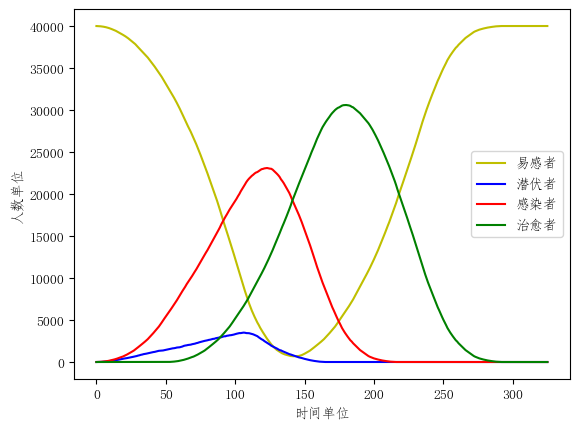

327


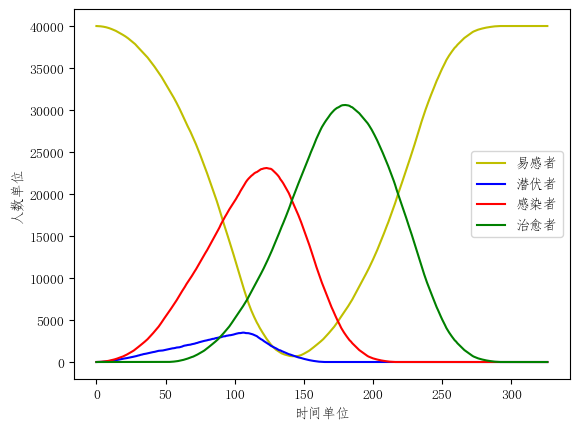

328


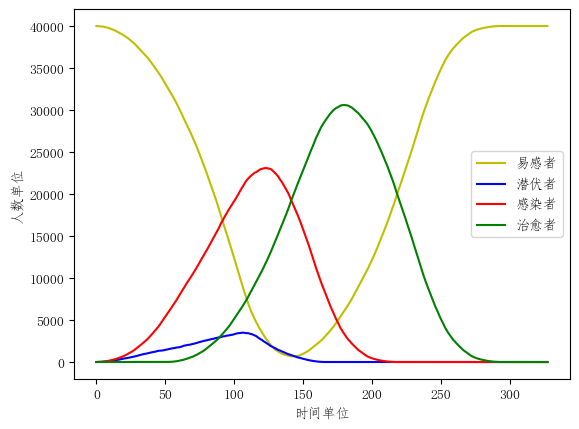

329


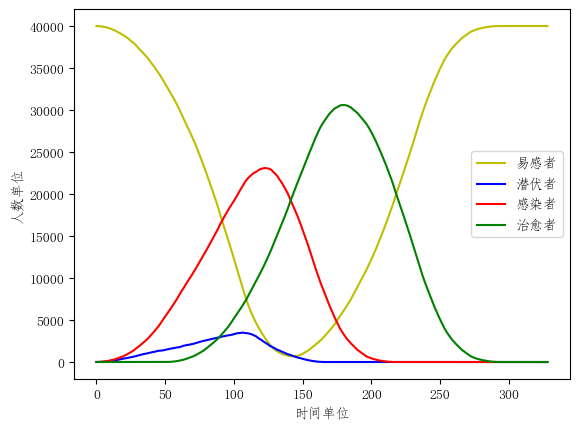

330


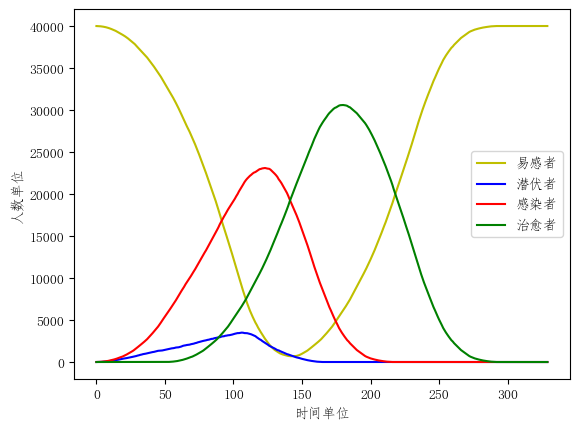

331


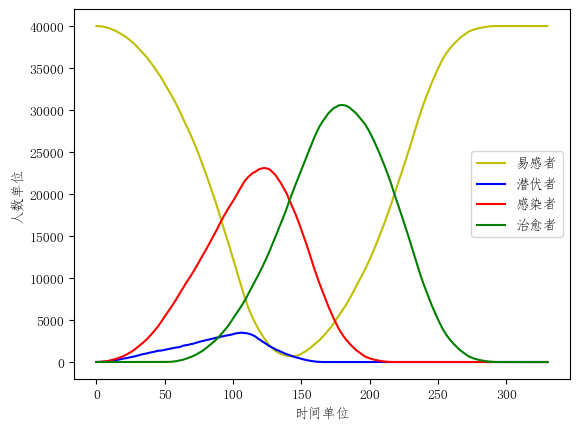

332


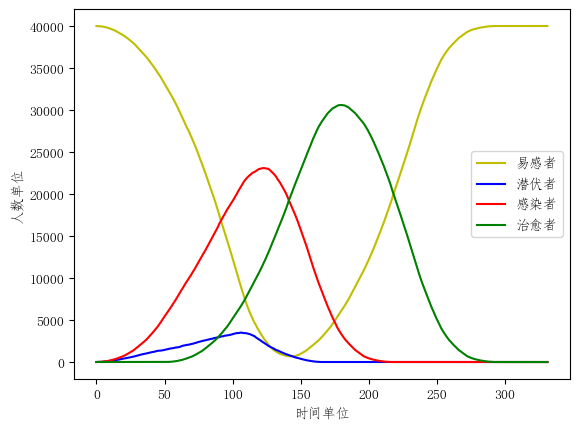

333


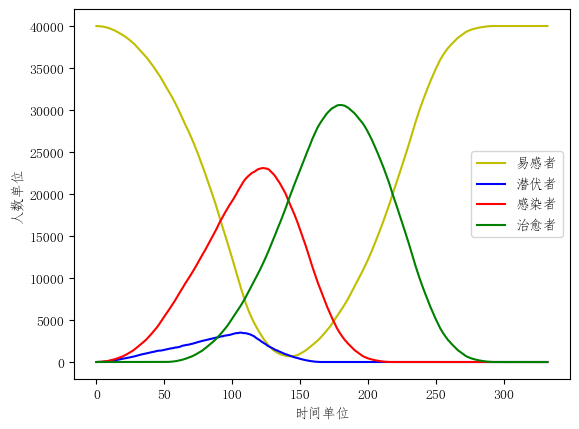

334


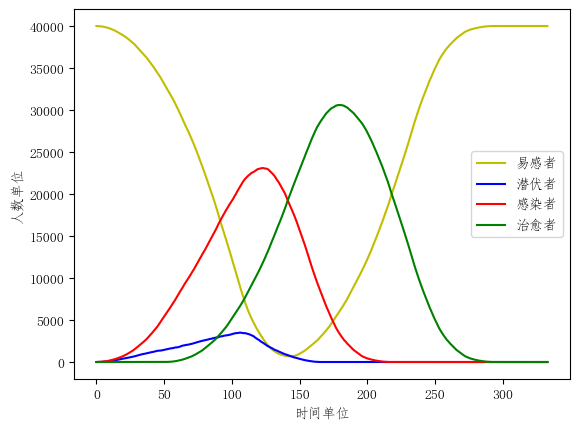

335


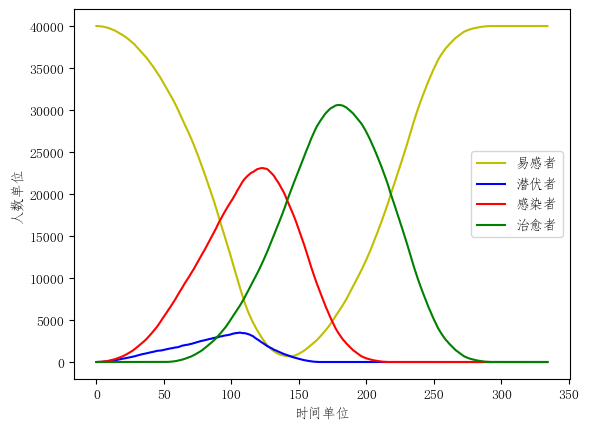

336


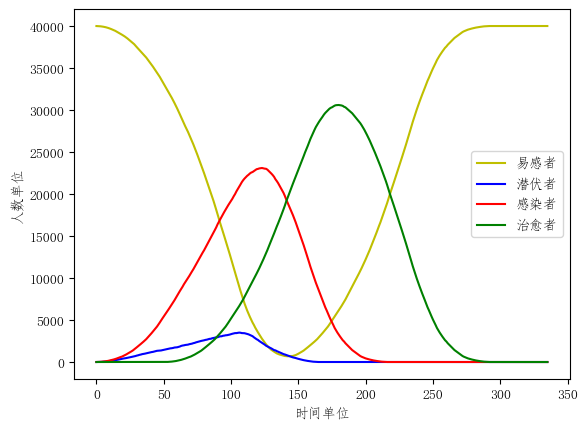

337


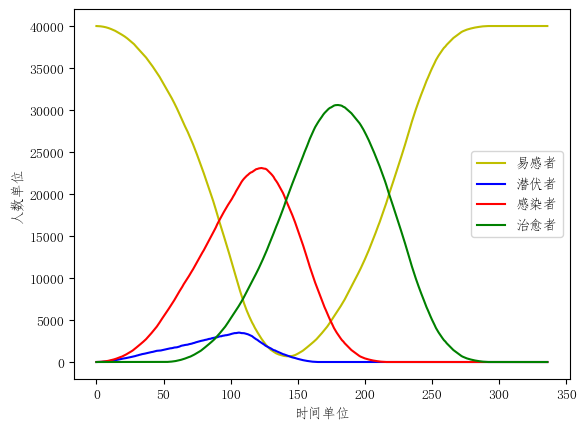

338


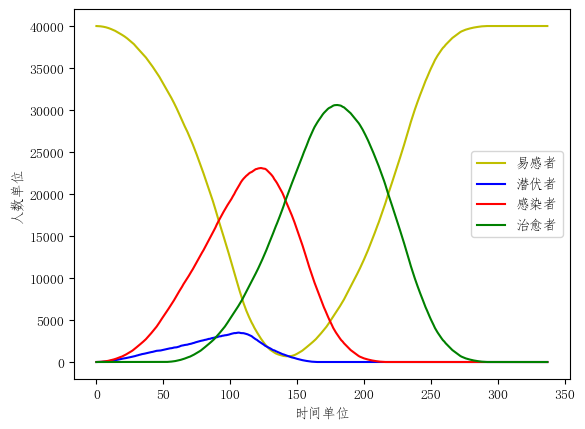

339


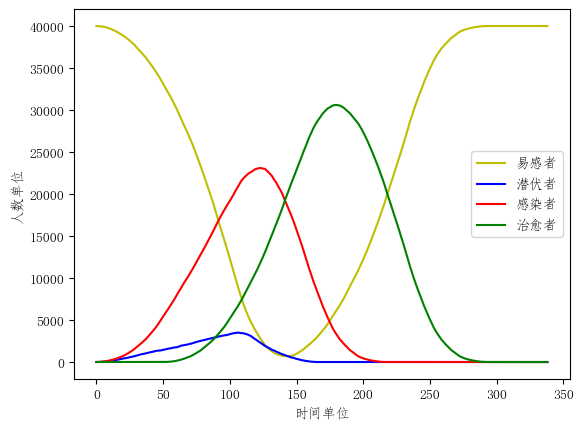

340


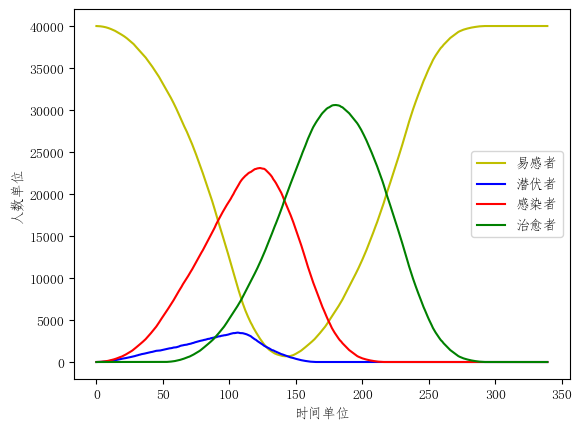

341


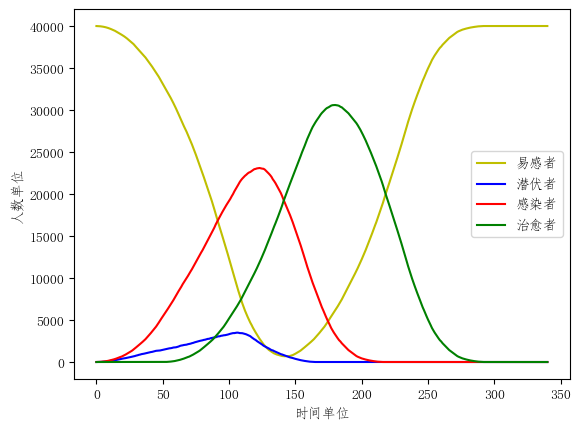

342


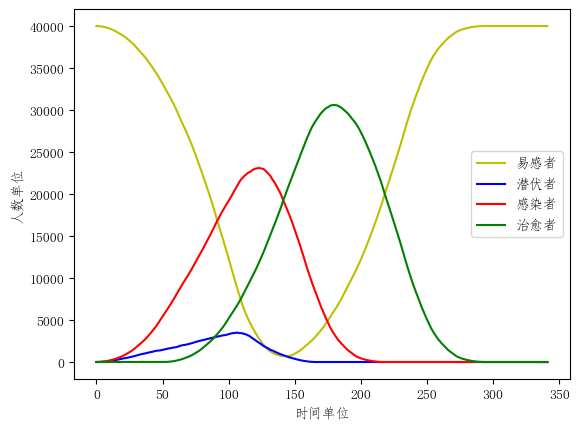

343


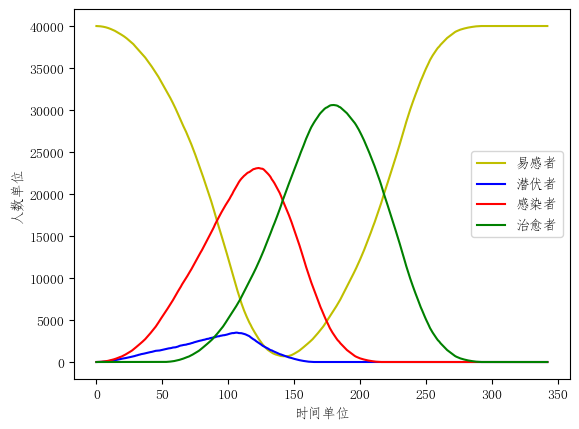

344


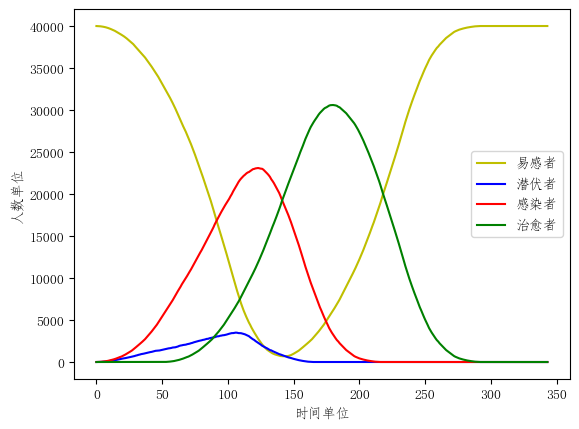

345


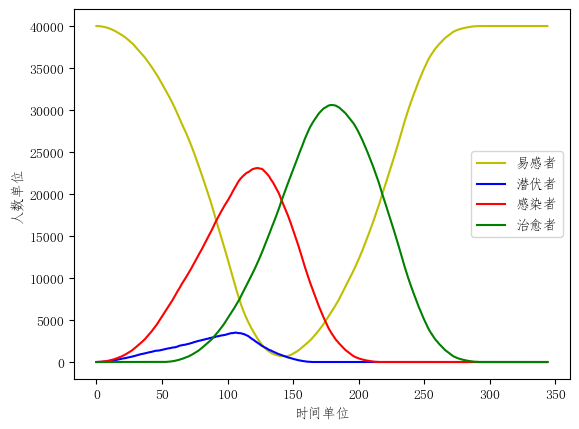

346


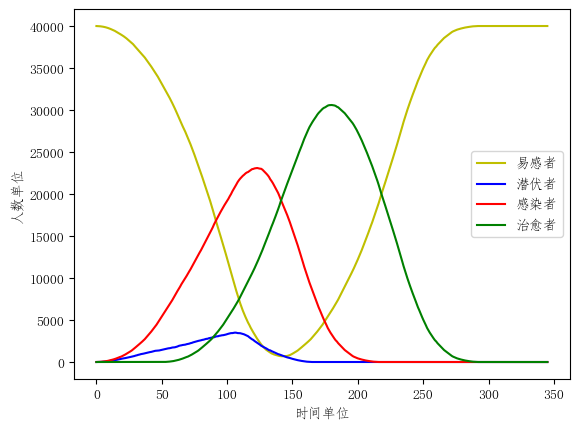

347


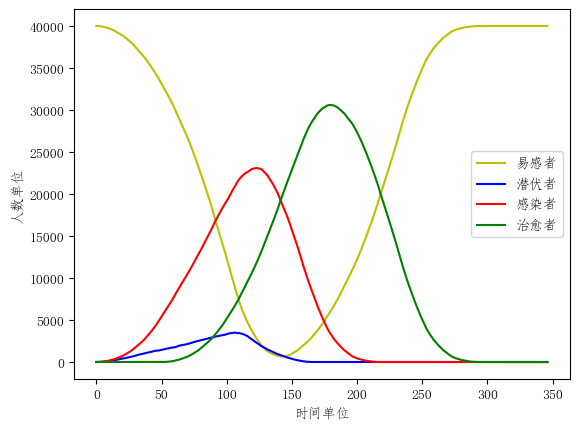

348


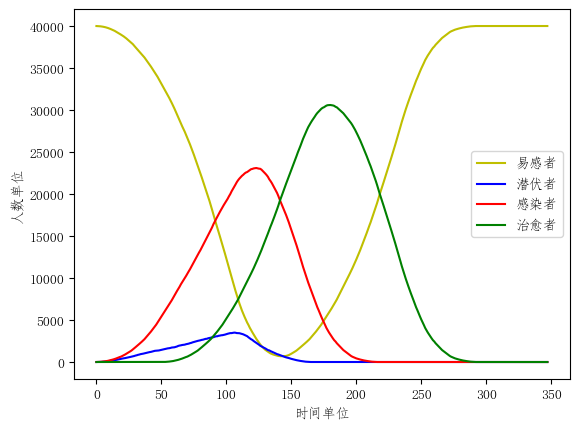

349


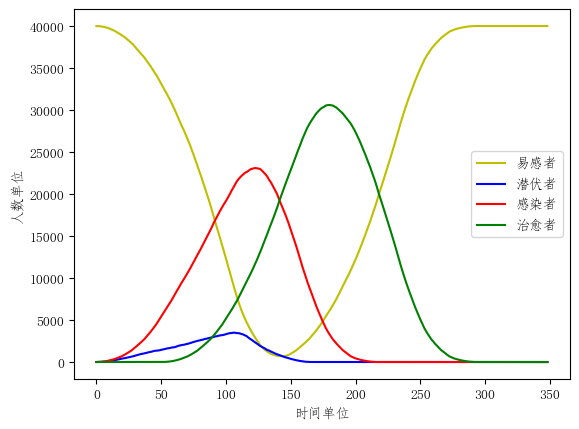

350


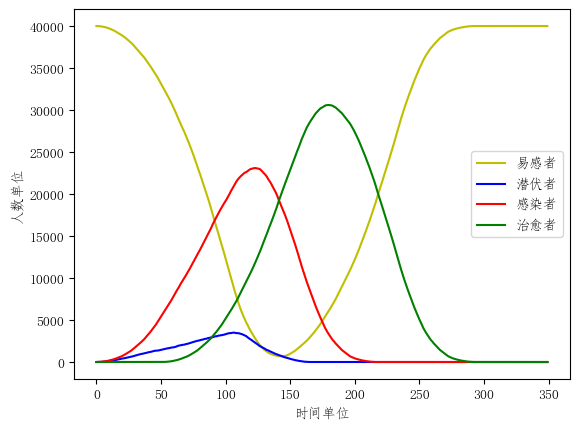

351


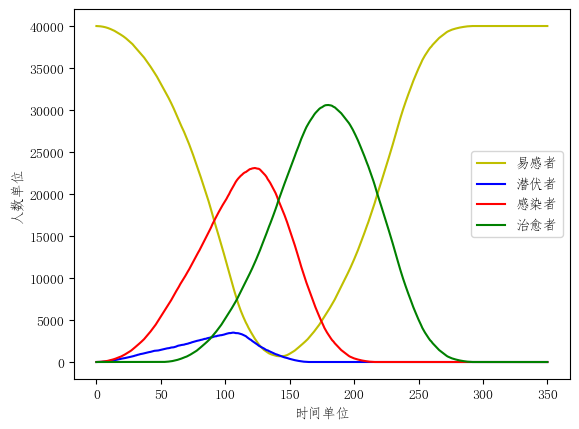

352


KeyboardInterrupt: 

<Figure size 640x480 with 0 Axes>

In [1]:
# 状态：
# S0表示易感者S
# S1表示感染者I
# S2表示治愈者R
# S3表示潜伏者E

# 规则：
# 1. 当S=S0时，为易感者，被感染率为p=k*(上下左右邻居的感染者)/4+l*(左上左下右上右下邻居的感染者)/4,概率c1变为潜伏者,概率1-c1变为感染者
# 2. 当S=S1时，为感染者，具有一定的感染能力，等待t_max时间，会自动变为S2治愈者，染病时间初始化为0
# 3. 当S=S2时，为治愈者，[具有一定的免疫能力，等待T_max时间，会自动变为S0易感者，免疫时间初始化为0],改为永久免疫
# 4. 当S=S3时,为潜伏者,等待t1_max时间(潜伏时间),会自动变为S1感染者,潜伏时间初始化为0,
from pylab import *
import random
import numpy as np
import pygame
import sys
import matplotlib.pyplot as plt
# 初始化相关数据
k=0.85  #上下左右概率
l=0.55  #其它概率
c1=0.4  #c1概率变为潜伏者
t1_max=15 #潜伏时间
t_max=50 #治愈时间
T_max=75 #免疫时间   
# p = np.array([0.6, 0.4])
# probability = np.random.choice([True, False],
# p=p.ravel())  # p(感染or潜伏)=(self.s1_0*k+self.s1_1*l) p(易感)=1-(self.s1_0*k+self.s1_1*l)
def probablity_fun():
    np.random.seed(0)
    # p = np.array([(self.s1_0*k+self.s1_1*l),1-(self.s1_0*k+self.s1_1*l)])
    p = np.array([0.6, 0.4])
    probability = np.random.choice([True, False],
                                   p=p.ravel())  # p(感染or潜伏)=(self.s1_0*k+self.s1_1*l) p(易感)=1-(self.s1_0*k+self.s1_1*l)
    return probability
RED = (255, 0, 0)
GREY = (127, 127, 127)
Green = (0, 255, 0)
BLACK = (0, 0, 0)
"""细胞类，单个细胞"""
class Cell:
    # 初始化
    stage = 0
    def __init__(self, ix, iy, stage):
        self.ix = ix
        self.iy = iy
        self.stage = stage            #状态，初始化默认为0，易感者
        # self.neighbour_count = 0    #周围细胞的数量
        self.s1_0 = 0                 #上下左右为感染者的数量
        self.s1_1 = 0                 #左上左下右上右下感染者的数量
        self.T_ = 0                  #免疫时间
        self.t_ = 0                  #患病时间
        self.t1_ = 0                 #潜伏时间
    # 计算周围有多少个感染者
    def calc_neighbour_count(self):
        count_0 = 0
        count_1 = 0
        pre_x = self.ix - 1 if self.ix > 0 else 0
        for i in range(pre_x, self.ix+1+1):
            pre_y = self.iy - 1 if self.iy > 0 else 0
            for j in range(pre_y, self.iy+1+1):
                if i == self.ix and j == self.iy:   # 判断是否为自身
                    continue
                if self.invalidate(i, j):           # 判断是否越界
                    continue
                if CellGrid.cells[i][j].stage == 1 or CellGrid.cells[i][j] == 3 :  #此时这个邻居是感染者
                    #如果是在上下左右
                    if (i==self.ix and j==self.iy-1) or \
                       (i==self.ix and j==self.iy+1) or \
                       (i==self.ix-1 and j==self.iy) or \
                       (i==self.ix+1 and j==self.iy):
                        count_0+=1
                    else:
                        count_1+=1
        # print(count_0)
        self.s1_0 = count_0
        # if self.s1_1!=0:
        #     print(count_1,count_0,self.ix,self.iy)
        self.s1_1 = count_1
    # 判断是否越界
    def invalidate(self, x, y):
        if x >= CellGrid.cx or y >= CellGrid.cy:
            return True
        if x < 0 or y < 0:
            return True
        return False
    # 定义规则
    def next_iter(self):
        # 规则1，易感者
        if self.stage==0:
            probability=random.random()#生成0到1的随机数
            s1_01 = self.s1_0 * k + self.s1_1 * l
            if (s1_01>probability) and (s1_01!=0):
                p1 = random.random()
                if p1>c1:
                    self.stage=1
                else:
                    self.stage=3
            else:
                self.stage = 0
        # 规则2，感染者
        elif self.stage == 1:
            if self.t_ >= t_max:
                self.stage = 2
            else:
                self.t_ = self.t_ + 1
        # 规则3，治愈者(永久免疫规则)
        elif self.stage == 2:
            if self.T_ >= T_max:
                self.stage = 0
            else:
                self.T_ = self.T_ + 1
        # 规则4,潜伏者
        elif self.stage == 3:
            if self.t1_ >= t1_max:
                self.stage = 1  # 转变为感染者
            else:
                self.t1_ += 1
"""细胞网格类，处在一个长cx,宽cy的网格中"""
class CellGrid:
    cells = []
    cx = 0
    cy = 0
    # 初始化
    def __init__(self, cx, cy):
        CellGrid.cx = cx
        CellGrid.cy = cy
        for i in range(cx):
            cell_list = []
            for j in range(cy):
                cell = Cell(i, j, 0)            #首先默认为全是易感者
                if (i == cx/2 and j ==cy/2) or (i==cx/2+1 and j==cy/2) or (i==cx/2+1 and j==cy/2+1):#看26行就可以了
                    cell_list.append(Cell(i,j,1))
                else:
                    cell_list.append(cell)
            CellGrid.cells.append(cell_list)
    def next_iter(self):
        for cell_list in CellGrid.cells:
            for item in cell_list:
                item.next_iter()
    def calc_neighbour_count(self):
        for cell_list in CellGrid.cells:
            for item in cell_list:
                item.calc_neighbour_count()
    def num_of_nonstage(self):
        # global count0_,count1_,count2_
        count0 = 0
        count1 = 0
        count2 = 0
        count3 = 0
        for i in range(self.cx):
            for j in range(self.cy):
                # 计算全部的方格数
                cell = self.cells[i][j].stage
                if cell == 0:
                    count0 += 1
                elif cell == 1:
                    count1 += 1
                elif cell == 2:
                    count2 += 1
                elif cell == 3:
                    count3 += 1
        return count0, count1, count2, count3
'''界面类'''
class Game:
    screen = None
    count0 = 0
    count1 = 9
    count2 = 0
    count3 = 0
    def __init__(self, width, height, cx, cy):#屏幕宽高，细胞生活区域空间大小
        self.width = width
        self.height = height
        self.cx_rate = int(width / cx)
        self.cy_rate = int(height / cy)
        self.screen = pygame.display.set_mode([width, height])#
        self.cells = CellGrid(cx, cy)
    def show_life(self):
        for cell_list in self.cells.cells:
            for item in cell_list:
                x = item.ix
                y = item.iy
                if item.stage == 0:
                    pygame.draw.rect(self.screen, GREY,
                                     [x * self.cx_rate, y * self.cy_rate, self.cx_rate, self.cy_rate])
                elif item.stage == 2:
                    pygame.draw.rect(self.screen, Green,
                                     [x * self.cx_rate, y * self.cy_rate, self.cx_rate, self.cy_rate])
                elif item.stage == 1:
                    pygame.draw.rect(self.screen, RED,
                                     [x * self.cx_rate, y * self.cy_rate, self.cx_rate, self.cy_rate])
                elif item.stage == 3:
                    pygame.draw.rect(self.screen, BLACK,
                                     [x * self.cx_rate, y * self.cy_rate, self.cx_rate, self.cy_rate])
    # def count_num(self):
    #     self.count0, self.count1, self.count2,self.count3 = self.cells.num_of_nonstage()
mpl.rcParams['font.sans-serif'] = ['FangSong'] # 指定默认字体
mpl.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题
if __name__ == '__main__':
    count0_ = []
    count1_ = []
    count2_ = []
    count3_ = []
    pygame.init()
    pygame.display.set_caption("传染病模型")
    game = Game(800, 800, 200, 200)
    clock = pygame.time.Clock()
    k1 = 0
    while True:
        k1 += 1
        print(k1)
        # game.screen.fill(GREY)#底部全置灰
        clock.tick(100)  # 每秒循环10次
        for event in pygame.event.get():
            if event.type == pygame.QUIT:
                sys.exit()
        game.cells.calc_neighbour_count()
        count0, count1, count2,count3 = game.cells.num_of_nonstage()
        # count0,count1,count2 = game.count_num()
        count0_.append(count0)
        count1_.append(count1)
        count2_.append(count2)
        count3_.append(count3)
        if count2 > 200*190:  # 退出条件
            break
        plt.plot(count0_, color='y', label='易感者')
        plt.plot(count3_, color='b', label='潜伏者')
        plt.plot(count1_, color='r', label='感染者')
        plt.plot(count2_, color='g', label='治愈者')
        # plt.ylim([0,80000])
        plt.legend()
        plt.xlabel('时间单位')
        plt.ylabel('人数单位')
        plt.pause(0.1)#0.1秒停一次
        plt.clf()#清除
        # plt.close()#退出
        game.show_life()
        pygame.display.flip()
        game.cells.next_iter()
    plt.show() #显示

最小值点x= -0.9999999616185459 最小值y 4.000000000000002 迭代次数n= 139


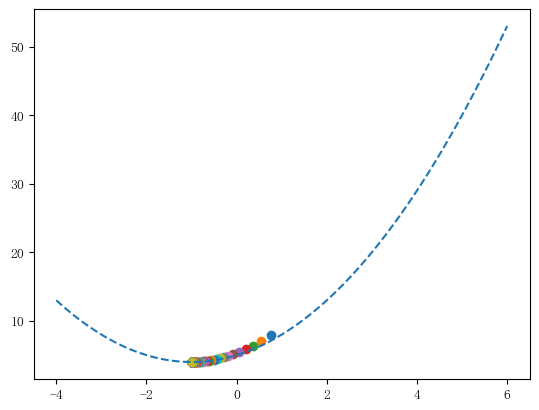

In [2]:
import numpy as np
import matplotlib.pyplot as plt
x=np.linspace(-6,4,100)
y=x**2+2*x+5

x_iter=1#设置x的初始值
yita=0.06#步长
count=0#记录迭代次数
while True:
    count+=1
    y_last=x_iter**2+2*x_iter+5
    x_iter=x_iter-yita*(2*x_iter+2)
    y_next=x_iter**2+2*x_iter+5
    plt.scatter(x_iter,y_last)
    if abs(y_next-y_last)<1e-100:
        break
print('最小值点x=',x_iter,'最小值y',y_next,'迭代次数n=',count)
x=np.linspace(-4,6,100)
y=x**2+2*x+5
plt.plot(x,y,'--')
plt.show()

In [3]:
import numpy as np
def f(x):
    y=x**3-x-1#求根方程的表达式
    return y
def g(x):
    y=3*x**2-1#求根方程的导函数
    return y
def main():
    x_0=1.5 #取初值
    e=10**(-9) #误差要求
    L=0 #初始化迭代次数
    while L<100: #采用残差来判断
        x1=x_0-f(x_0)/g(x_0) #迭代公式,x(n+1)=x(n)-f(x(n))/f'(x(n))
        x_0=x1
        L=L+1 #统计迭代次数
        if abs(f(x_0)-0)<e:
            break
    print(f"x1={x1}") #输出数值解
    print(f(x_0)-0)  # 验证解的正确性
    print(f"L={L}") #输出迭代次数
if __name__ == '__main__':
   main()

x1=1.3247179572447898
1.865174681370263e-13
L=4


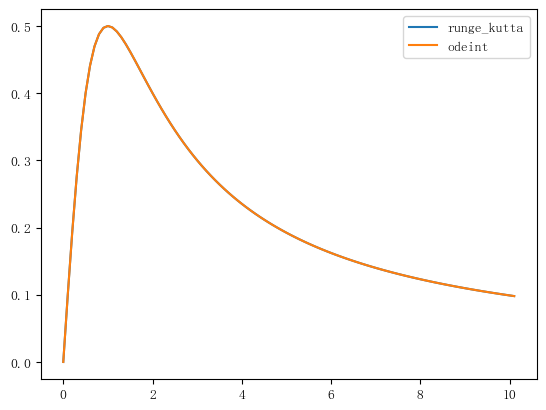

In [5]:
import math
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint 

def runge_kutta(y, x, dx, f):
    """ y is the initial value for y
        x is the initial value for x
        dx is the time step in x
        f is derivative of function y(t)
    """
    k1 = dx * f(y, x)
    k2 = dx * f(y + 0.5 * k1, x + 0.5 * dx)
    k3 = dx * f(y + 0.5 * k2, x + 0.5 * dx)
    k4 = dx * f(y + k3, x + dx)
    return y + (k1 + 2 * k2 + 2 * k3 + k4) / 6.
t = 0.
y = 0.
dt = .1
ys, ts = [0], [0]
def func(y, t):
    return  1/(1+t**2)-2*y**2
while t <= 10:
    y = runge_kutta(y, t, dt, func)
    t += dt
    ys.append(y)
    ts.append(t)
YS=odeint(func,y0=0, t=np.arange(0,10.2,0.1))
plt.plot(ts, ys, label='runge_kutta')
plt.plot(ts, YS, label='odeint')
plt.legend()
plt.show()

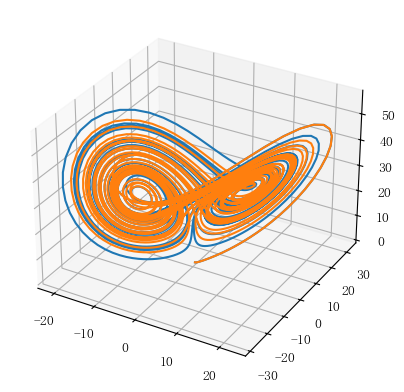

In [6]:
import numpy as np
def move(P, steps, sets):
    x, y, z = P
    sgima, rho, beta = sets
    # 各方向的速度近似
    dx = sgima * (y - x)
    dy = x * (rho - z)
    dz = x * y - beta * z
    return [x + dx * steps, y + dy * steps, z + dz * steps]

# 设置sets参数
sets = [10., 28., 3.]
t = np.arange(0, 30, 0.01)
# 位置1：
P0 = [0., 1., 0.]
P = P0
d = []
for v in t:
    P = move(P, 0.01, sets)
    d.append(P)
dnp = np.array(d)
# 位置2：
P02 = [0., 1.01, 0.]
P = P02
d = []
for v in t:
    P = move(P, 0.01, sets)
    d.append(P)
dnp2 = np.array(d)
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot(dnp[:, 0], dnp[:, 1], dnp[:, 2])
ax.plot(dnp2[:, 0], dnp2[:, 1], dnp2[:, 2])
plt.show()

In [8]:
import numpy as np
import pandas as pd
import datetime
start_time = datetime.datetime.now()
np.set_printoptions(suppress=True)
def left_boundary(t):  # 左边值
    return np.exp(t)
def right_boundary(t):  # 右边值
    return np.exp(t + 1)
def initial_T(x_max, t_max, delta_x, delta_t, m, n):  # 给温度T初始化
    T = np.zeros((n + 1, m + 1))
    for i in range(m + 1):  # 初值
        T[0, i] = np.exp(i * delta_x)
 
    for i in range(1, n + 1):  # 注意不包括T[0,0]与T[0,-1]
        T[i, 0] = left_boundary(i * delta_t)  # 左边值
        T[i, -1] = right_boundary(i * delta_t)  # 右边值
    return T


# 一、古典显格式
def one_dimensional_heat_conduction1(T, m, n, r):
    # 可以发现当r>=0.5时就发散了
    for k in range(1, n + 1):  # 时间层
        for i in range(1, m):  # 空间层
            T[k, i] = (1 - 2 * r) * T[k - 1, i] + r * (T[k - 1, i - 1] + T[k - 1, i + 1])
    return T.round(6)


# 二、古典隐格式（乘逆矩阵法）
def one_dimensional_heat_conduction2(T, m, n, r):
    A = np.eye(m - 1, k=0) * (1 + 2 * r) + np.eye(m - 1, k=1) * (-r) + np.eye(m - 1, k=-1) * (-r)
    a = np.ones(m - 1) * (-r)
    a[0] = 0
    b = np.ones(m - 1) * (1 + 2 * r)
    c = np.ones(m - 1) * (-r)
    c[-1] = 0
 
    F = np.zeros(m - 1)  # m-1个元素，索引0~(m-2)
    for k in range(1, n + 1):  # 时间层range(1, n + 1)
        F[0] = T[k - 1, 1] + r * T[k, 0]
        F[-1] = T[k - 1, m - 1] + r * T[k, m]
        for i in range(1, m - 2):  # 空间层
            F[i] = T[k - 1, i + 1]  # 给F赋值
        for i in range(1, m - 1):
            T[k, 1:-1] = np.linalg.inv(A) @ F  # 左乘A逆
    return T.round(6)


# 三、古典隐格式（追赶法）
def one_dimensional_heat_conduction3(T, m, n, r):
    a = np.ones(m - 1) * (-r)
    a[0] = 0
    b = np.ones(m - 1) * (1 + 2 * r)
    c = np.ones(m - 1) * (-r)
    c[-1] = 0
 
    F = np.zeros(m - 1)  # m-1个元素，索引0~(m-2)
    for k in range(1, n + 1):  # 时间层range(1, n + 1)
        F[0] = T[k - 1, 1] + r * T[k, 0]
        F[-1] = T[k - 1, m - 1] + r * T[k, m]
        y = np.zeros(m - 1)
        beta = np.zeros(m - 1)
        x = np.zeros(m - 1)
        y[0] = F[0] / b[0]
        d = b[0]
        for i in range(1, m - 2):  # 空间层
            F[i] = T[k - 1, i + 1]  # 给F赋值
        for i in range(1, m - 1):
            beta[i - 1] = c[i - 1] / d
            d = b[i] - a[i] * beta[i - 1]
            y[i] = (F[i] - a[i] * y[i - 1]) / d
        x[-1] = y[-1]
        for i in range(m - 3, -1, -1):
            x[i] = y[i] - beta[i] * x[i + 1]
        T[k, 1:-1] = x
    return T.round(6)


# 四、Crank-Nicolson（乘逆矩阵法）
def one_dimensional_heat_conduction4(T, m, n, r):
    A = np.eye(m - 1, k=0) * (1 + r) + np.eye(m - 1, k=1) * (-r * 0.5) + np.eye(m - 1, k=-1) * (-r * 0.5)
    C = np.eye(m - 1, k=0) * (1 - r) + np.eye(m - 1, k=1) * (0.5 * r) + np.eye(m - 1, k=-1) * (0.5 * r)
 
    for k in range(0, n):  # 时间层
        F = np.zeros(m - 1)  # m-1个元素，索引0~(m-2)
        F[0] = r / 2 * (T[k, 0] + T[k + 1, 0])
        F[-1] = r / 2 * (T[k, m] + T[k + 1, m])
        F = C @ T[k, 1:m] + F
        T[k + 1, 1:-1] = np.linalg.inv(A) @ F
    return T.round(6)



# 五、Crank-Nicolson（追赶法）
def one_dimensional_heat_conduction5(T, m, n, r):
    C = np.eye(m - 1, k=0) * (1 - r) + np.eye(m - 1, k=1) * (0.5 * r) + np.eye(m - 1, k=-1) * (0.5 * r)
    a = np.ones(m - 1) * (-0.5 * r)
    a[0] = 0
    b = np.ones(m - 1) * (1 + r)
    c = np.ones(m - 1) * (-0.5 * r)
    c[-1] = 0
 
    for k in range(0, n):  # 时间层
        F = np.zeros(m - 1)  # m-1个元素，索引0~(m-2)
        F[0] = r * 0.5 * (T[k, 0] + T[k + 1, 0])
        F[-1] = r * 0.5 * (T[k, m] + T[k + 1, m])
        F = C @ T[k, 1:m] + F
        y = np.zeros(m - 1)
        beta = np.zeros(m - 1)
        x = np.zeros(m - 1)
        y[0] = F[0] / b[0]
        d = b[0]
        for i in range(1, m - 1):
            beta[i - 1] = c[i - 1] / d
            d = b[i] - a[i] * beta[i - 1]
            y[i] = (F[i] - a[i] * y[i - 1]) / d
        x[-1] = y[-1]
        for i in range(m - 3, -1, -1):
            x[i] = y[i] - beta[i] * x[i + 1]
        T[k + 1, 1:-1] = x
    return T.round(6)


def exact_solution(T, m, n, r, delta_x, delta_t):  # 偏微分方程精确解
    for i in range(n + 1):
        for j in range(m + 1):
            T[i, j] = np.exp(i * delta_t + j * delta_x)
    return T.round(6)
a = 1  # 热传导系数
x_max = 1
t_max = 1
delta_x = 0.1  # 空间步长
delta_t = 0.1  # 时间步长
m = int((x_max / delta_x).__round__(4))  # 长度等分成m份
n = int((t_max / delta_t).__round__(4))  # 时间等分成n份
t_grid = np.arange(0, t_max + delta_t, delta_t)  # 时间网格
x_grid = np.arange(0, x_max + delta_x, delta_x)  # 位置网格
r = (a * delta_t / (delta_x ** 2)).__round__(6)  # 网格比
T = initial_T(x_max, t_max, delta_x, delta_t, m, n)
print('长度等分成{}份'.format(m))
print('时间等分成{}份'.format(n))
print('网格比=', r)
 
p = pd.ExcelWriter('有限差分法-一维热传导-题目1.xlsx')
 
T1 = one_dimensional_heat_conduction1(T, m, n, r)
T1 = pd.DataFrame(T1, columns=x_grid, index=t_grid)  # colums是列号，index是行号
T1.to_excel(p, '古典显格式')
 
T2 = one_dimensional_heat_conduction2(T, m, n, r)
T2 = pd.DataFrame(T2, columns=x_grid, index=t_grid)  # colums是列号，index是行号
T2.to_excel(p, '古典隐格式（乘逆矩阵法）')
 
T3 = one_dimensional_heat_conduction3(T, m, n, r)
T3 = pd.DataFrame(T3, columns=x_grid, index=t_grid)  # colums是列号，index是行号
T3.to_excel(p, '古典隐格式（追赶法）')
 
T4 = one_dimensional_heat_conduction4(T, m, n, r)
T4 = pd.DataFrame(T4, columns=x_grid, index=t_grid)  # colums是列号，index是行号
T4.to_excel(p, 'Crank-Nicolson格式（乘逆矩阵法）')
 
T5 = one_dimensional_heat_conduction5(T, m, n, r)
T5 = pd.DataFrame(T5, columns=x_grid, index=t_grid)  # colums是列号，index是行号
T5.to_excel(p, 'Crank-Nicolson格式（追赶法）')
 
T6 = exact_solution(T, m, n, r, delta_x, delta_t)
T6 = pd.DataFrame(T6, columns=x_grid, index=t_grid)  # colums是列号，index是行号
T6.to_excel(p, '偏微分方程精确解')
 
p.save()
 
end_time = datetime.datetime.now()
print('运行时间为', (end_time - start_time))

长度等分成10份
时间等分成10份
网格比= 10.0


C:\Users\21664\AppData\Local\Temp\ipykernel_71844\1360033805.py:149: FutureWarning: Starting with pandas version 3.0 all arguments of to_excel except for the argument 'excel_writer' will be keyword-only.
  T1.to_excel(p, '古典显格式')
C:\Users\21664\AppData\Local\Temp\ipykernel_71844\1360033805.py:153: FutureWarning: Starting with pandas version 3.0 all arguments of to_excel except for the argument 'excel_writer' will be keyword-only.
  T2.to_excel(p, '古典隐格式（乘逆矩阵法）')
C:\Users\21664\AppData\Local\Temp\ipykernel_71844\1360033805.py:157: FutureWarning: Starting with pandas version 3.0 all arguments of to_excel except for the argument 'excel_writer' will be keyword-only.
  T3.to_excel(p, '古典隐格式（追赶法）')
C:\Users\21664\AppData\Local\Temp\ipykernel_71844\1360033805.py:161: FutureWarning: Starting with pandas version 3.0 all arguments of to_excel except for the argument 'excel_writer' will be keyword-only.
  T4.to_excel(p, 'Crank-Nicolson格式（乘逆矩阵法）')
C:\Users\21664\AppData\Local\Temp\ipykernel_71844\

AttributeError: 'OpenpyxlWriter' object has no attribute 'save'